<a href="https://colab.research.google.com/github/ksBrose/3DSGroup_BootcampDataScience/blob/main/Atividade_rev_k_modkelvin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Projeto Data Science - Grupo 3DS

Foram baixados primeiramente os arquivos de dados telemétricos das cidades de Encantado, Muçum e Santa Tereza, no período de 01/08/2023 a 31/10/2023.
Para o município de Santa Tereza, foram baixados dados de 2 estações: Santa Tereza e Linha José Julio.

Após a primeira reunião com os instrutores, alteramos a coleta de dados para um período de 2 anos.

**Sites Referencia**
- https://www.snirh.gov.br/hidroweb/mapa
- https://www.snirh.gov.br/hidrotelemetria/serieHistorica.aspx

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
from datetime import datetime

# Funçoes

In [3]:
def plotar_matplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')
  eixo.plot(x, y, data=dataset2, label=label2, linestyle='-')
  eixo.plot(x, y, data=dataset3, label=label3, linestyle='-')
  eixo.plot(x, y, data=dataset4, label=label4, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

In [4]:
def plotar_1_intervalo(titulo, labelx, labely, x, y, dataset1, label1, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

In [5]:
def plotar_boxplot(titulo, labelx, labely, x, y, dataset, tipo='linha'):
    # Verificar se o dataset não está vazio
    if dataset.empty:
        print("O dataset está vazio.")
        return

    # Verificar se as colunas especificadas existem no dataset
    if x not in dataset.columns or y not in dataset.columns:
        print(f"As colunas '{x}' e '{y}' devem existir no dataset.")
        return

    fig = plt.figure(figsize=(15, 8))
    eixo = fig.add_axes([0, 0, 1, 1])

    if tipo == 'linha':
        eixo.plot(dataset[x], dataset[y], marker='o', linestyle='-')  # Gráfico de linha com pontos
    elif tipo == 'boxplot':
        # Remover nulos apenas da coluna y
        dataset_cleaned = dataset.dropna(subset=[y])
        eixo.boxplot(dataset_cleaned[y], vert=True)
        eixo.set_xticklabels([labelx])  # Rótulo do eixo x

    # Configurar título e rótulos dos eixos
    eixo.set_title(titulo, fontsize=25, pad=15)
    eixo.set_xlabel(labelx, fontsize=15)
    eixo.set_ylabel(labely, fontsize=15)

    plt.show()

In [6]:
def plotar_boxplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):
  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Criar uma lista com os dados para o boxplot, ignorando dados nulos
  dados_boxplot = [
      dataset1[y].dropna().values,
      dataset2[y].dropna().values,
      dataset3[y].dropna().values,
      dataset4[y].dropna().values
  ]

  # Plotar o boxplot
  eixo.boxplot(dados_boxplot, labels=[label1, label2, label3, label4])

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo


In [7]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dataset[coluna_data], dataset[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()



In [8]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_ambos(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar por frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum', coluna_nivel: 'mean'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dados_agrupados[coluna_data], dados_agrupados[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_agrupados[coluna_data], dados_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

In [9]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_chuva(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()


# Base de dados de 3 meses

In [10]:
df_Encantado = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86720000-ENCANTADO.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86510000-MUCUM.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86472600-SANTA%20TEREZA.csv', encoding='ISO-8859-1', delimiter=';')
df_Lin_JJ = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/86472000-LINHA%20JOSE%20JULIO.csv', encoding='ISO-8859-1', delimiter=';')

In [11]:
df_Encantado['Data_Hora'] = pd.to_datetime(df_Encantado['Data'] + ' ' + df_Encantado['Hora'], format='%d/%m/%Y %H:%M:%S')
df_Encantado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6071 entries, 0 to 6070
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Data          6071 non-null   object        
 1   Hora          6071 non-null   object        
 2   Chuva (mm)    6071 non-null   object        
 3   Nível (cm)    6071 non-null   object        
 4   Vazão (m3/s)  3709 non-null   object        
 5   Unnamed: 5    0 non-null      float64       
 6   Data_Hora     6071 non-null   datetime64[ns]
dtypes: datetime64[ns](1), float64(1), object(5)
memory usage: 332.1+ KB


In [12]:
df_Encantado.head()

,Data,Hora,Chuva (mm),Nível (cm),Vazão (m3/s),Unnamed: 5,Data_Hora
0,01/08/2023,02:30:00,0,228,251.8,NaN,2023-08-01 02:30:00
1,01/08/2023,02:45:00,0,228,251.8,NaN,2023-08-01 02:45:00
2,01/08/2023,03:00:00,0,228,251.8,NaN,2023-08-01 03:00:00
3,01/08/2023,03:15:00,0,227,248.1,NaN,2023-08-01 03:15:00
4,01/08/2023,03:30:00,0,227,248.1,NaN,2023-08-01 03:30:00


In [13]:
df_Encantado.tail()

,Data,Hora,Chuva (mm),Nível (cm),Vazão (m3/s),Unnamed: 5,Data_Hora
6066,30/10/2023,23:00:00,0,197,146.1,NaN,2023-10-30 23:00:00
6067,30/10/2023,23:15:00,0,197,146.1,NaN,2023-10-30 23:15:00
6068,30/10/2023,23:30:00,0,197,146.1,NaN,2023-10-30 23:30:00
6069,30/10/2023,23:45:00,0,197,146.1,NaN,2023-10-30 23:45:00
6070,31/10/2023,00:00:00,0,197,146.1,NaN,2023-10-31 00:00:00


In [14]:
'''
#fig = plt.figure(figsize=(15,8))
eixo = fig.add_axes([0,0,1,1])

#eixo.scatter(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'])
eixo.plot(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'], marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
eixo.set_title('Encantado Nivel', fontsize=25, pad=15)
eixo.set_xlabel('Data', fontsize=15)
eixo.set_ylabel('Nivel', fontsize=15)
'''

"\n#fig = plt.figure(figsize=(15,8))\neixo = fig.add_axes([0,0,1,1])\n\n#eixo.scatter(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'])\neixo.plot(df_Encantado['Data_Hora'], df_Encantado['Nível (cm)'], marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações\neixo.set_title('Encantado Nivel', fontsize=25, pad=15)\neixo.set_xlabel('Data', fontsize=15)\neixo.set_ylabel('Nivel', fontsize=15)\n"

# Base de dados de 1 ano

## Carregando base de dados

In [15]:
df_Encantado24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86720000-ENCANTADO-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Encantado23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86720000-ENCANTADO-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86510000-MUCUM-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Mucum23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86510000-MUCUM-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472600-SANTA-TEREZA-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Sta_Tereza23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472600-SANTA-TEREZA-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Jose_Julio24 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472000-LINHA-JOSE-JULIO-2024-2023.csv', encoding='ISO-8859-1', delimiter=';')
df_Jose_Julio23 = pd.read_csv('https://raw.githubusercontent.com/ksBrose/3DSGroup_BootcampDataScience/master/5-86472000-LINHA-JOSE-JULIO-2023-2022.csv', encoding='ISO-8859-1', delimiter=';')

In [16]:
df_Encantado24 = df_Encantado24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Encantado23 = df_Encantado23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Mucum24 = df_Mucum24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Mucum23 = df_Mucum23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Sta_Tereza24 = df_Sta_Tereza24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Sta_Tereza23 = df_Sta_Tereza23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Jose_Julio24 = df_Jose_Julio24.drop(['Bateria(V)', 'TempInt(C)'], axis=1)
df_Jose_Julio23 = df_Jose_Julio23.drop(['Bateria(V)', 'TempInt(C)'], axis=1)

In [17]:
df_Encantado24.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,23/10/2024 15:00,0.0,100.0,0.11
1,23/10/2024 14:45,0.0,100.0,0.11
2,23/10/2024 14:30,0.0,100.0,0.11
3,23/10/2024 14:15,0.0,99.0,NaN
4,23/10/2024 14:00,0.0,99.0,NaN


In [18]:
df_Encantado24.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
35119,22/10/2023 16:15,NaN,NaN,NaN
35120,22/10/2023 16:00,NaN,NaN,NaN
35121,22/10/2023 15:45,NaN,NaN,NaN
35122,22/10/2023 15:30,NaN,NaN,NaN
35123,22/10/2023 15:15,NaN,NaN,NaN


In [19]:
df_Encantado24.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35124 entries, 0 to 35123
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Data/Hora    35124 non-null  object 
 1   Chuva(mm)    34991 non-null  float64
 2   Nivel(cm)    25415 non-null  float64
 3   Vazao(m3/s)  26309 non-null  float64
dtypes: float64(3), object(1)
memory usage: 1.1+ MB


In [20]:
print('Quantidade de linhas e colunas:', df_Encantado24.shape)
print('Quantidade de dados nulos:', df_Encantado24.isna().sum().sum())

Quantidade de linhas e colunas: (35124, 4)
Quantidade de dados nulos: 18657


## - Alterar Dtype Data/Hora para variavel datetime

In [21]:
df_Encantado24['Data/Hora'] = pd.to_datetime(df_Encantado24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Encantado23['Data/Hora'] = pd.to_datetime(df_Encantado23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum24['Data/Hora'] = pd.to_datetime(df_Mucum24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum23['Data/Hora'] = pd.to_datetime(df_Mucum23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza24['Data/Hora'] = pd.to_datetime(df_Sta_Tereza24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza23['Data/Hora'] = pd.to_datetime(df_Sta_Tereza23['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio24['Data/Hora'] = pd.to_datetime(df_Jose_Julio24['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio23['Data/Hora'] = pd.to_datetime(df_Jose_Julio23['Data/Hora'], format='%d/%m/%Y %H:%M')

In [22]:
df_Encantado24.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35124 entries, 0 to 35123
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    35124 non-null  datetime64[ns]
 1   Chuva(mm)    34991 non-null  float64       
 2   Nivel(cm)    25415 non-null  float64       
 3   Vazao(m3/s)  26309 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 1.1 MB


## - Unindo as bases de dados de 2 anos separados em uma unica base

In [23]:
df_Encantado_unico = pd.concat([df_Encantado24, df_Encantado23]).drop_duplicates().reset_index(drop=True)
df_Encantado_unico['Data/Hora'] = pd.to_datetime(df_Encantado_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Mucum_unico = pd.concat([df_Mucum24, df_Mucum23]).drop_duplicates().reset_index(drop=True)
df_Mucum_unico['Data/Hora'] = pd.to_datetime(df_Mucum_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Sta_Tereza_unico = pd.concat([df_Sta_Tereza24, df_Sta_Tereza23]).drop_duplicates().reset_index(drop=True)
df_Sta_Tereza_unico['Data/Hora'] = pd.to_datetime(df_Sta_Tereza_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Jose_Julio_unico = pd.concat([df_Jose_Julio24, df_Jose_Julio23]).drop_duplicates().reset_index(drop=True)
df_Jose_Julio_unico['Data/Hora'] = pd.to_datetime(df_Jose_Julio_unico['Data/Hora'], format='%d/%m/%Y %H:%M')
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    62248 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


In [24]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69397 entries, 0 to 69396
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69397 non-null  datetime64[ns]
 1   Chuva(mm)    69201 non-null  float64       
 2   Nivel(cm)    68913 non-null  float64       
 3   Vazao(m3/s)  68913 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [25]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37003 entries, 0 to 37002
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    37003 non-null  datetime64[ns]
 1   Chuva(mm)    36961 non-null  float64       
 2   Nivel(cm)    36870 non-null  float64       
 3   Vazao(m3/s)  0 non-null      float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 1.1 MB


In [26]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67289 entries, 0 to 67288
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    67289 non-null  datetime64[ns]
 1   Chuva(mm)    66981 non-null  float64       
 2   Nivel(cm)    55443 non-null  float64       
 3   Vazao(m3/s)  55443 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [27]:
df_Encantado_unico.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 15:00:00,0.0,100.0,0.11
1,2024-10-23 14:45:00,0.0,100.0,0.11
2,2024-10-23 14:30:00,0.0,100.0,0.11
3,2024-10-23 14:15:00,0.0,99.0,NaN
4,2024-10-23 14:00:00,0.0,99.0,NaN


In [28]:
df_Encantado_unico.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64809,2022-10-22 16:15:00,0.0,223.0,233.2
64810,2022-10-22 16:00:00,0.0,224.0,236.9
64811,2022-10-22 15:45:00,0.0,226.0,244.3
64812,2022-10-22 15:30:00,0.0,226.0,244.3
64813,2022-10-22 15:15:00,0.0,227.0,248.1


# Vasão

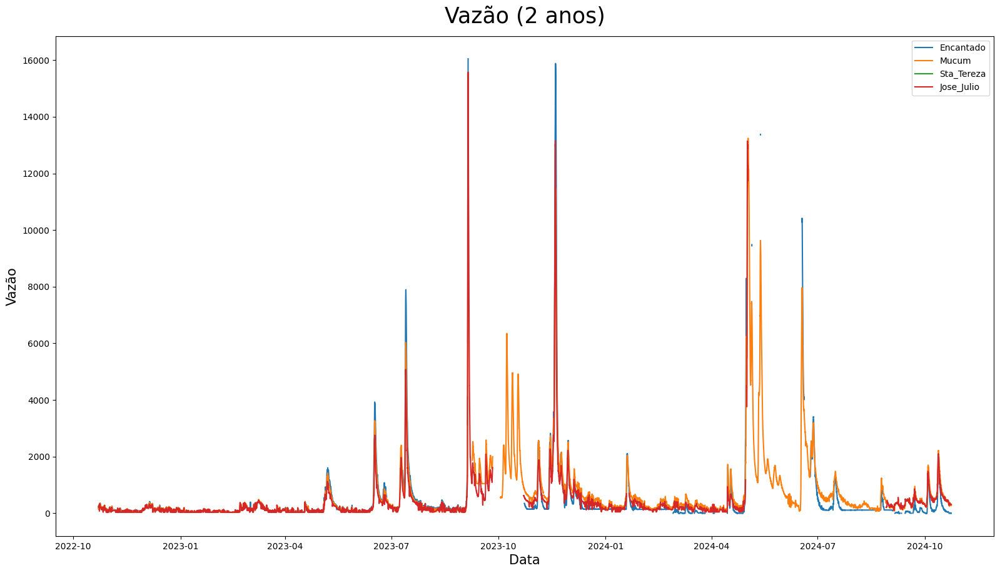

In [29]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-10-17')
data_fim = pd.to_datetime('2024-12-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão (2 anos)', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

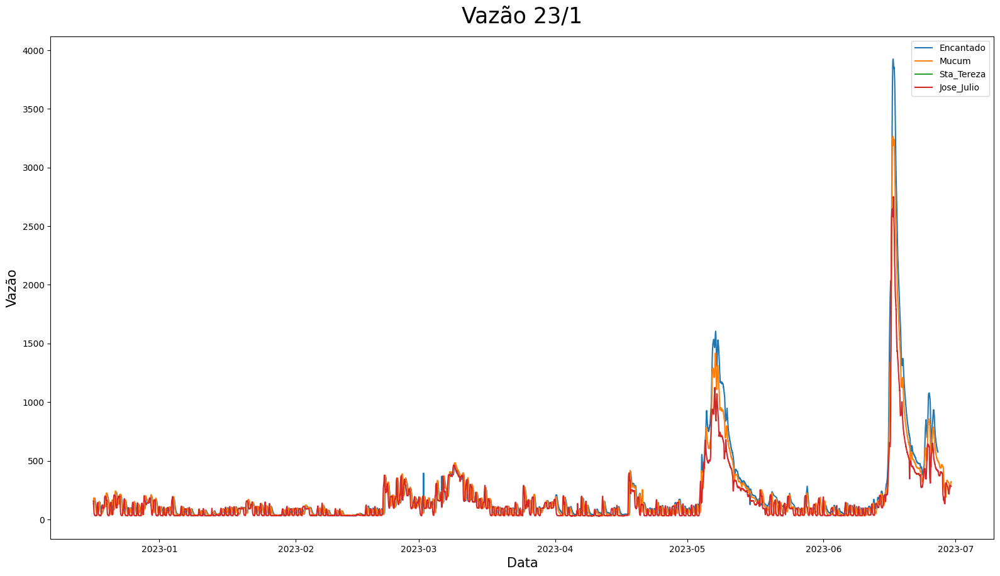

In [30]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-12-17')
data_fim = pd.to_datetime('2023-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

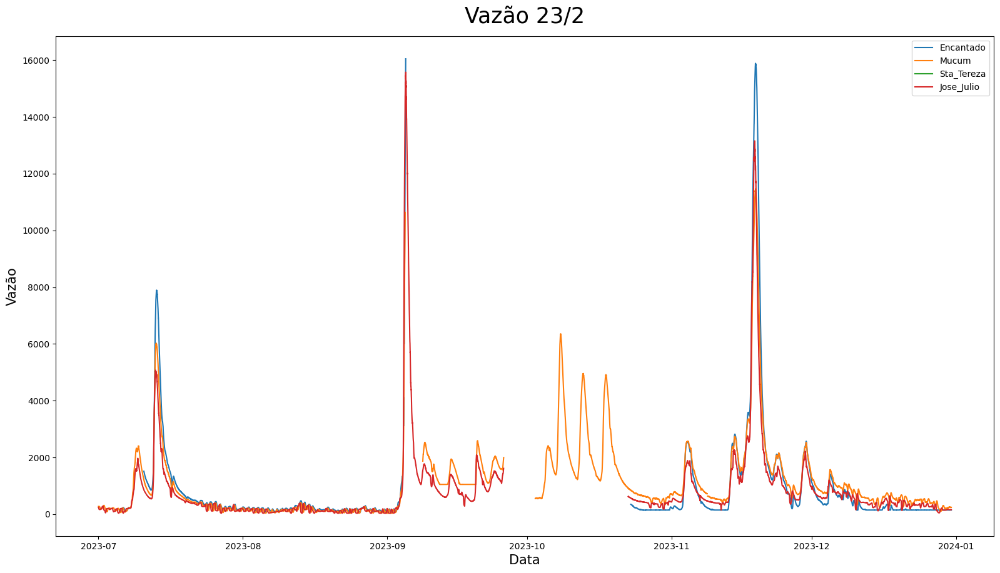

In [31]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-7-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

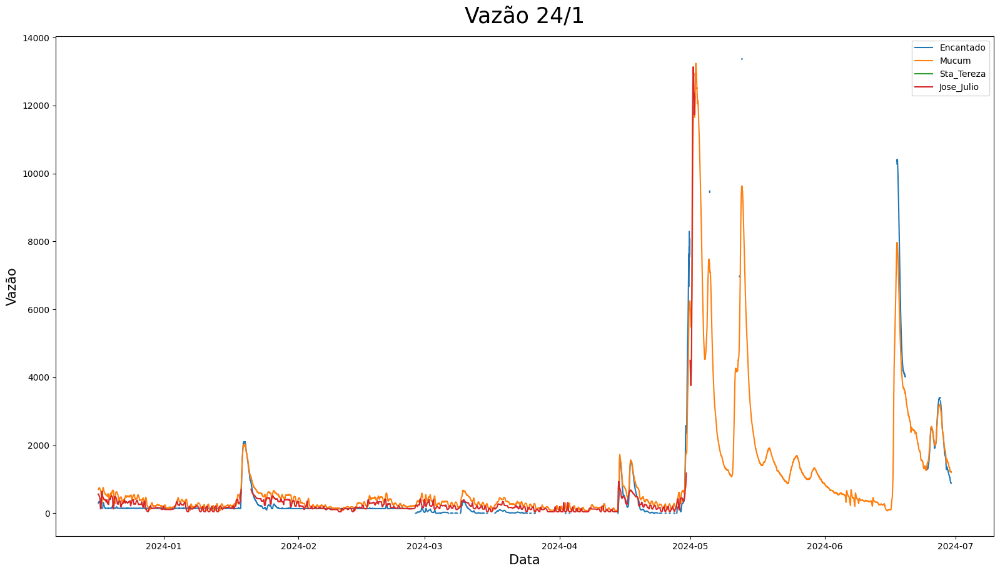

In [32]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

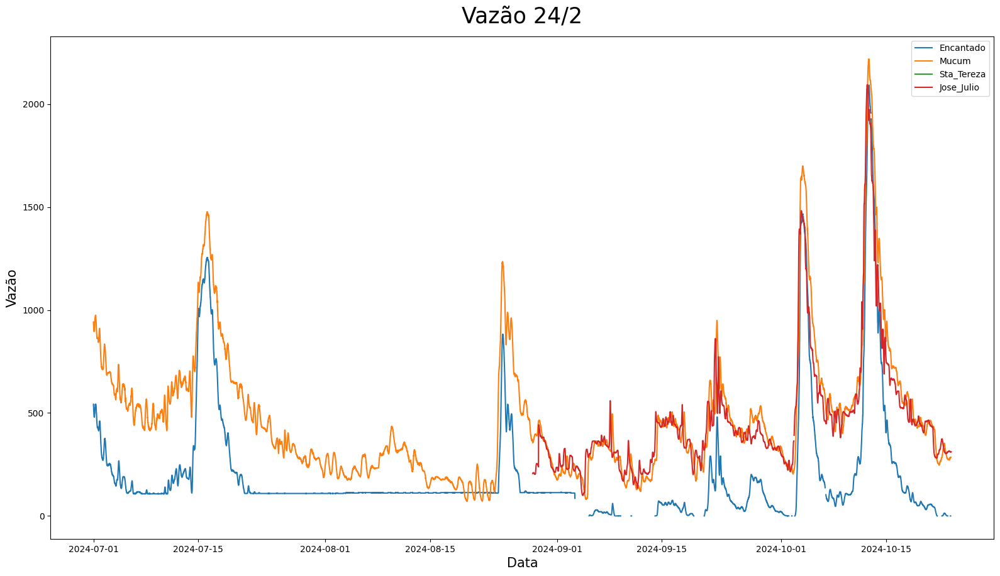

In [33]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Tratamento de dados chuva e vazao

In [34]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    62248 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


Para chuva vamos substituir valores nulos por zeros

In [35]:
'''
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)
'''

"\ndf_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)\ndf_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)\ndf_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)\ndf_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)\n"

para vazão vamos interpolar os valores nulos (descontinuado)



In [36]:
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].interpolate(method='linear')
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].interpolate(method='linear')
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].interpolate(method='linear')
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].interpolate(method='linear')

In [37]:
'''
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')
'''

"\ndf_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')\ndf_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')\n"

conferir se sobrou algum valor nulo para chuva e vazão

In [38]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    64814 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


# SHIFT

Para remover os valores nulos do Nivel da agua nos 4 pontos de coleta de dados será necessario fazer uma combinação dos valores faltantes de cada cidade com os valores existentes das outras.

Mas para isto é necessario fazer os valores não ter difereça de data pois cada cidade atinge o maximo em tempos diferentes e cada medidor possui um ponto de referencia diferente.

*   Deslocar a data
*   Fazer que tenha niveis semelhantes



In [39]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64814 entries, 0 to 64813
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64814 non-null  datetime64[ns]
 1   Chuva(mm)    64814 non-null  float64       
 2   Nivel(cm)    52718 non-null  float64       
 3   Vazao(m3/s)  53612 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


## Pré deslocamento

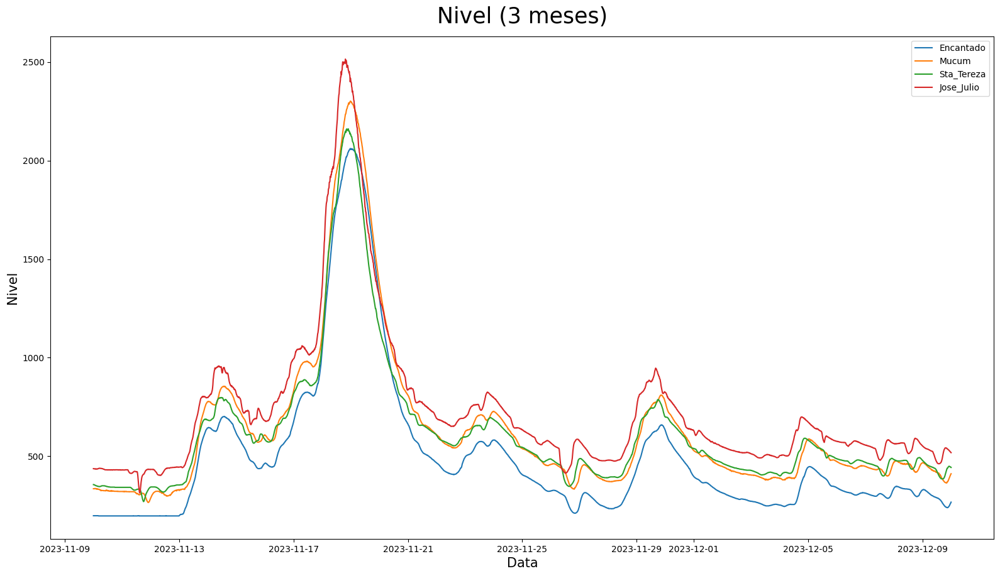

In [40]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

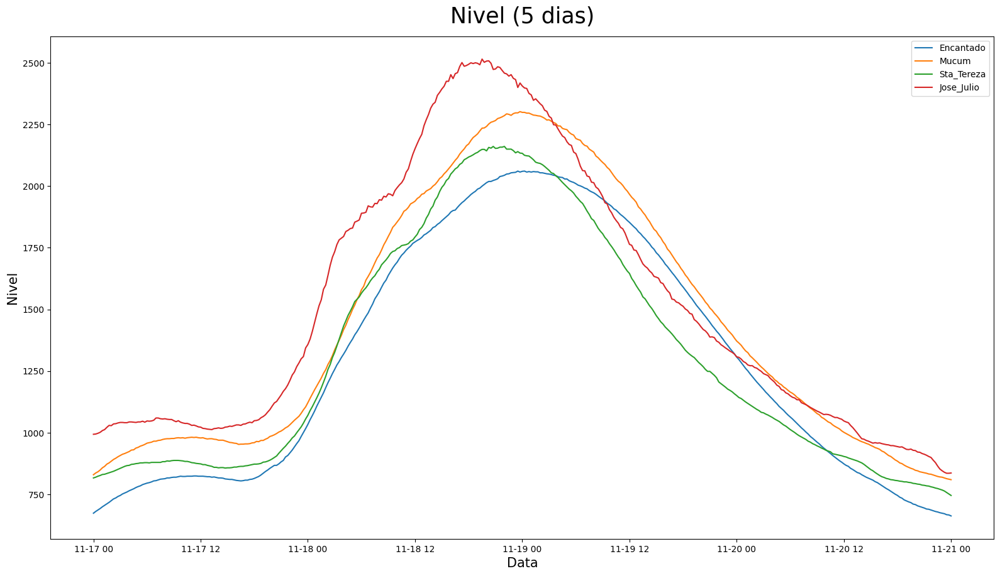

In [41]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado24, df_Mucum24, df_Sta_Tereza24, df_Jose_Julio24,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

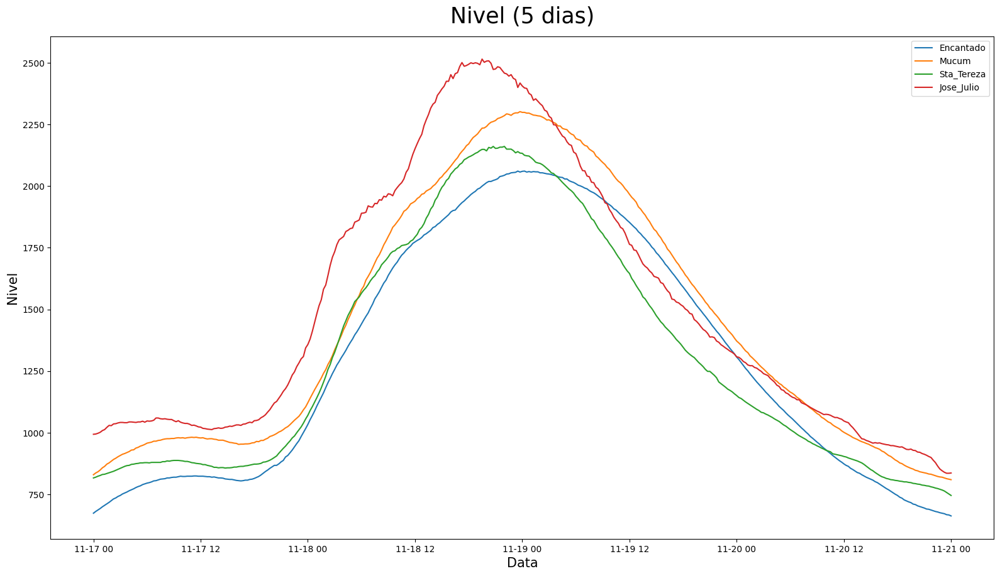

In [42]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

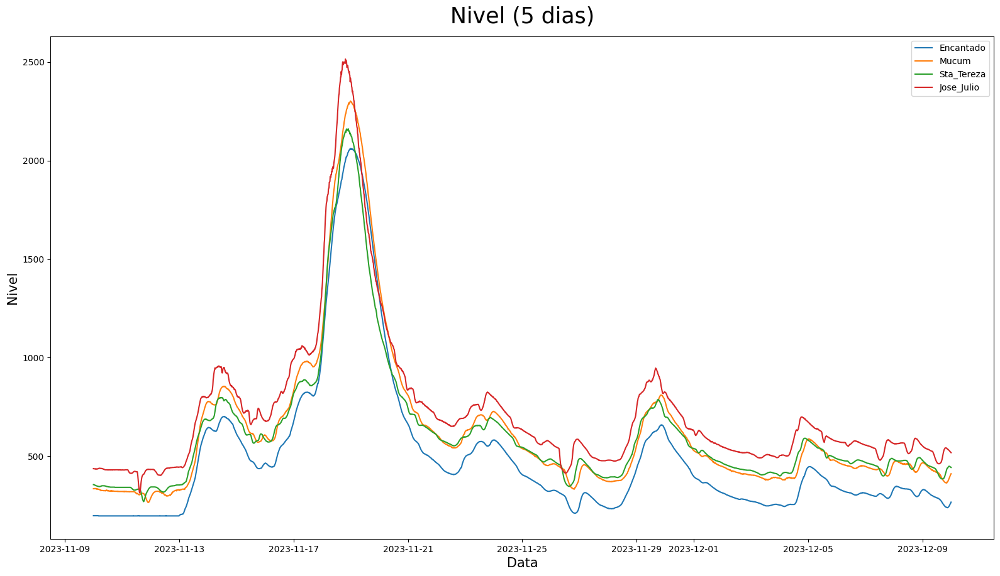

In [43]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Deslocamento a partir da data

ao deslocar as datas temos que remover as extremidades pois ficaremos com valores das datas nulos

In [44]:
import pandas as pd

def deslocar_data_series(tabela1, tabela2, tabela3, tabela4, coluna_data, shift1=0, shift2=0, shift3=0, shift4=0):
    """
    Desloca a coluna de data em cada tabela de acordo com os valores de shift fornecidos
    e remove valores nulos nas extremidades para manter todas as tabelas alinhadas.

    Parâmetros:
    - tabela1, tabela2, tabela3, tabela4: tabelas de dados pandas DataFrame.
    - coluna_data: nome da coluna de data.
    - shift1, shift2, shift3, shift4: valores de deslocamento para cada tabela (em unidades de linha).

    Retorna:
    - Quatro tabelas alinhadas e sem valores nulos nas extremidades.
    """

    # Aplicar os deslocamentos na coluna de data em cada tabela
    tabela1[coluna_data] = tabela1[coluna_data].shift(shift1)
    tabela2[coluna_data] = tabela2[coluna_data].shift(shift2)
    tabela3[coluna_data] = tabela3[coluna_data].shift(shift3)
    tabela4[coluna_data] = tabela4[coluna_data].shift(shift4)

    # Sincronizar os índices removendo valores nulos das extremidades, com base no maior deslocamento
    max_shift = max(shift1, shift2, shift3, shift4)
    min_shift = min(shift1, shift2, shift3, shift4)

    # Recortar todas as tabelas para o mesmo intervalo de dados, removendo extremidades com nulos
    tabela1 = tabela1.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela2 = tabela2.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela3 = tabela3.iloc[max_shift:min_shift].reset_index(drop=True)
    tabela4 = tabela4.iloc[max_shift:min_shift].reset_index(drop=True)

    return tabela1, tabela2, tabela3, tabela4

In [45]:
# Definir os deslocamentos específicos para cada tabela
shift1, shift2, shift3, shift4 = -12, -12, 7, 20

# Alinhar as tabelas
df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico = deslocar_data_series(
    df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
    coluna_data='Data/Hora',
    shift1=shift1, shift2=shift2, shift3=shift3, shift4=shift4
)

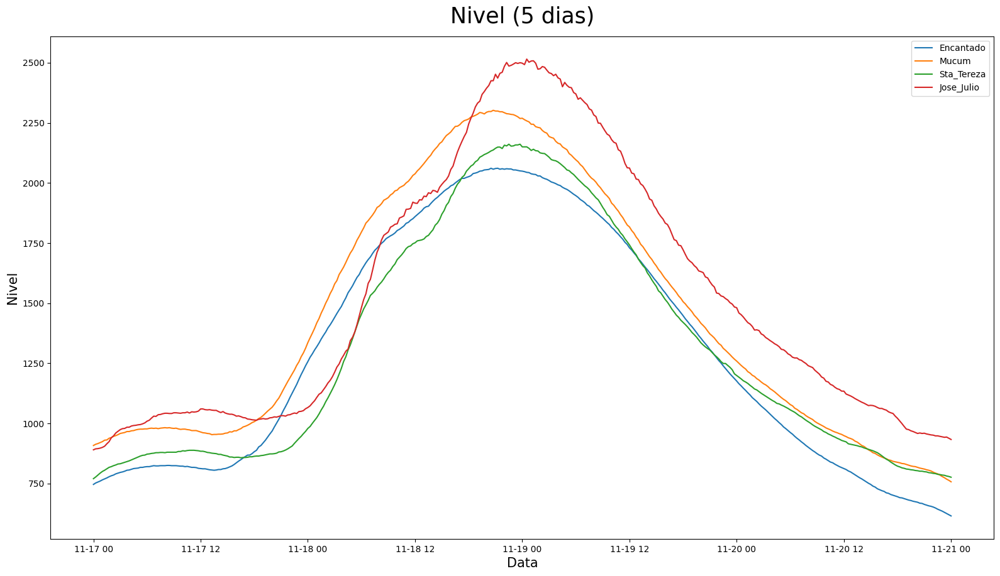

In [46]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [47]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 64782 entries, 0 to 64781
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    64782 non-null  datetime64[ns]
 1   Chuva(mm)    64782 non-null  float64       
 2   Nivel(cm)    52686 non-null  float64       
 3   Vazao(m3/s)  53597 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.0 MB


- Confirmando se os dados das extremidades foram removidos

In [48]:
df_Jose_Julio_unico.head(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 16:30:00,0.0,398.0,314.34
1,2024-10-23 16:15:00,0.0,398.0,314.34
2,2024-10-23 16:00:00,0.0,398.0,314.34
3,2024-10-23 15:45:00,0.0,398.0,314.34
4,2024-10-23 15:30:00,0.0,398.0,314.34
5,2024-10-23 15:15:00,0.0,399.0,316.64
6,2024-10-23 15:00:00,0.0,398.0,314.34
7,2024-10-23 14:45:00,0.0,398.0,314.34
8,2024-10-23 14:30:00,0.0,398.0,314.34
9,2024-10-23 14:15:00,0.0,398.0,314.34


In [49]:
df_Sta_Tereza_unico.head(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2024-10-23 12:15:00,0.0,257.0,NaN
1,2024-10-23 12:00:00,0.0,257.0,NaN
2,2024-10-23 11:45:00,0.0,257.0,NaN
3,2024-10-23 11:30:00,0.0,257.0,NaN
4,2024-10-23 11:15:00,0.0,257.0,NaN
5,2024-10-23 11:00:00,0.0,257.0,NaN
6,2024-10-23 10:45:00,0.0,257.0,NaN
7,2024-10-23 10:30:00,0.0,256.0,NaN
8,2024-10-23 10:15:00,0.0,256.0,NaN
9,2024-10-23 10:00:00,0.0,256.0,NaN


In [50]:
df_Mucum_unico.tail(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
69344,2022-10-22 20:30:00,0.0,223.0,254.1
69345,2022-10-22 20:15:00,0.0,221.0,249.3
69346,2022-10-22 20:00:00,0.0,219.0,244.5
69347,2022-10-22 19:45:00,0.0,216.0,237.4
69348,2022-10-22 19:30:00,0.0,213.0,230.5
69349,2022-10-22 19:15:00,0.0,209.0,221.4
69350,2022-10-22 19:00:00,0.0,206.0,214.6
69351,2022-10-22 18:45:00,0.0,201.0,203.7
69352,2022-10-22 18:30:00,0.0,197.0,195.1
69353,2022-10-22 18:15:00,0.0,192.0,184.6


In [51]:
df_Encantado_unico.tail(21)

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64761,2022-10-22 20:15:00,0.0,213.0,197.6
64762,2022-10-22 20:00:00,0.0,211.0,190.8
64763,2022-10-22 19:45:00,0.0,208.0,180.8
64764,2022-10-22 19:30:00,0.0,206.0,174.3
64765,2022-10-22 19:15:00,0.0,204.0,167.8
64766,2022-10-22 19:00:00,0.0,203.0,164.6
64767,2022-10-22 18:45:00,0.0,202.0,161.5
64768,2022-10-22 18:30:00,0.0,201.0,158.4
64769,2022-10-22 18:15:00,0.0,200.0,155.2
64770,2022-10-22 18:00:00,0.0,200.0,155.2


## Deslocamento dos dados em relação do nivel

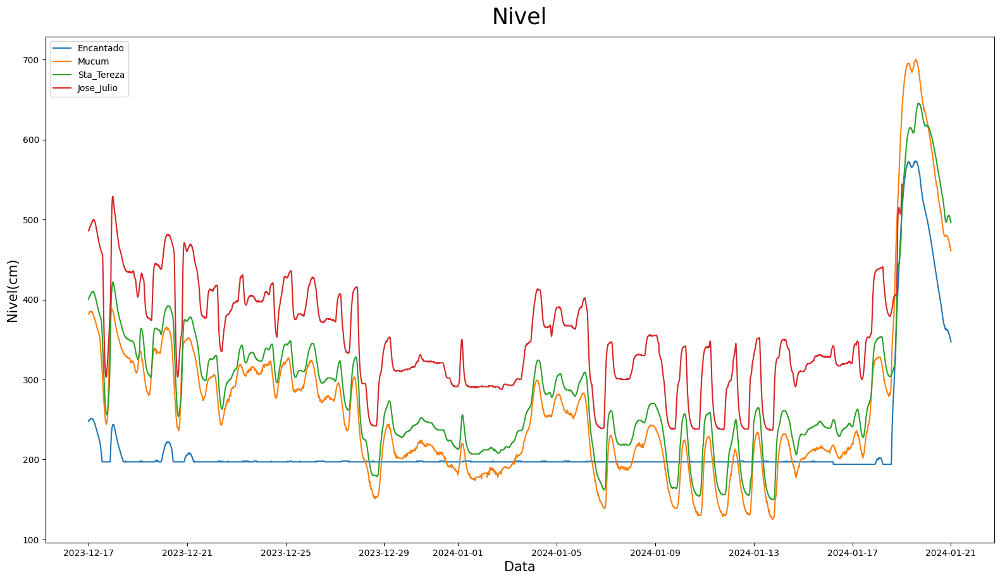

In [52]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

no grafico aciima notamos que os valores não tem diferença em questão temporal mas vemoz que possuem niveis diferentes

- Os Valores abaixo são para eles terem uma diferença geral semelhante

In [53]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] + 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] + 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] + 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] - 40

- Os graficos abaixo foram separados em faixa de 6 meses para facilitar a visualização

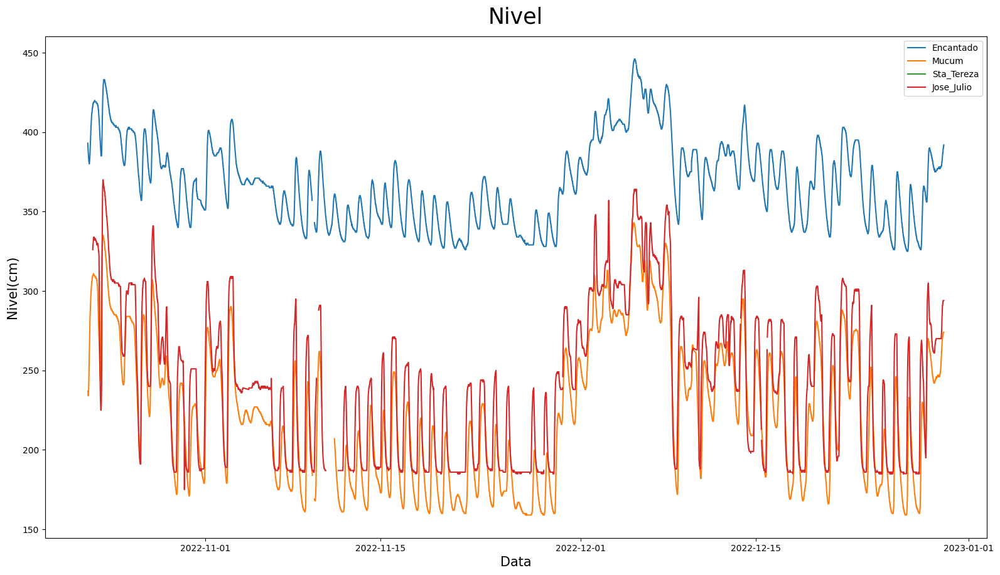

In [54]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

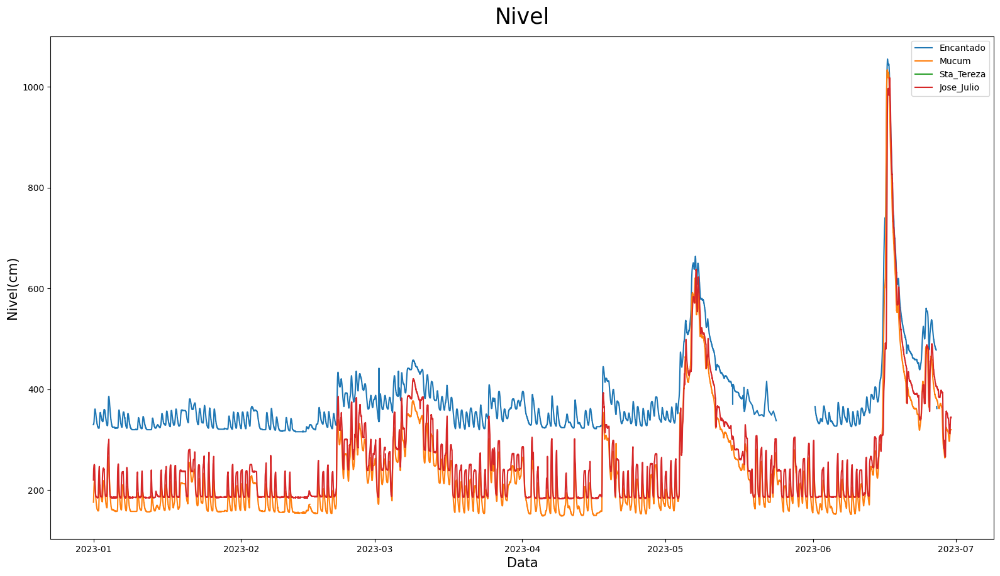

In [55]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

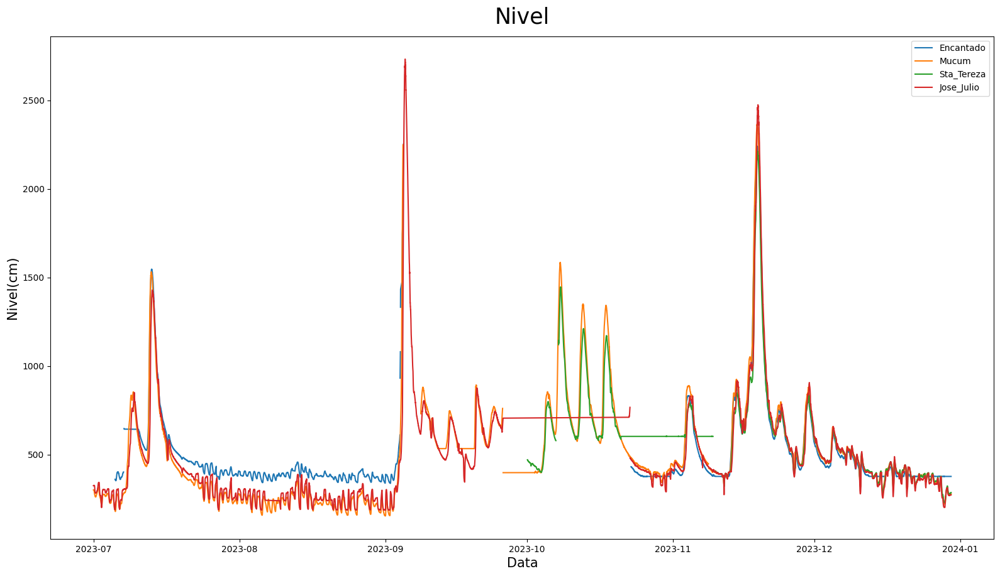

In [56]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

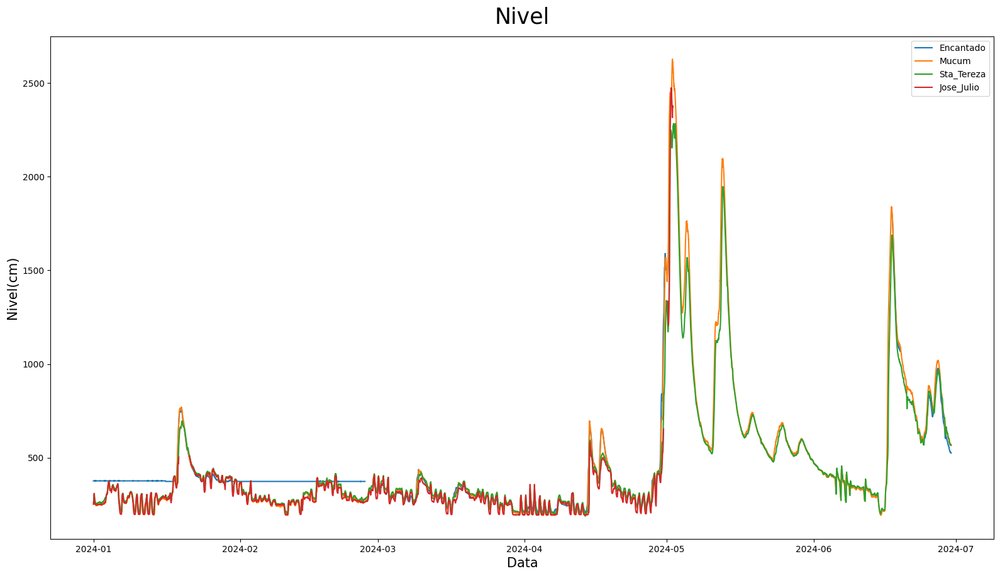

In [57]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

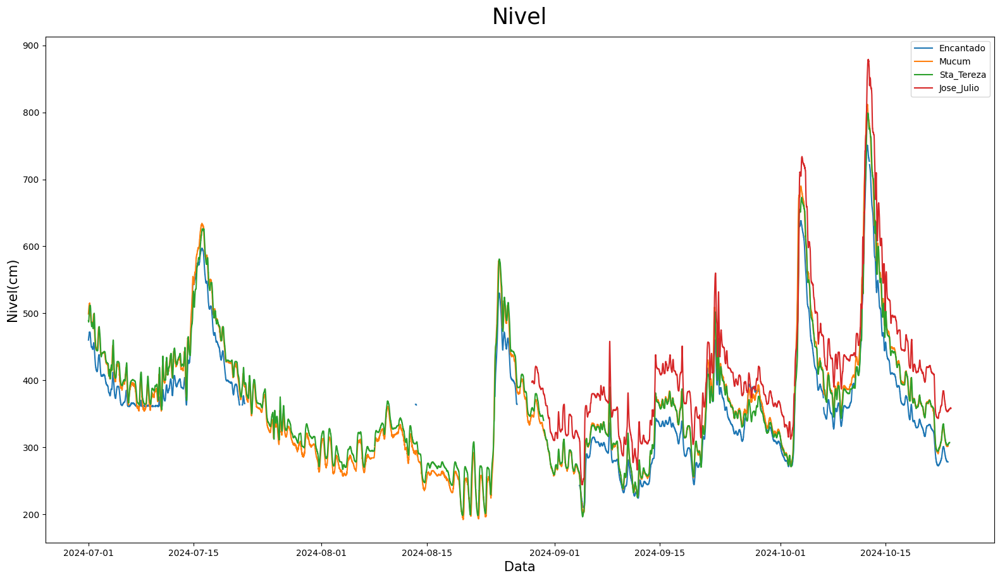

In [58]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Foi possivel notar que em faixas temporais há diferença de altura pois o medidor deve ter sido realocado do ponto original

*   Será necessario fazer ajustes em faixas temporais especifica



In [59]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

In [60]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

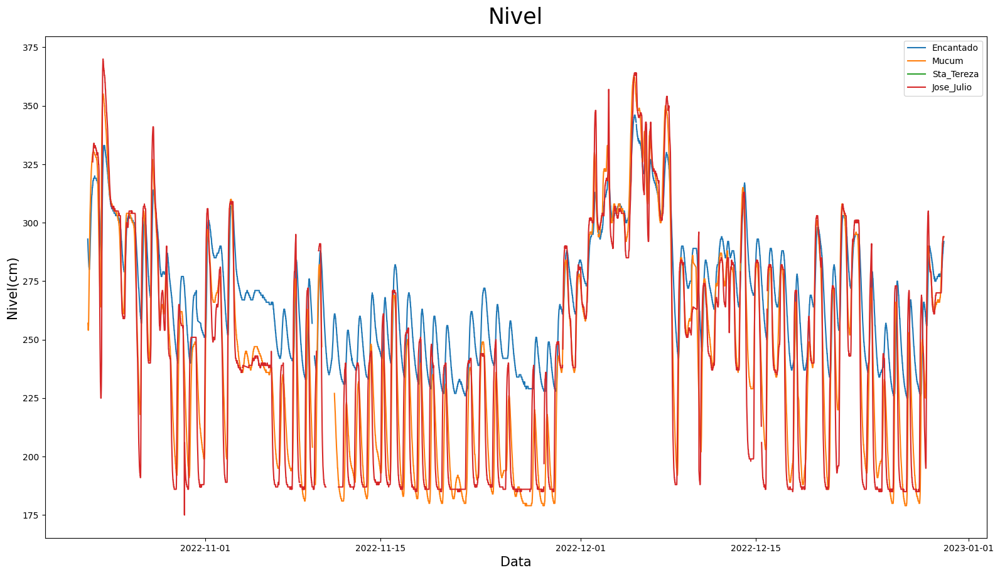

In [61]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [62]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

In [63]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

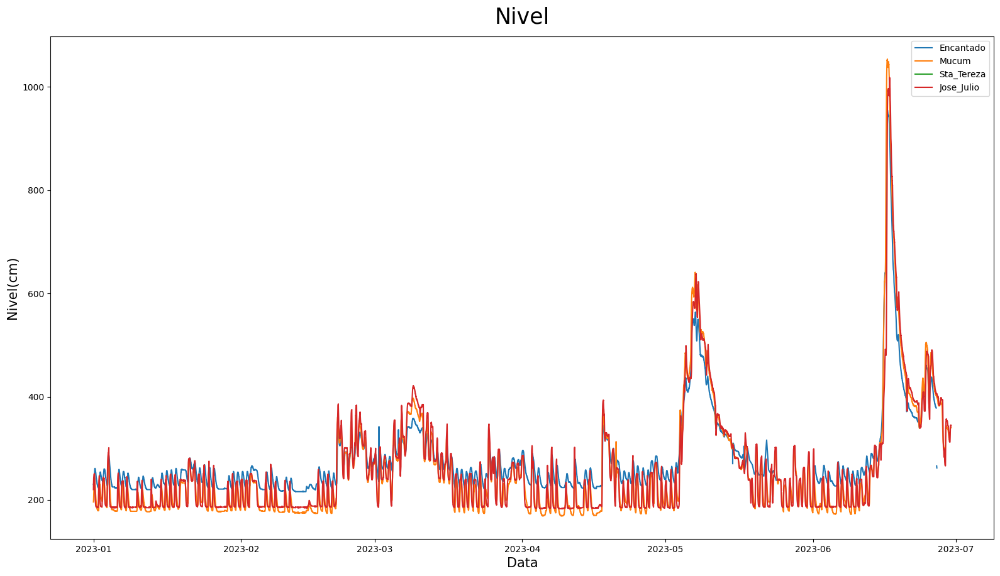

In [64]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [65]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-10-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 100

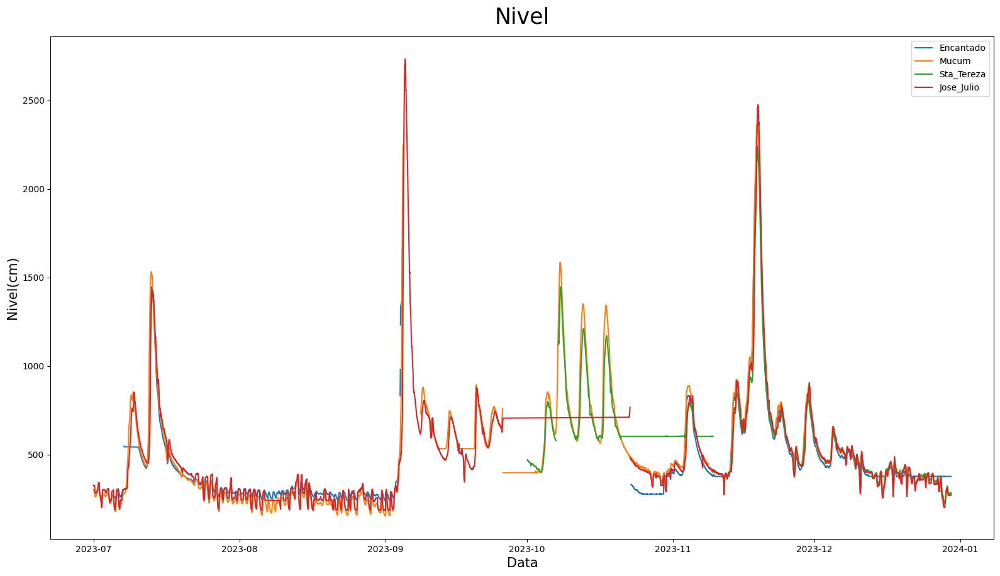

In [66]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [67]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicio) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] -= 40

In [68]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-8-1')
data_final = pd.to_datetime('2024-8-15')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [69]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Nivel(cm)'] += 20

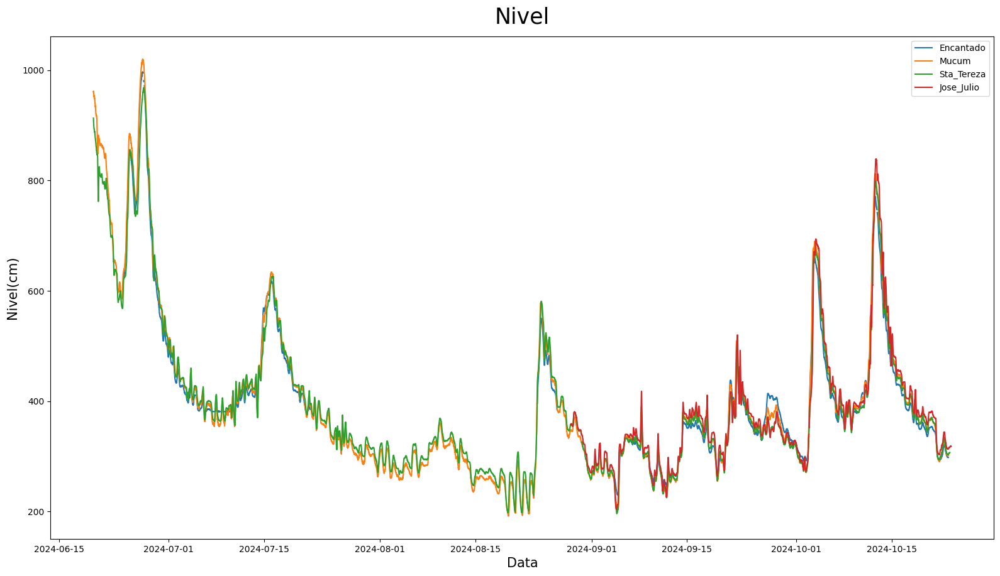

In [70]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-06-20')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Fazendo correção nos graficos de Nivel

Nos graficos há medidas constantes não refletindo na realidade, provavelmente falha no medidor
- Vamos remover estes valores

In [71]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-06-26')
data_final = pd.to_datetime('2023-7-11')
# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

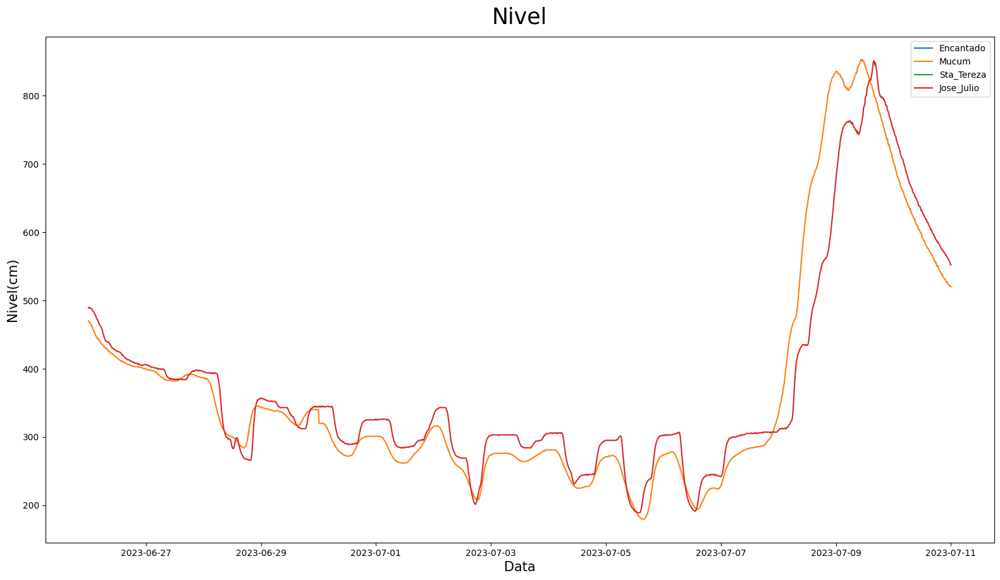

In [72]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [73]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-23')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicial) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

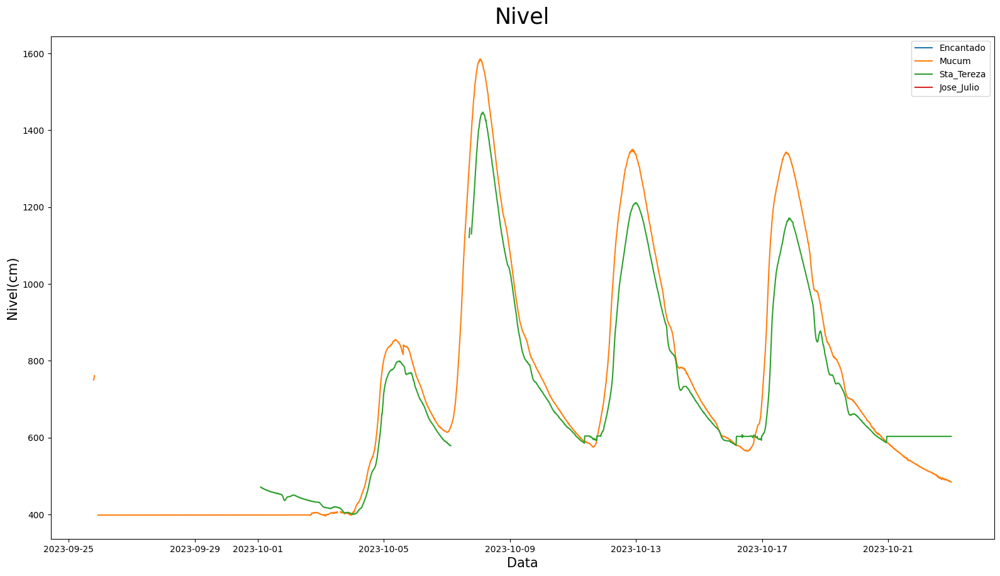

In [74]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [75]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-2 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicial) &
                        (df_Mucum_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

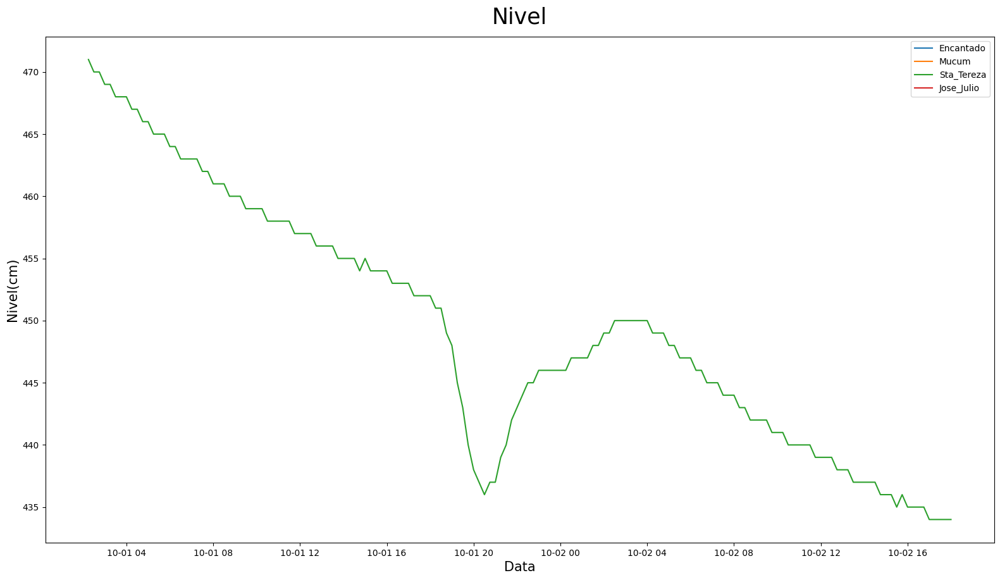

In [76]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [77]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-11-3 20:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [78]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-10-31 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

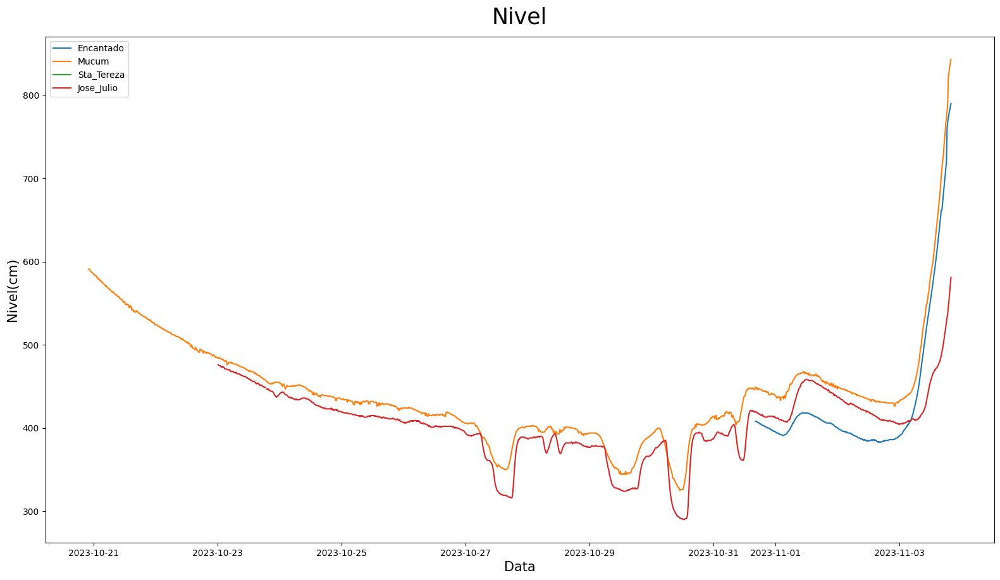

In [79]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [80]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-11-6')
data_final = pd.to_datetime('2023-11-9 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

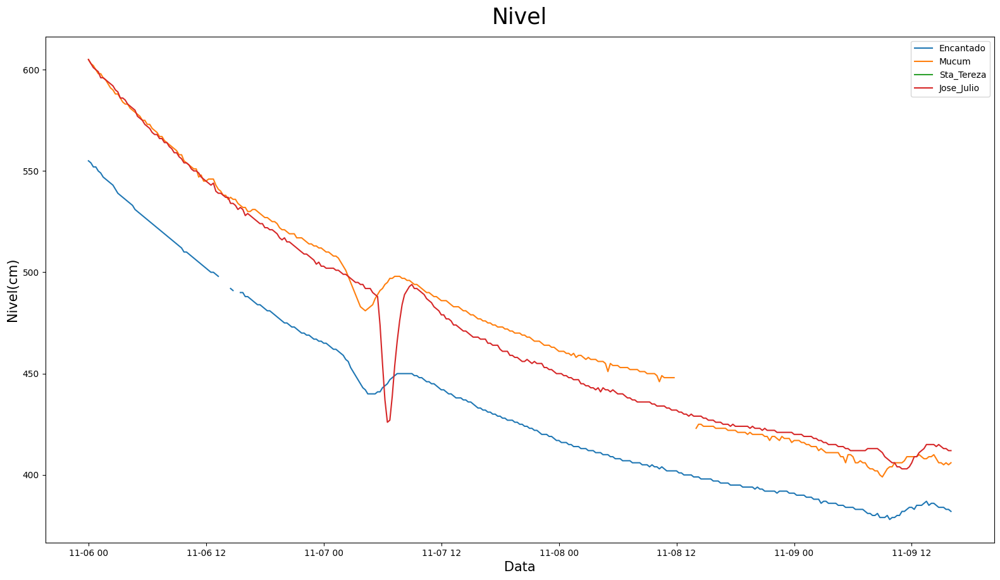

In [81]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-6')
data_fim = pd.to_datetime('2023-11-9 16:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

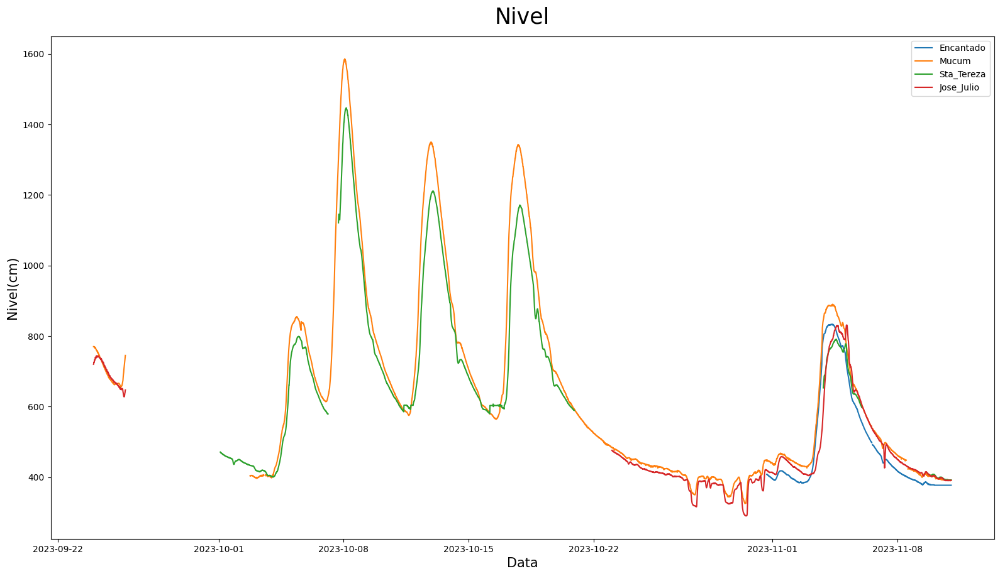

In [82]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-24')
data_fim = pd.to_datetime('2023-11-11')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [83]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-12-11 12:00')
data_final = pd.to_datetime('2024-1-18 15:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

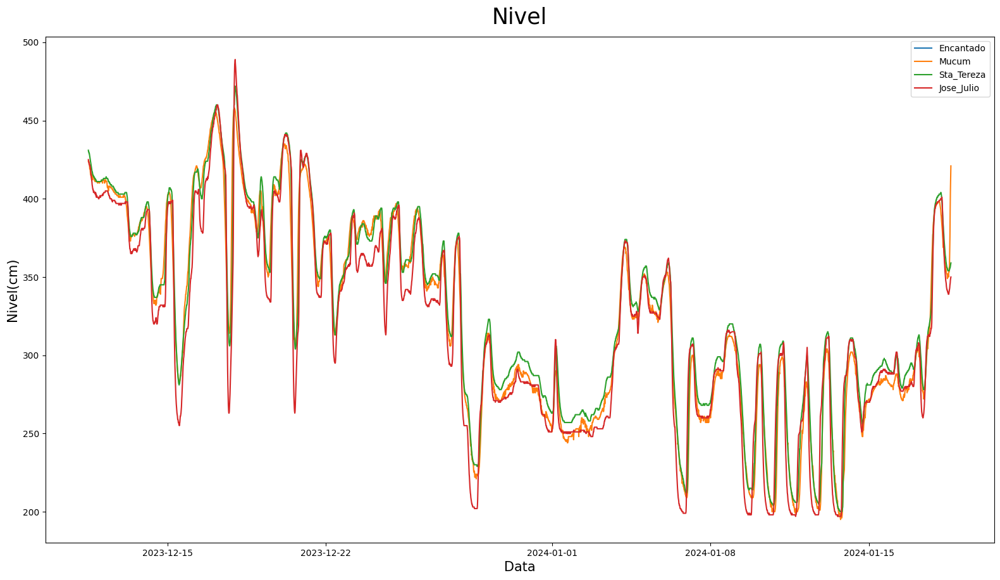

In [84]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [85]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-1-26 12:00')
data_final = pd.to_datetime('2024-2-27 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

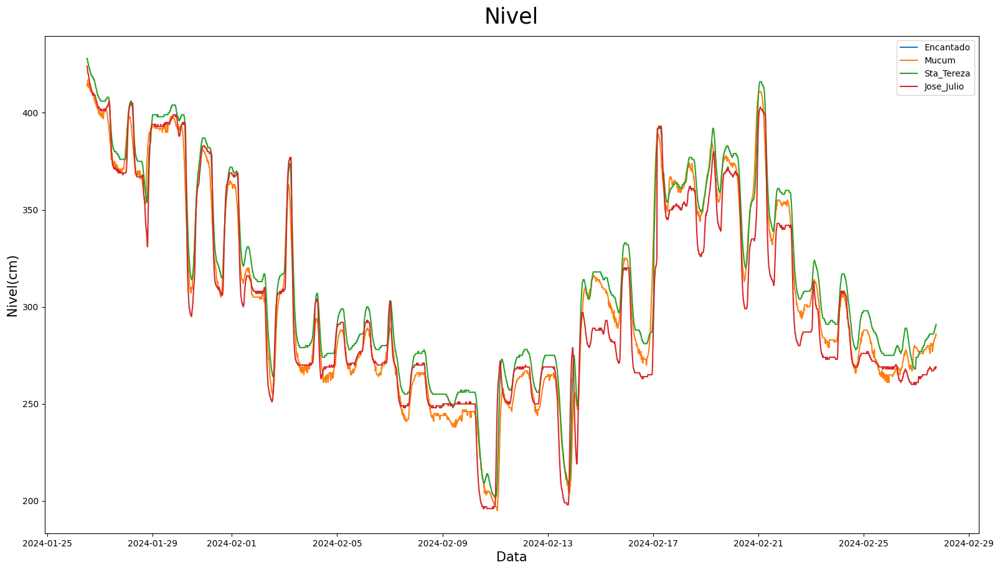

In [86]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

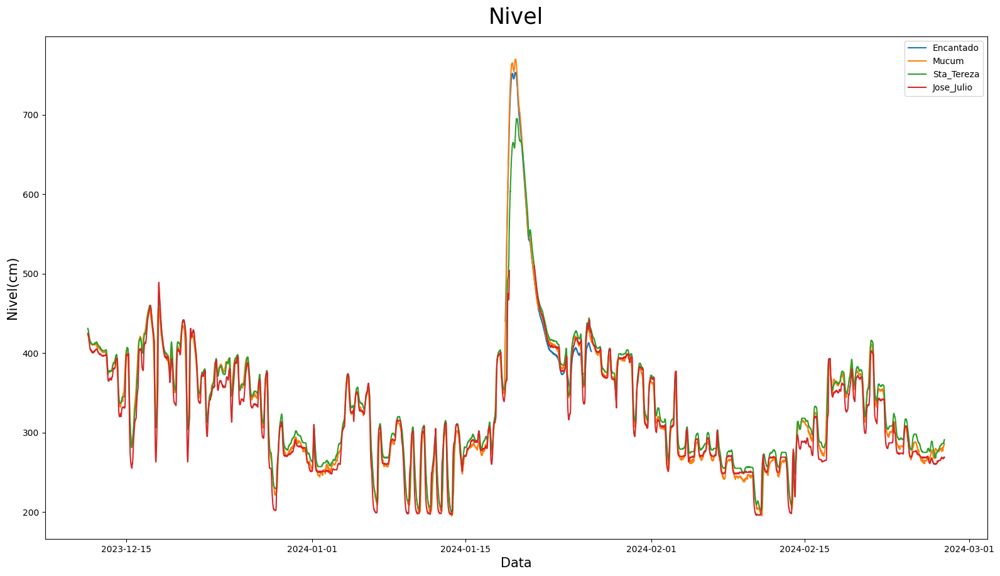

In [87]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

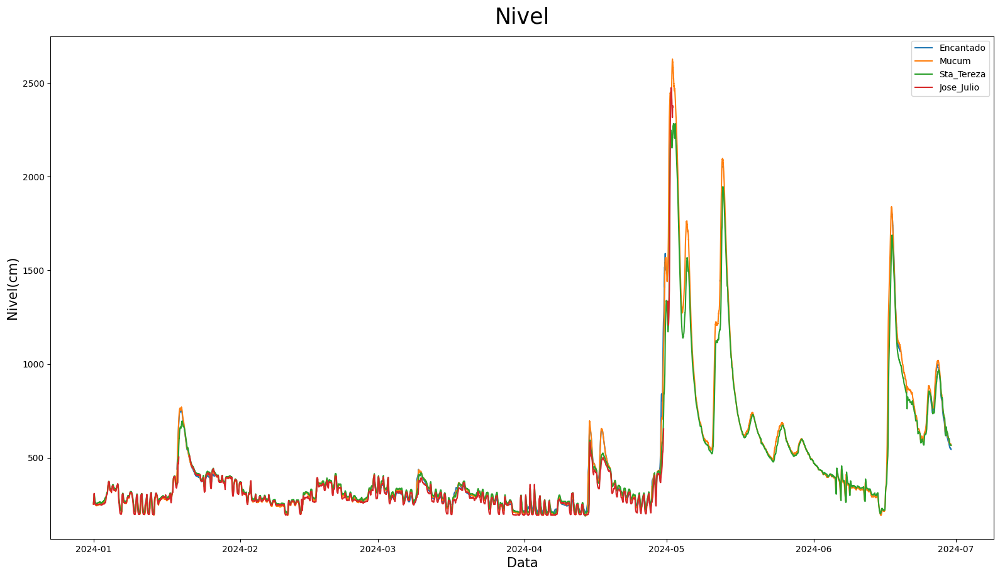

In [88]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Grafico pós tratamento de valores do nivel fora do padrão

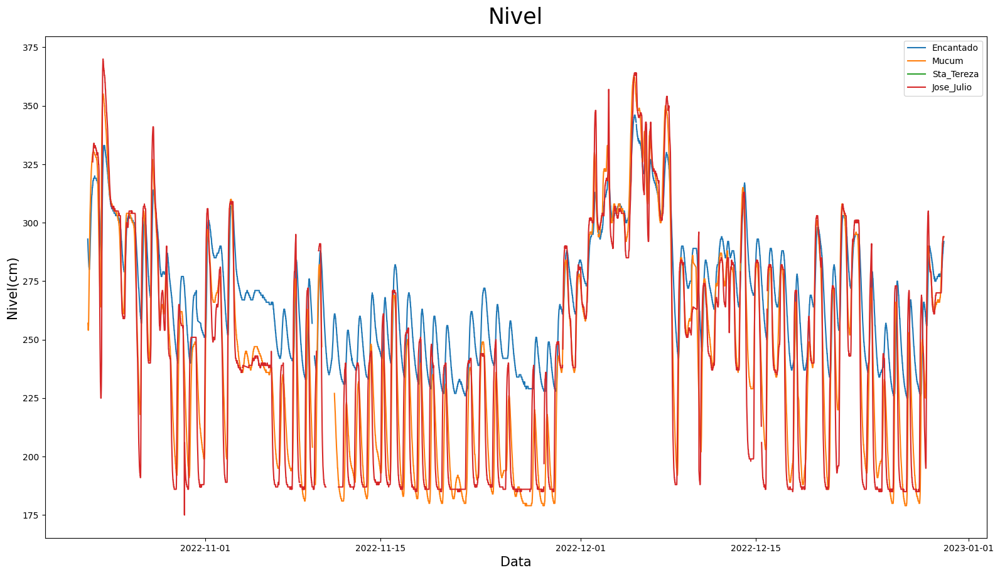

In [89]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

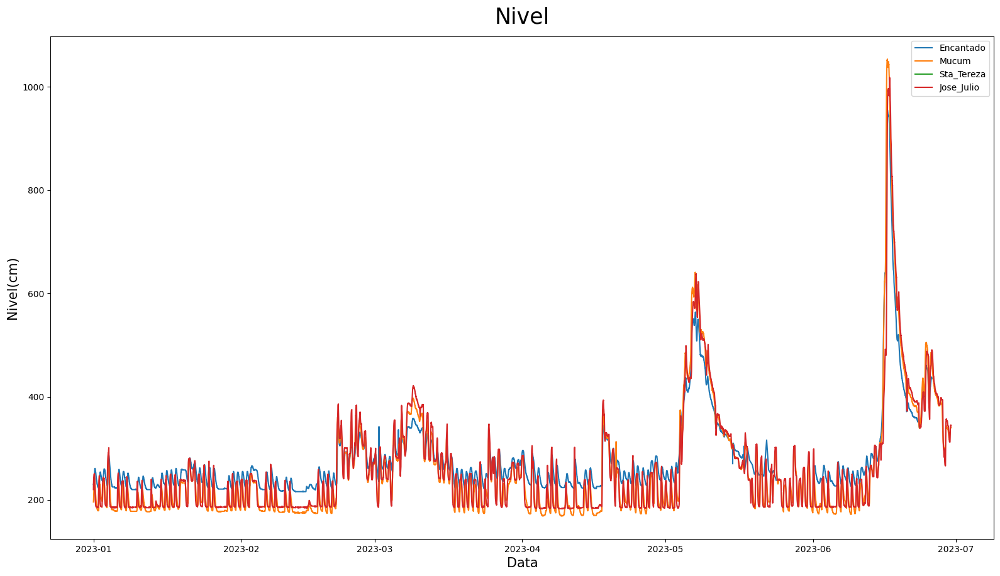

In [90]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

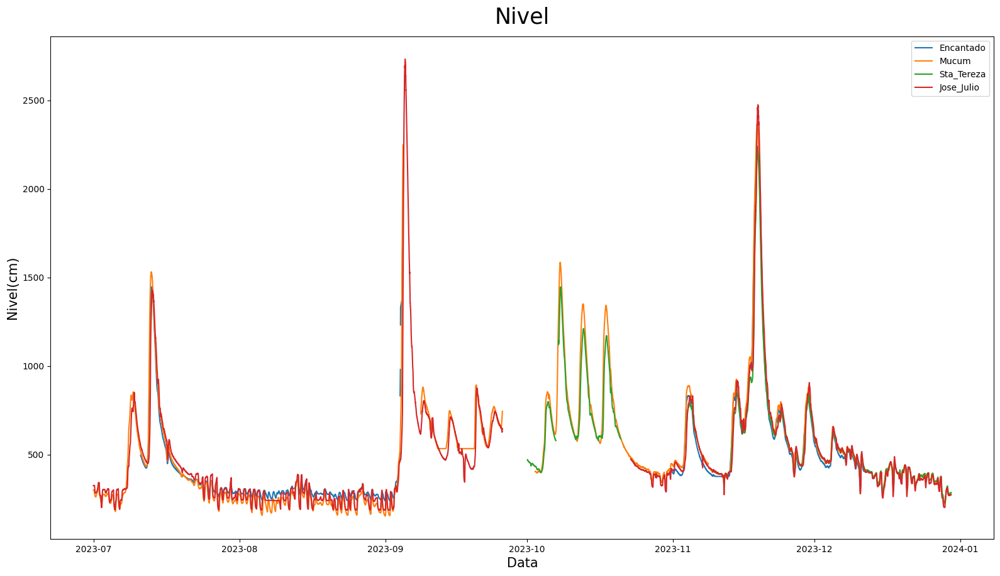

In [91]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

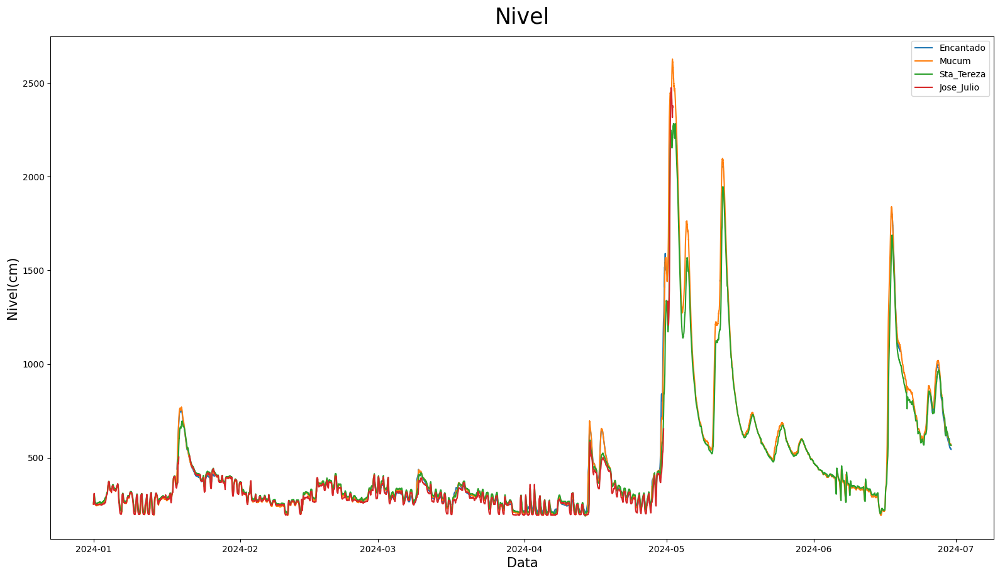

In [92]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

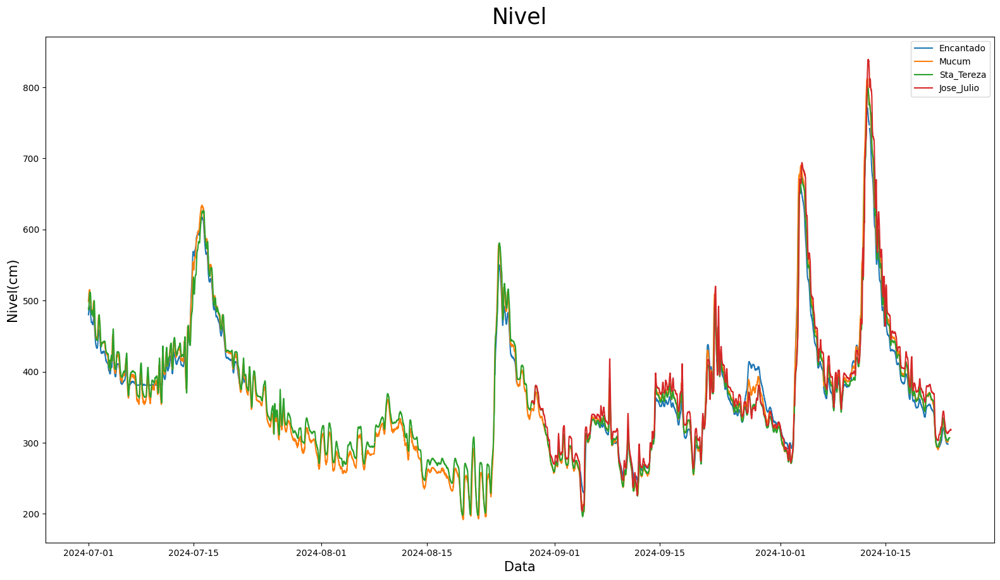

In [93]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [94]:
df_Encantado_unico.tail()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
64777,2022-10-22 16:15:00,0.0,287.0,177.5
64778,2022-10-22 16:00:00,0.0,288.0,180.8
64779,2022-10-22 15:45:00,0.0,290.0,187.5
64780,2022-10-22 15:30:00,0.0,291.0,190.8
64781,2022-10-22 15:15:00,0.0,293.0,197.6


In [95]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69365 entries, 0 to 69364
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69365 non-null  datetime64[ns]
 1   Chuva(mm)    69365 non-null  float64       
 2   Nivel(cm)    68861 non-null  float64       
 3   Vazao(m3/s)  68881 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


## Deslocamento dos dados em relação a vasão (geral)

In [96]:
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'] - 35
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'] - 0
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'] + 5

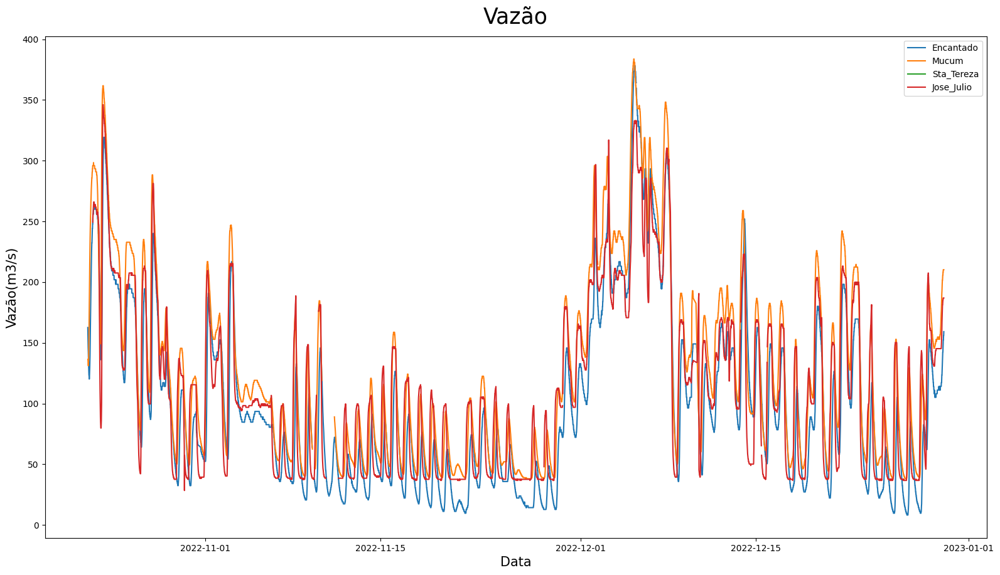

In [97]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-8-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão', 'Data', 'Vazão(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Deslocamento dos dados em relação da vazao (por partes)

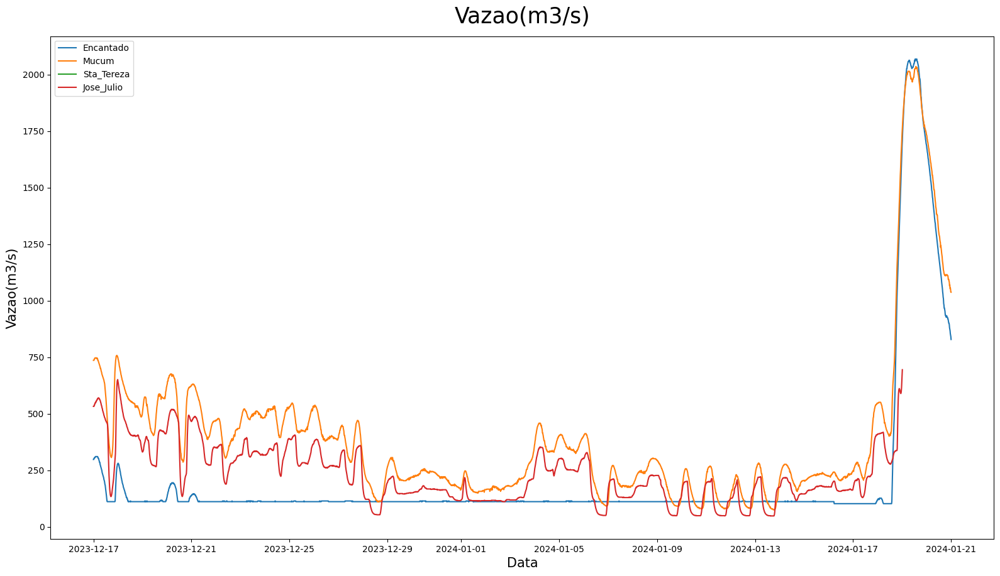

In [98]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

no grafico aciima notamos que os valores não tem diferença em questão temporal mas vemoz que possuem niveis diferentes

- Os Valores abaixo são para eles terem uma diferença geral semelhante

In [99]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] + 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] + 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] + 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] - 40

- Os graficos abaixo foram separados em faixa de 6 meses para facilitar a visualização

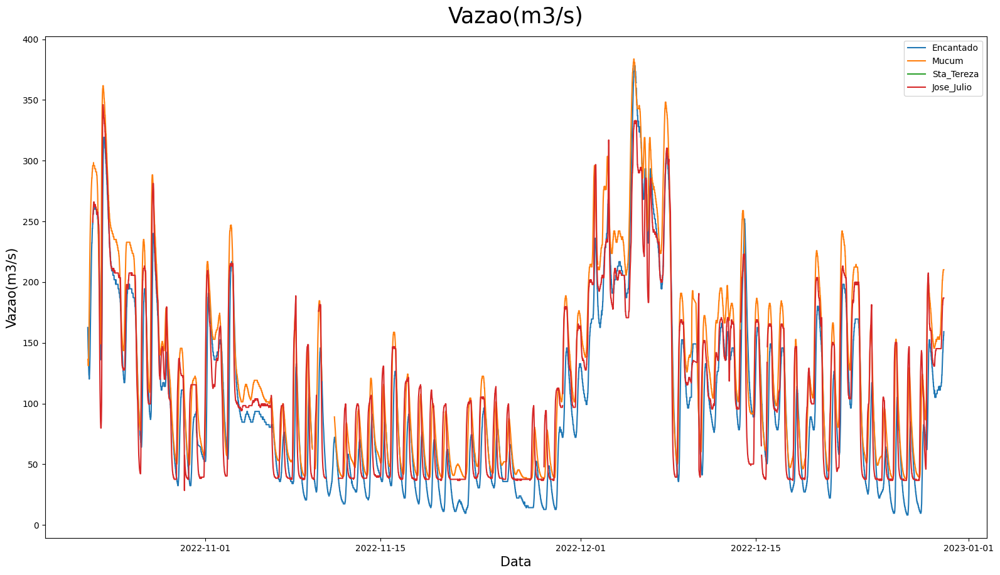

In [100]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

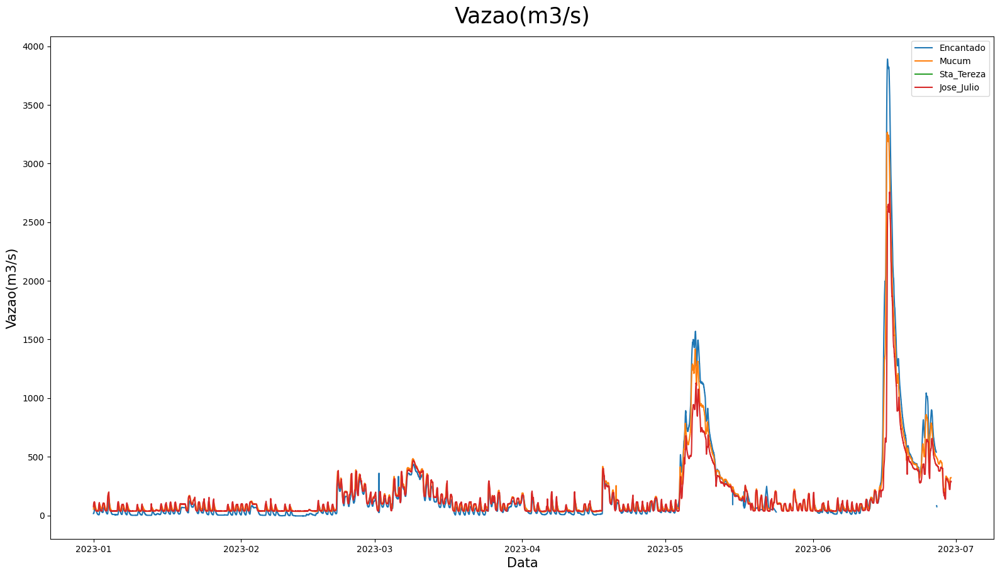

In [101]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

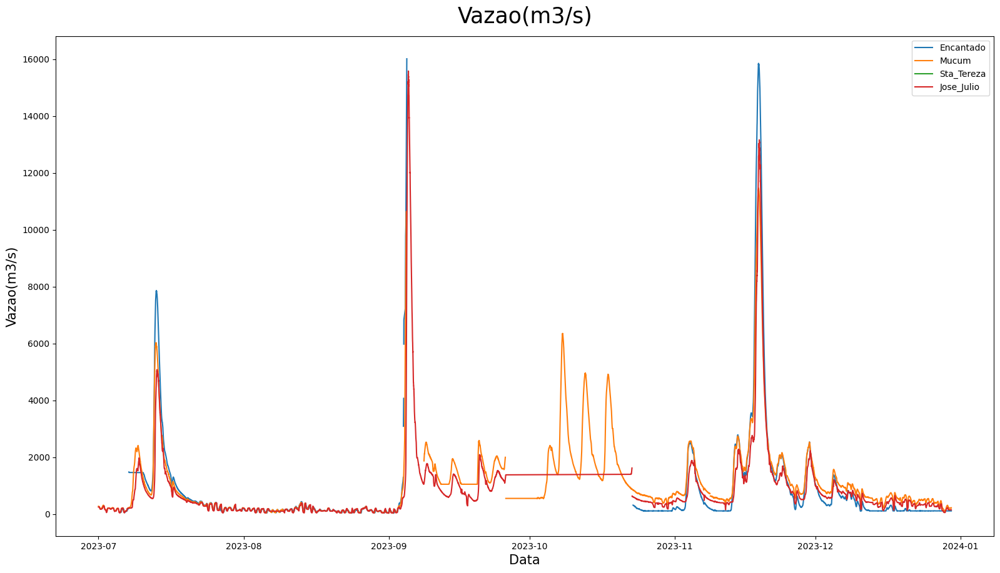

In [102]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

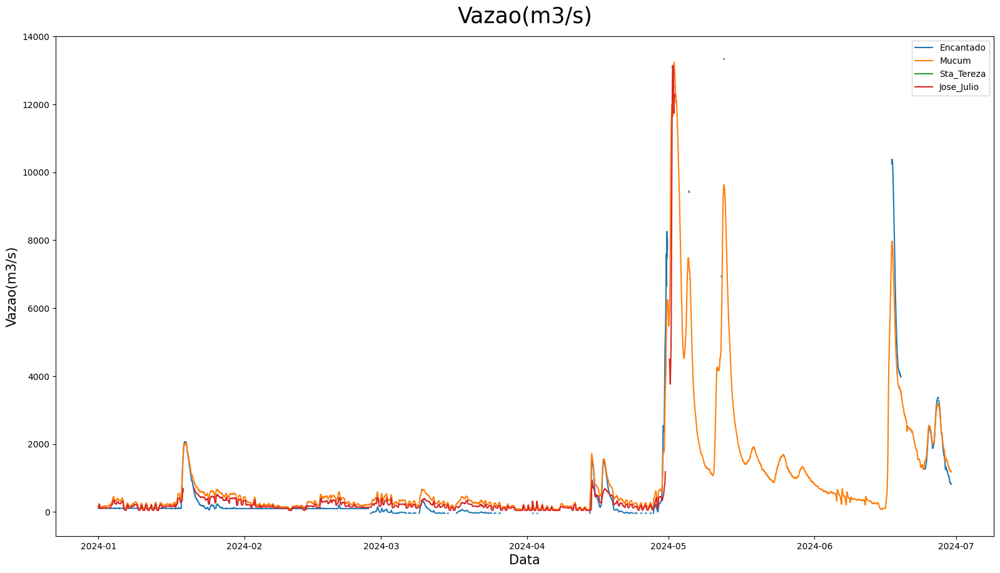

In [103]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

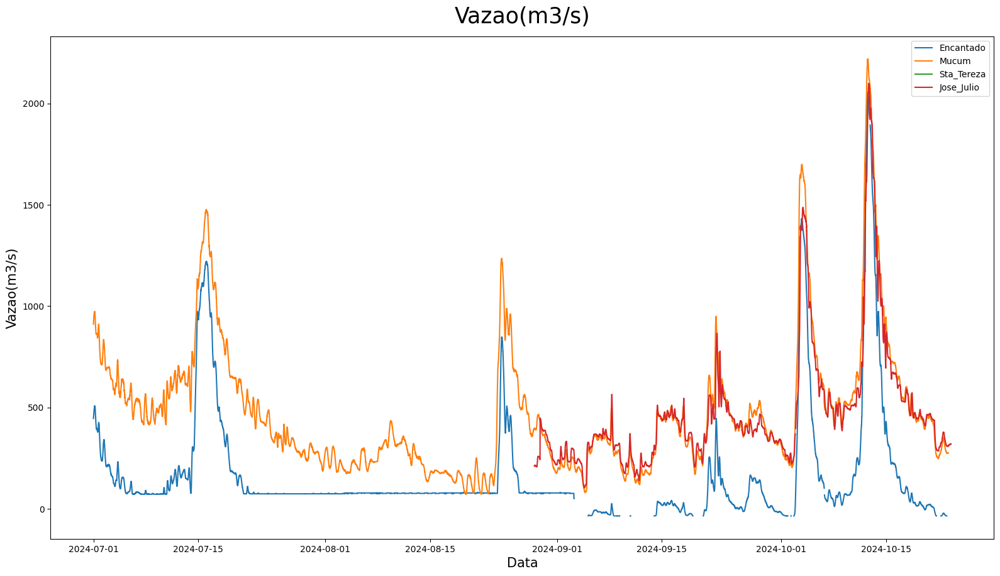

In [104]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Foi possivel notar que em faixas temporais há diferença de altura pois o medidor deve ter sido realocado do ponto original

*   Será necessario fazer ajustes em faixas temporais especifica



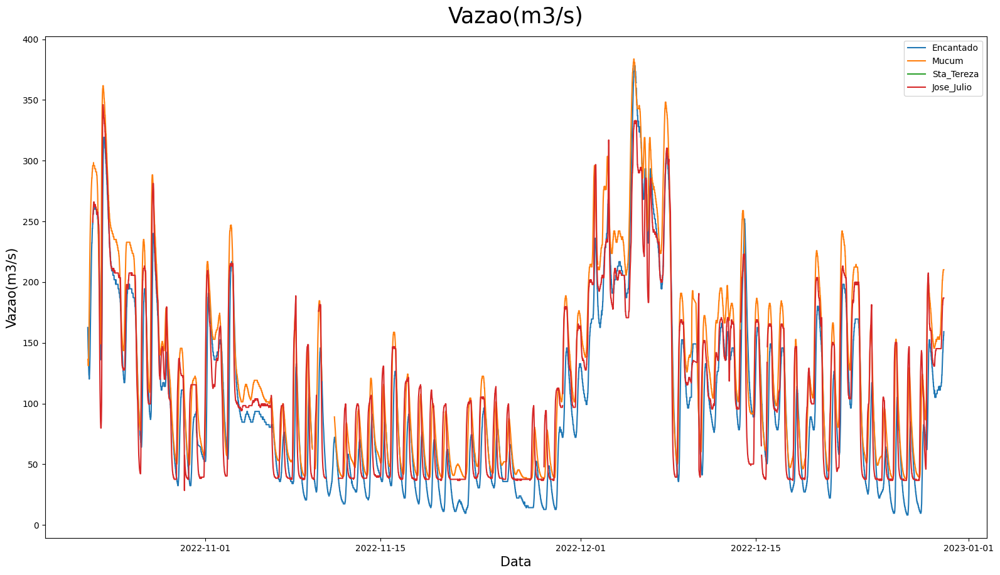

In [105]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-06-1')
data_fim = pd.to_datetime('2022-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

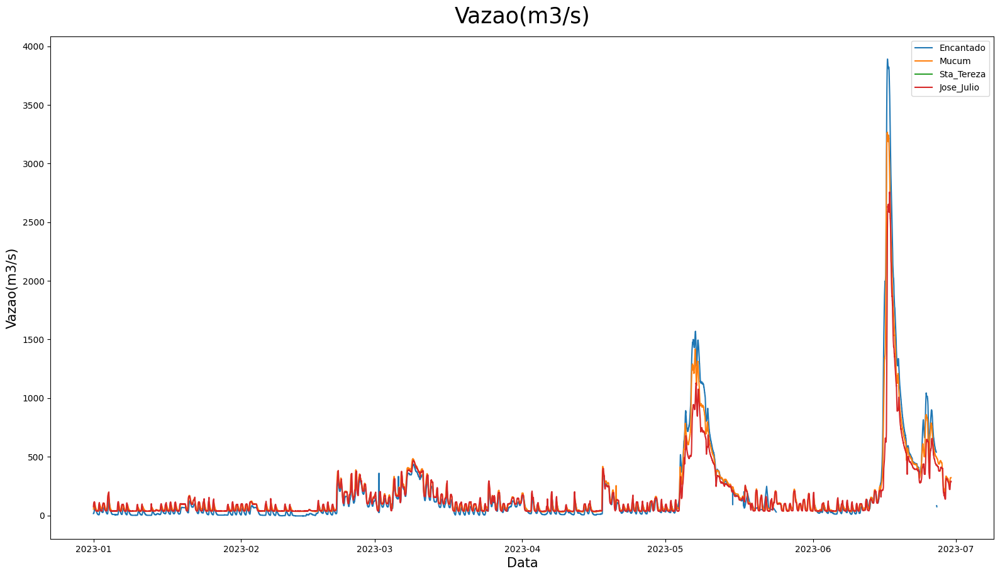

In [106]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-01-1')
data_fim = pd.to_datetime('2023-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [107]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-6')
data_fim = pd.to_datetime('2023-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] -= 250

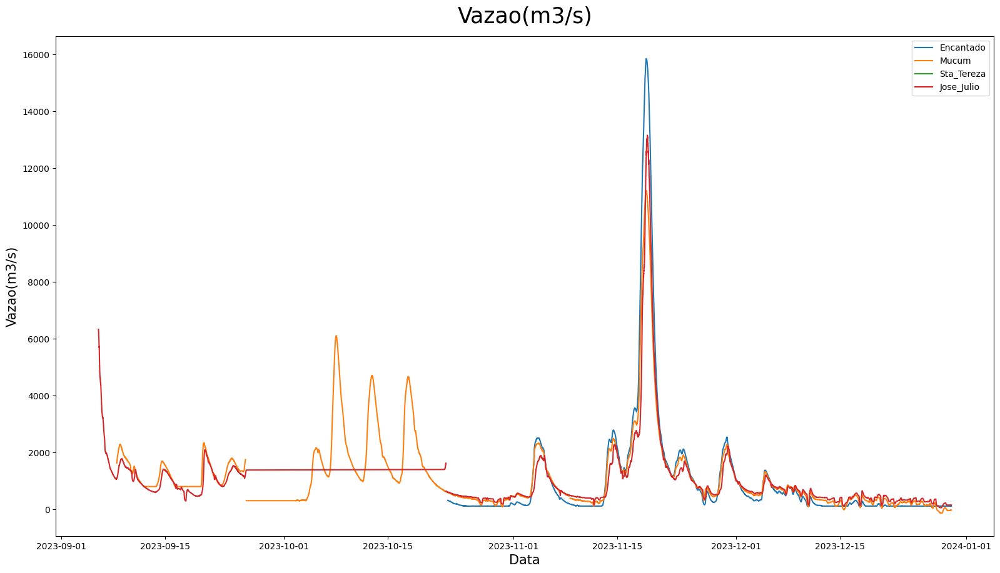

In [108]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-6')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

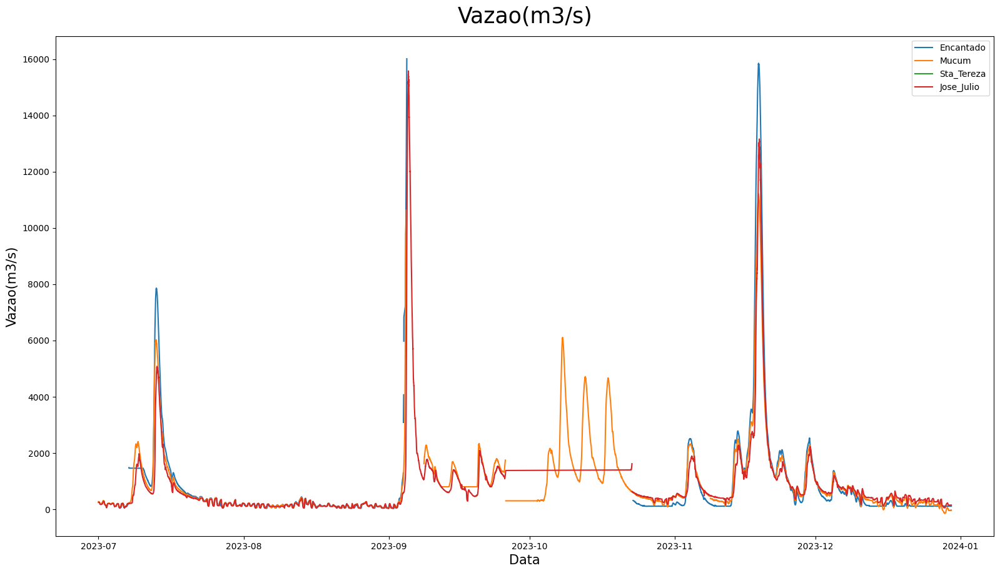

In [109]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-07-1')
data_fim = pd.to_datetime('2023-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [110]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                        (df_Mucum_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] -= 100

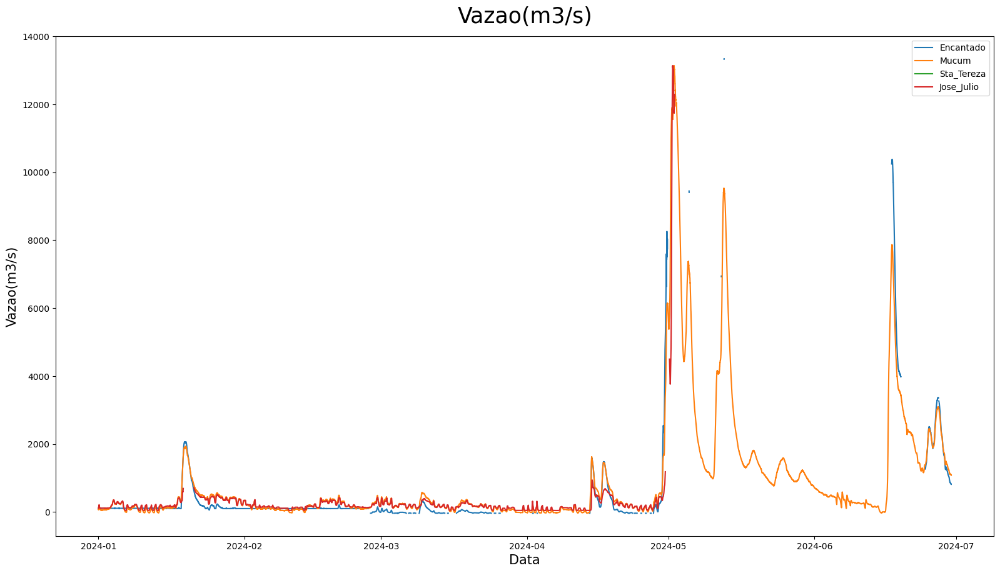

In [111]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [112]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Aplique a soma de 50 apenas para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicio) &
                        (df_Encantado_unico['Data/Hora'] <= data_fim),
                        'Vazao(m3/s)'] += 390

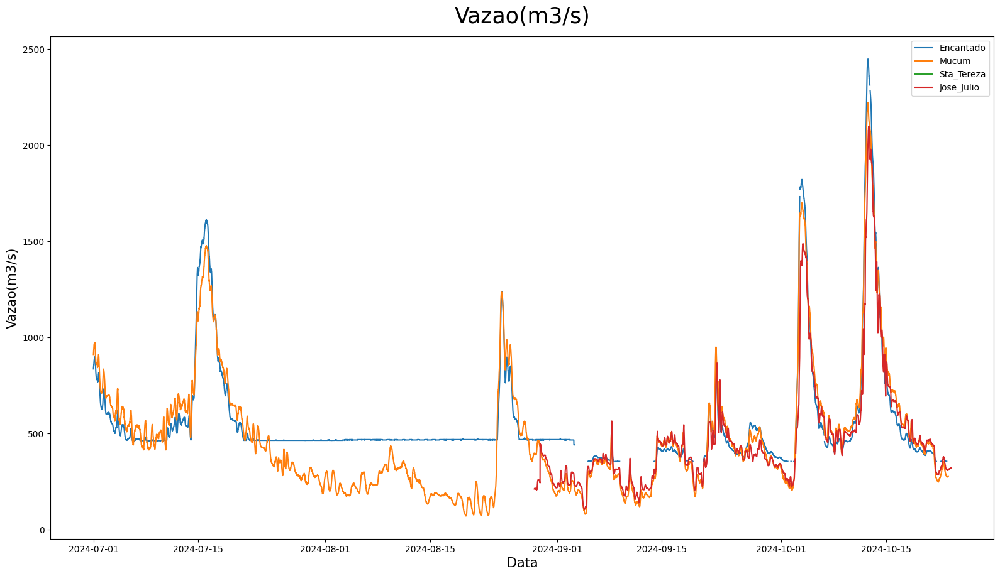

In [113]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Fazendo correção nos graficos da vazao

Nos graficos há medidas constantes não refletindo na realidade, provavelmente falha no medidor
- Vamos remover estes valores

In [114]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-06-26')
data_final = pd.to_datetime('2023-7-11')
# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

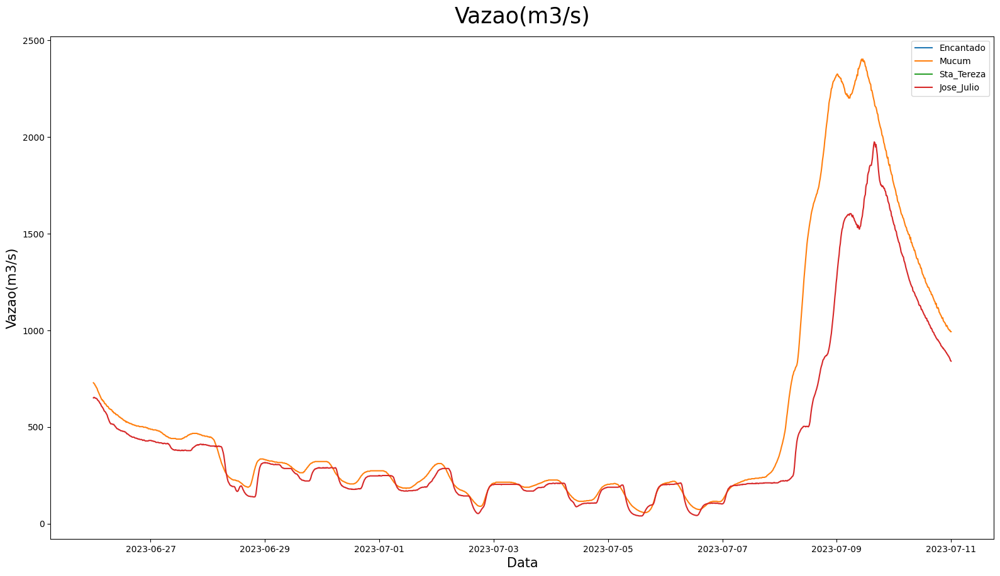

In [115]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-06-26')
data_fim = pd.to_datetime('2023-7-11')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [116]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-23')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Jose_Julio_unico.loc[(df_Jose_Julio_unico['Data/Hora'] >= data_inicial) &
                        (df_Jose_Julio_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

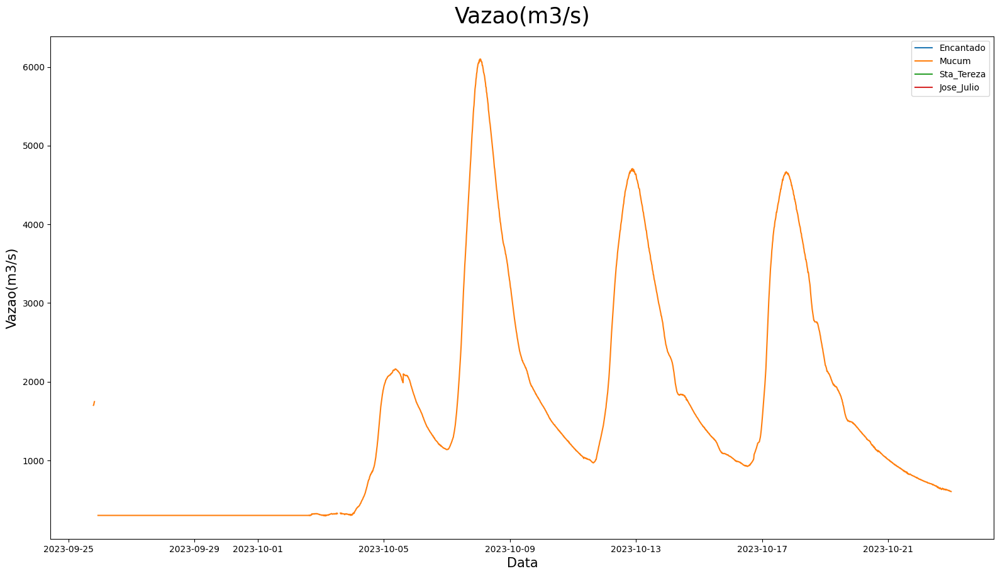

In [117]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-23')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [118]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-09-25 19:00')
data_final = pd.to_datetime('2023-10-2 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Mucum_unico.loc[(df_Mucum_unico['Data/Hora'] >= data_inicial) &
                        (df_Mucum_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

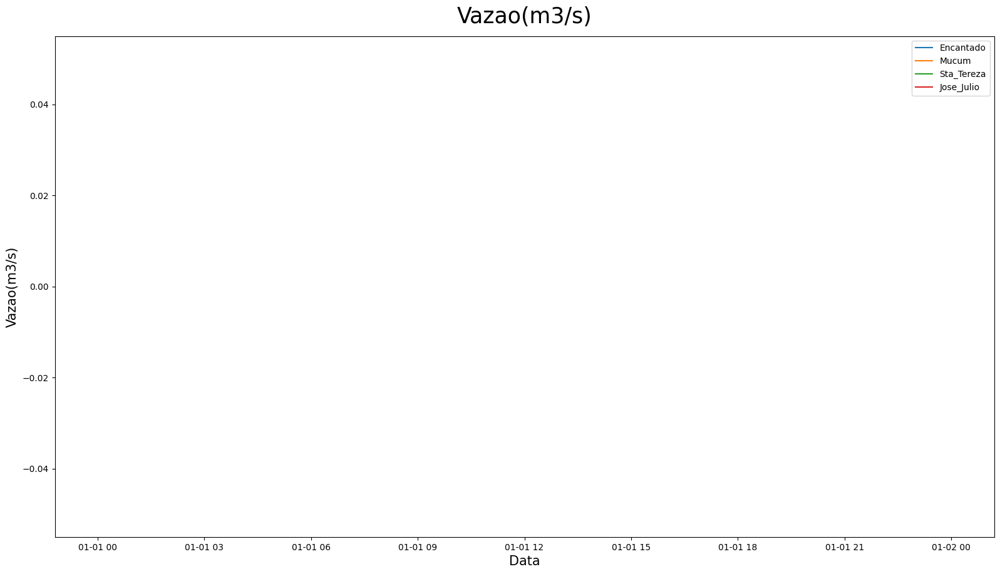

In [119]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-25 19:00')
data_fim = pd.to_datetime('2023-10-2 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [120]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-11-3 20:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Sta_Tereza_unico.loc[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicial) &
                        (df_Sta_Tereza_unico['Data/Hora'] <= data_final),
                        'Nivel(cm)'] = np.nan

In [121]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-10-20 22:00')
data_final = pd.to_datetime('2023-10-31 16:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

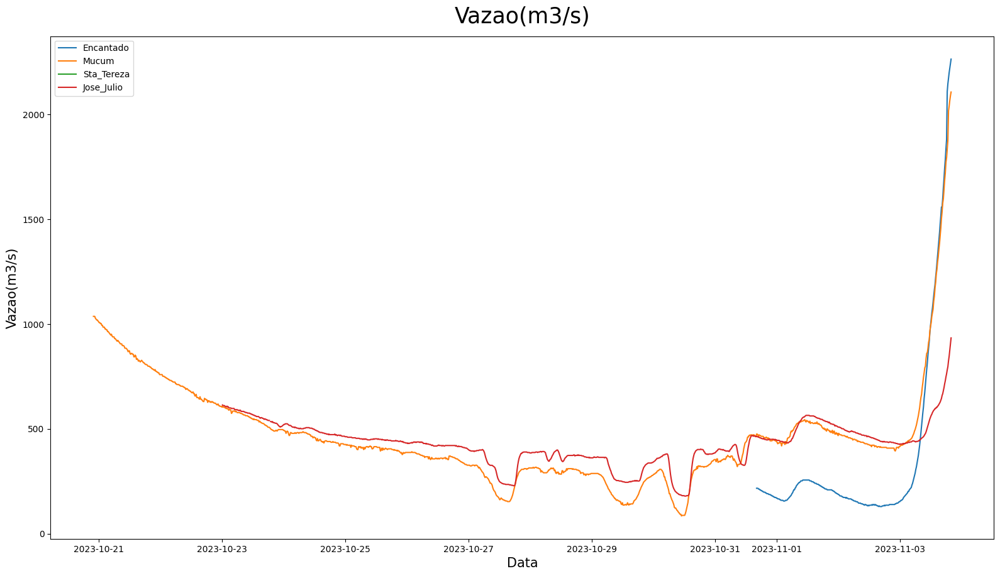

In [122]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-20 22:00')
data_fim = pd.to_datetime('2023-11-3 20:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

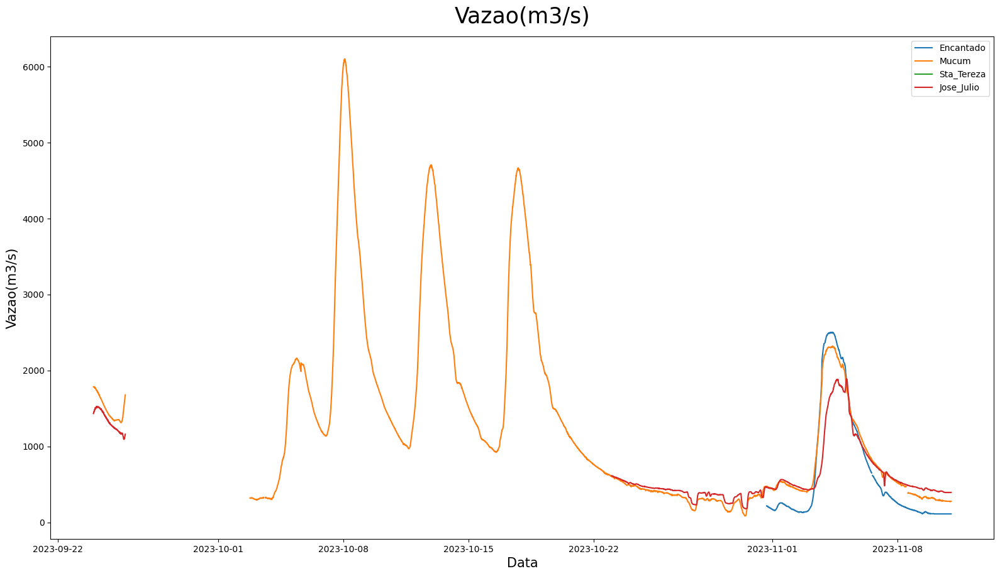

In [123]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-09-24')
data_fim = pd.to_datetime('2023-11-11')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [124]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2023-12-11 12:00')
data_final = pd.to_datetime('2024-1-18 15:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

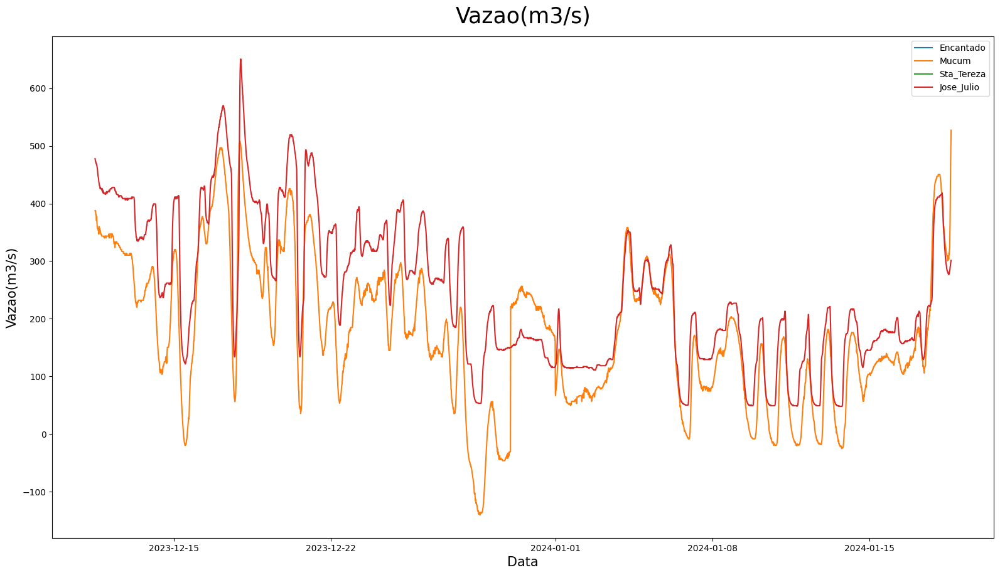

In [125]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-1-18 15:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [126]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-1-26 12:00')
data_final = pd.to_datetime('2024-2-27 18:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

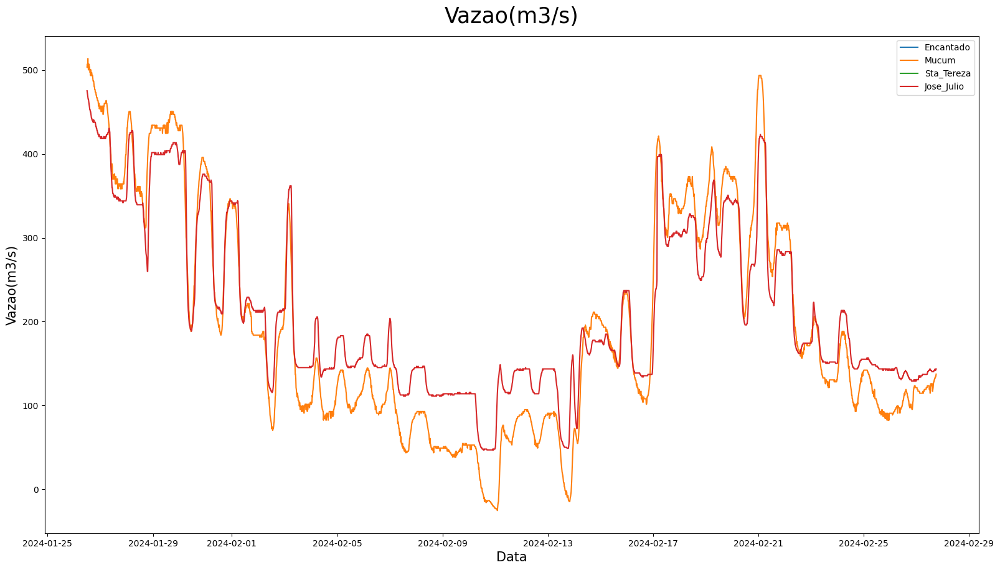

In [127]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-1-26 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

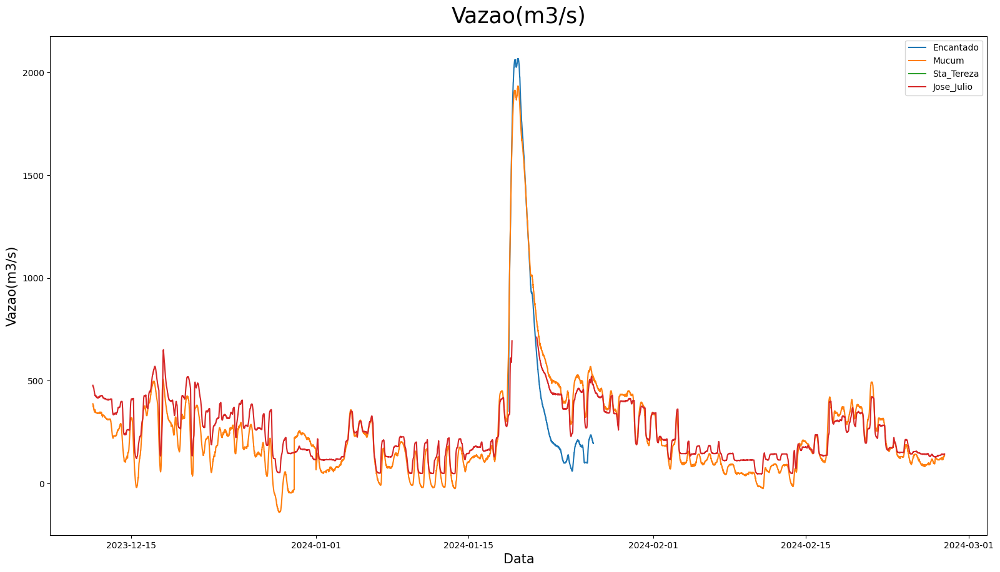

In [128]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-11 12:00')
data_fim = pd.to_datetime('2024-2-27 18:00')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [129]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-05-1')
data_final = pd.to_datetime('2024-6-1')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

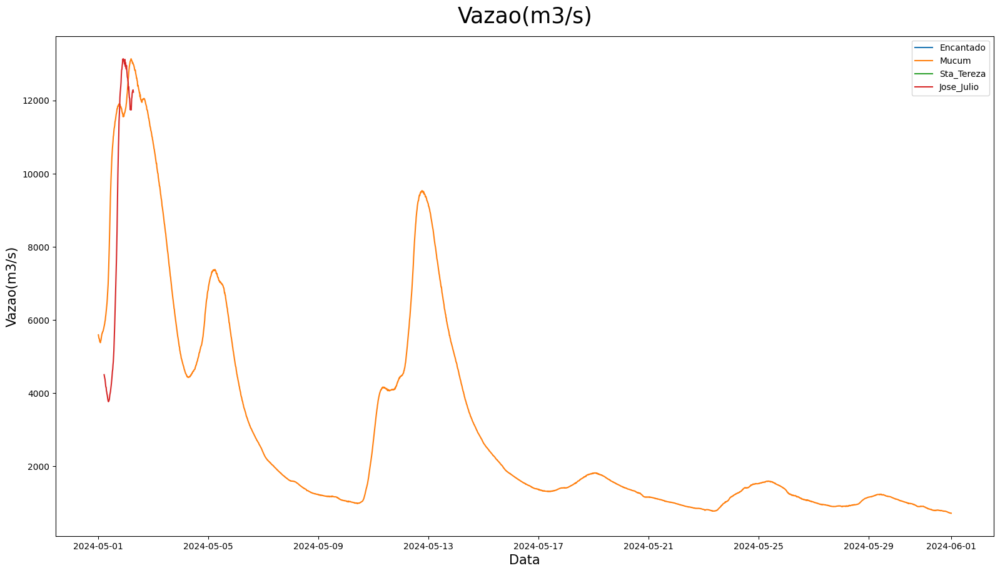

In [130]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-05-1')
data_fim = pd.to_datetime('2024-6-1')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

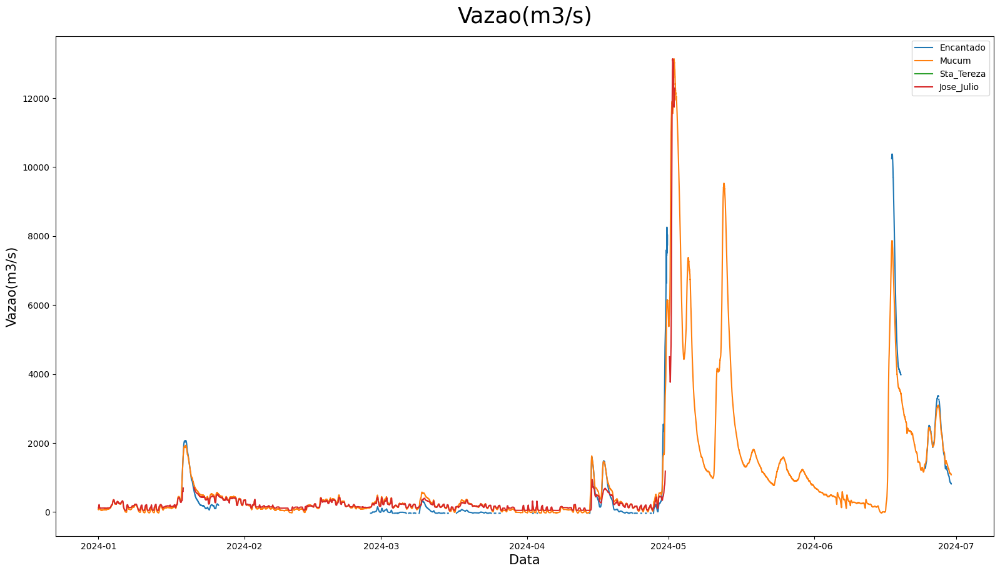

In [131]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-01-1')
data_fim = pd.to_datetime('2024-6-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [132]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-07-22')
data_final = pd.to_datetime('2024-08-23 23:00')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

In [133]:
# Definir intervalo de data
data_inicial = pd.to_datetime('2024-8-27')
data_final = pd.to_datetime('2024-9-5')

# Defina os valores como nulos para as linhas dentro do intervalo especificado
df_Encantado_unico.loc[(df_Encantado_unico['Data/Hora'] >= data_inicial) &
                        (df_Encantado_unico['Data/Hora'] <= data_final),
                        'Vazao(m3/s)'] = np.nan

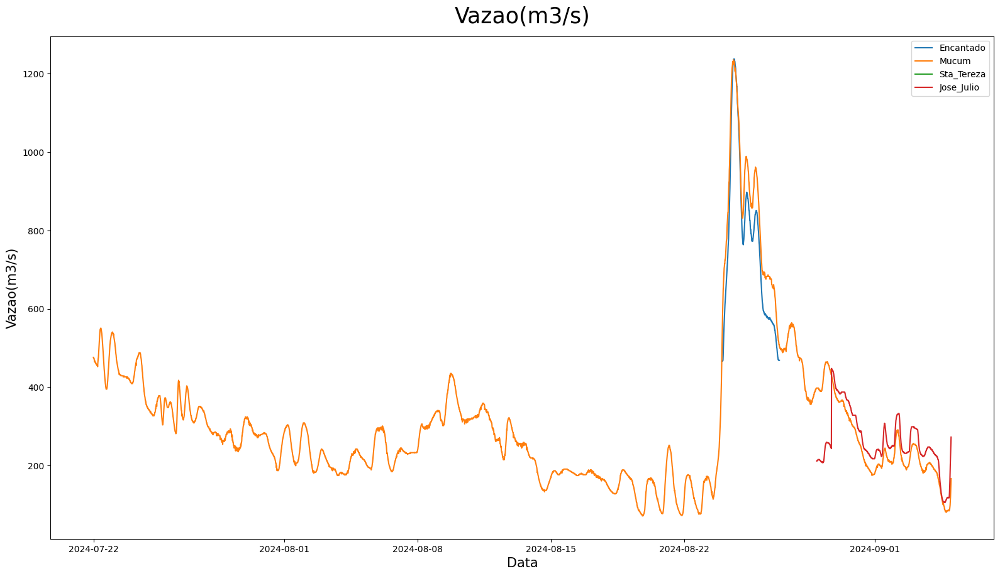

In [134]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-22')
data_fim = pd.to_datetime('2024-9-5')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

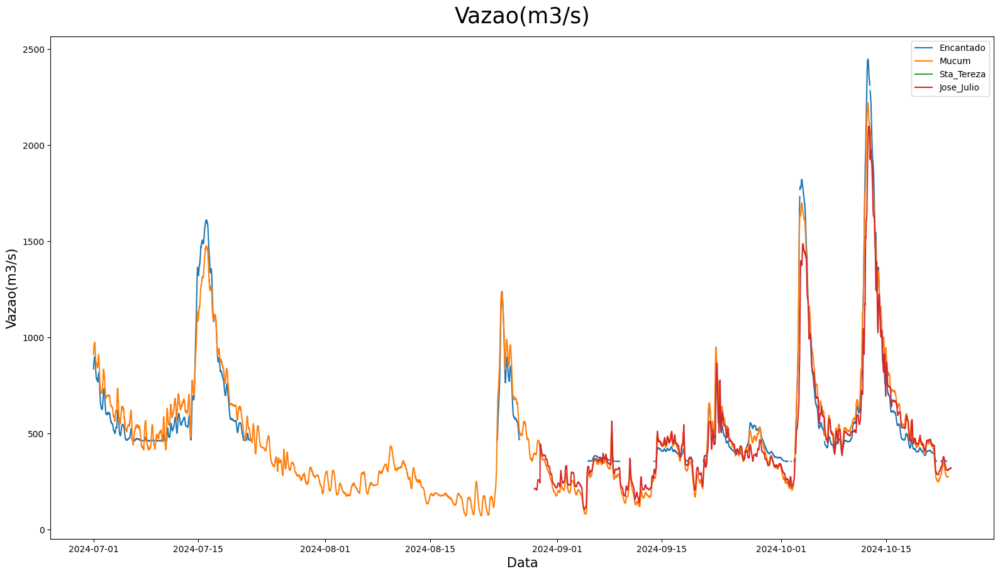

In [135]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Grafico pós tratamento de Vasão

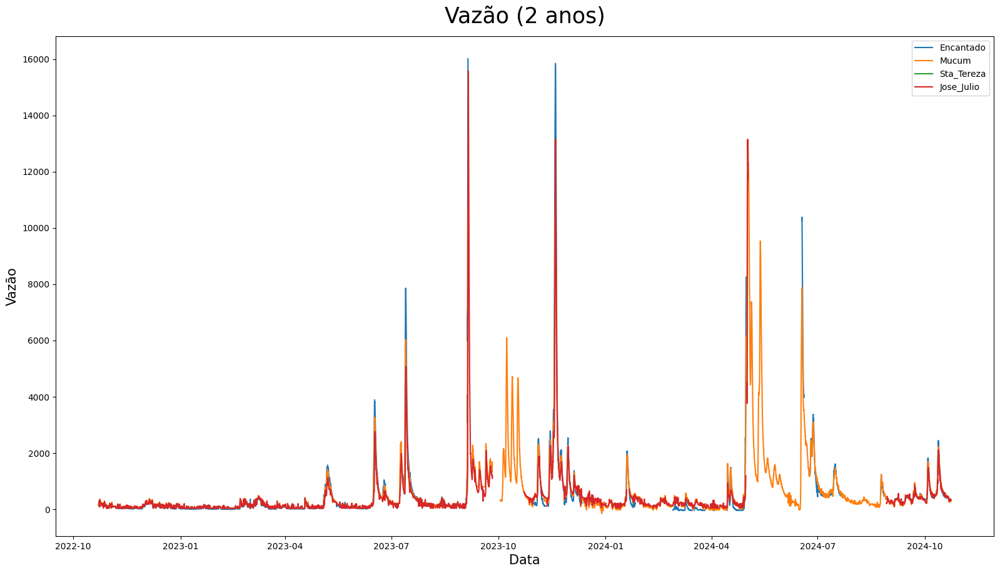

In [136]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-10-17')
data_fim = pd.to_datetime('2024-12-21')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão (2 anos)', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

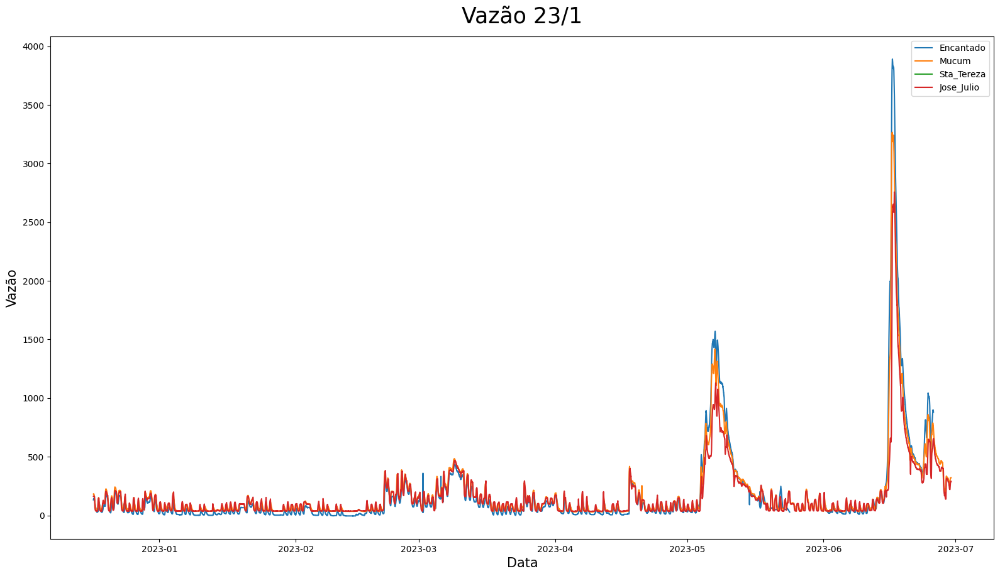

In [137]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-12-17')
data_fim = pd.to_datetime('2023-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

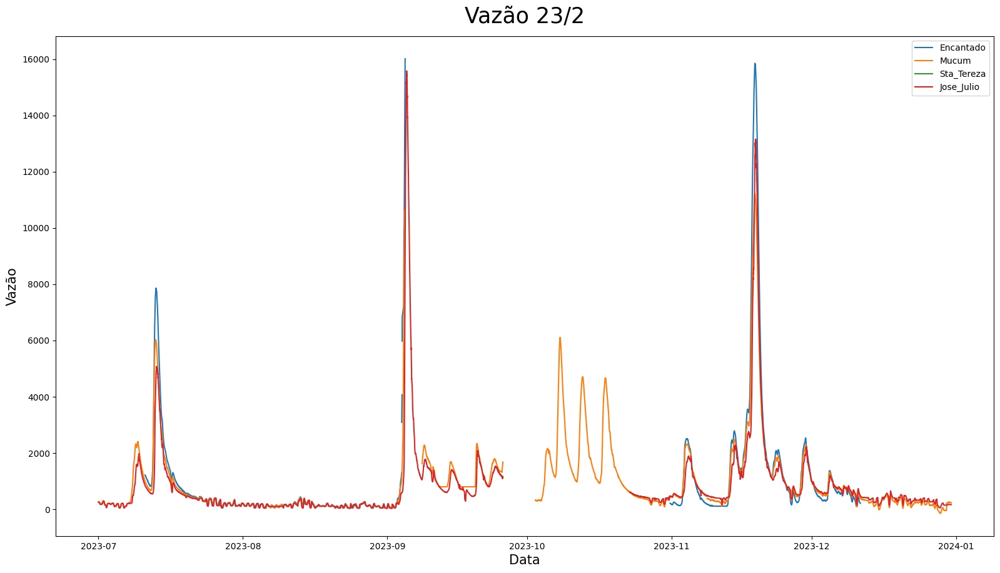

In [138]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-7-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 23/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

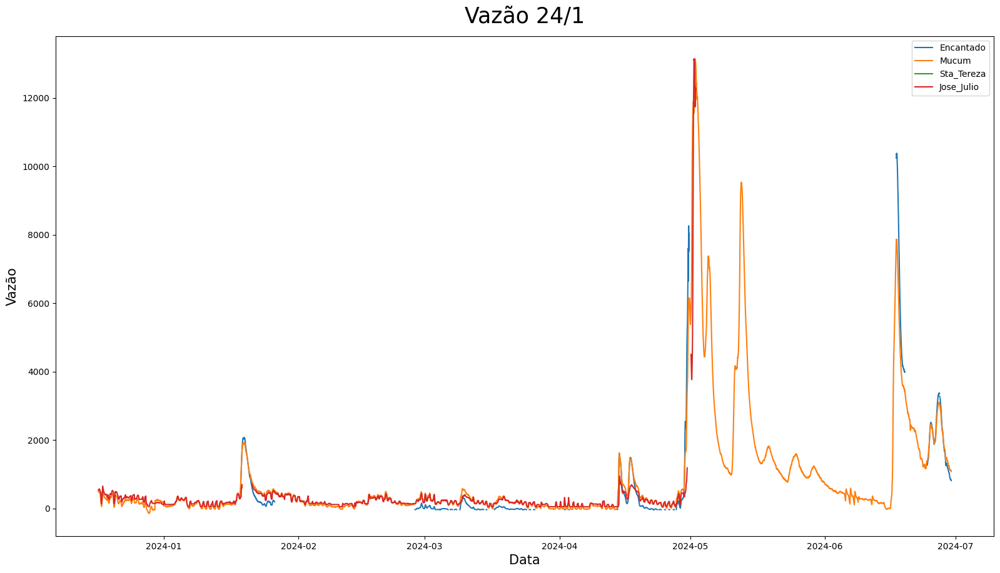

In [139]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-06-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/1', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

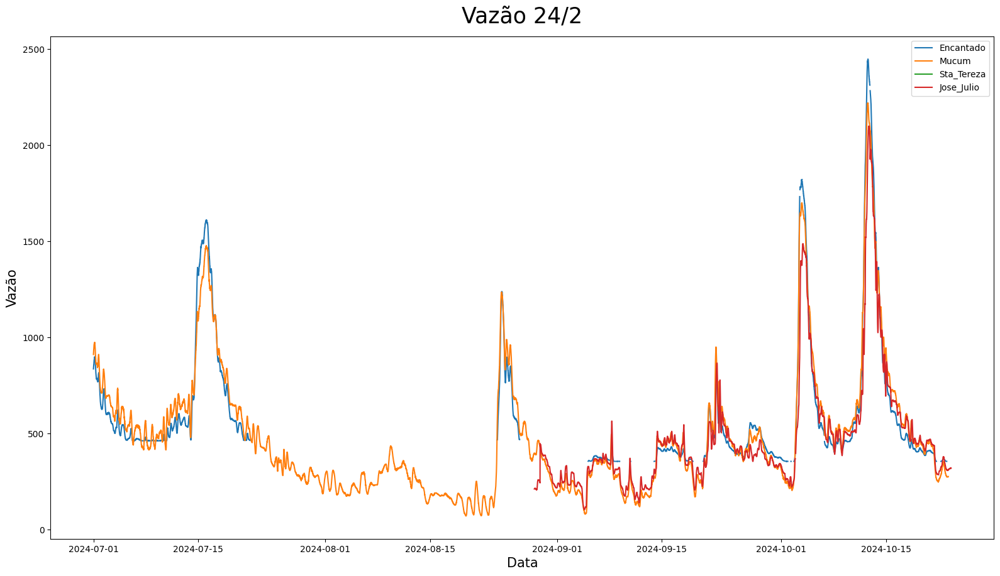

In [140]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2024-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Vazão 24/2', 'Data', 'Vazão', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

## Media do Vazao

- Pegando os quatro graficos famos fazer uma media dos valores do nivel da agua
- Utulizaremos esta media para preencher os valores nulos dos do nivel da agua

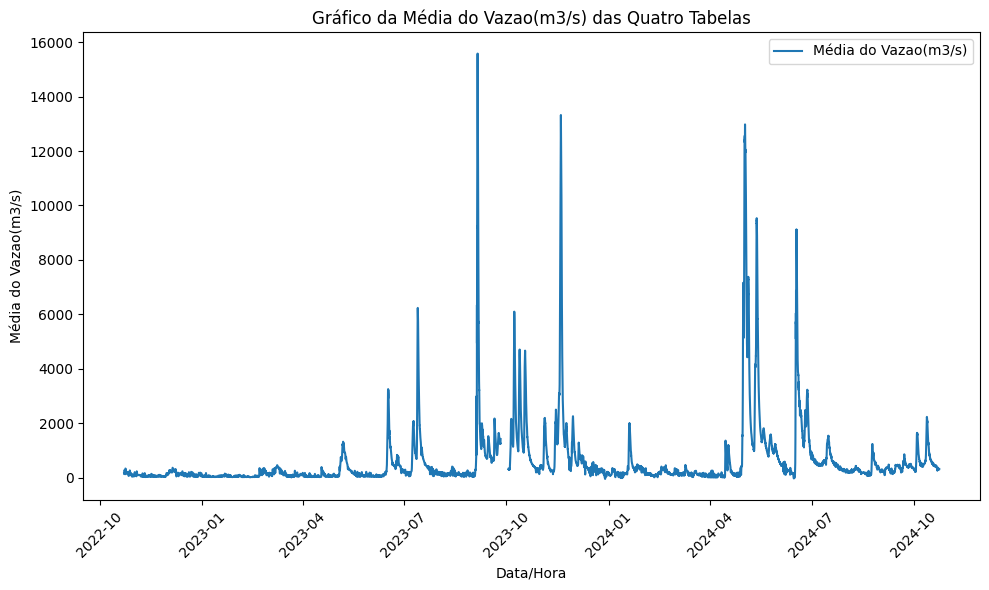

In [141]:
# Selecione apenas as colunas 'Data/Hora' e 'Vazao(m3/s)' de cada tabela
df1 = df_Encantado_unico[['Data/Hora', 'Vazao(m3/s)']]
df2 = df_Mucum_unico[['Data/Hora', 'Vazao(m3/s)']]
df3 = df_Sta_Tereza_unico[['Data/Hora', 'Vazao(m3/s)']]
df4 = df_Jose_Julio_unico[['Data/Hora', 'Vazao(m3/s)']]

# Renomeie a coluna 'Vazao(m3/s)' em cada DataFrame para identificá-los após o merge
df1 = df1.rename(columns={'Vazao(m3/s)': 'Vazao_1'})
df2 = df2.rename(columns={'Vazao(m3/s)': 'Vazao_2'})
df3 = df3.rename(columns={'Vazao(m3/s)': 'Vazao_3'})
df4 = df4.rename(columns={'Vazao(m3/s)': 'Vazao_4'})

# Combine as tabelas com base na coluna 'Data/Hora'
df_merged = pd.merge(df1, df2, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df3, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df4, on='Data/Hora', how='outer')

# Calcule a média dos valores de 'Vazao(m3/s)' ignorando valores nulos
df_merged['Vazao(m3/s)'] = df_merged[['Vazao_1', 'Vazao_2', 'Vazao_3', 'Vazao_4']].mean(axis=1)

# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Vazao(m3/s)'], label='Média do Vazao(m3/s)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Vazao(m3/s)')
plt.title('Gráfico da Média do Vazao(m3/s) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [142]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao_1      41891 non-null  float64       
 2   Vazao_2      68861 non-null  float64       
 3   Vazao_3      0 non-null      float64       
 4   Vazao_4      55363 non-null  float64       
 5   Vazao(m3/s)  69548 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


In [143]:
df_merged.head()

,Data/Hora,Vazao_1,Vazao_2,Vazao_3,Vazao_4,Vazao(m3/s)
0,2022-10-22 15:15:00,162.6,NaN,NaN,NaN,162.60
1,2022-10-22 15:30:00,155.8,136.4,NaN,NaN,146.10
2,2022-10-22 15:45:00,152.5,134.6,NaN,NaN,143.55
3,2022-10-22 16:00:00,145.8,132.9,NaN,NaN,139.35
4,2022-10-22 16:15:00,142.5,131.1,NaN,NaN,136.80


In [144]:
df_merged.tail()

,Data/Hora,Vazao_1,Vazao_2,Vazao_3,Vazao_4,Vazao(m3/s)
69989,2024-10-23 15:30:00,NaN,NaN,NaN,319.34,319.34
69990,2024-10-23 15:45:00,NaN,NaN,NaN,319.34,319.34
69991,2024-10-23 16:00:00,NaN,NaN,NaN,319.34,319.34
69992,2024-10-23 16:15:00,NaN,NaN,NaN,319.34,319.34
69993,2024-10-23 16:30:00,NaN,NaN,NaN,319.34,319.34


Grafico da 4 cidades com valores nulos

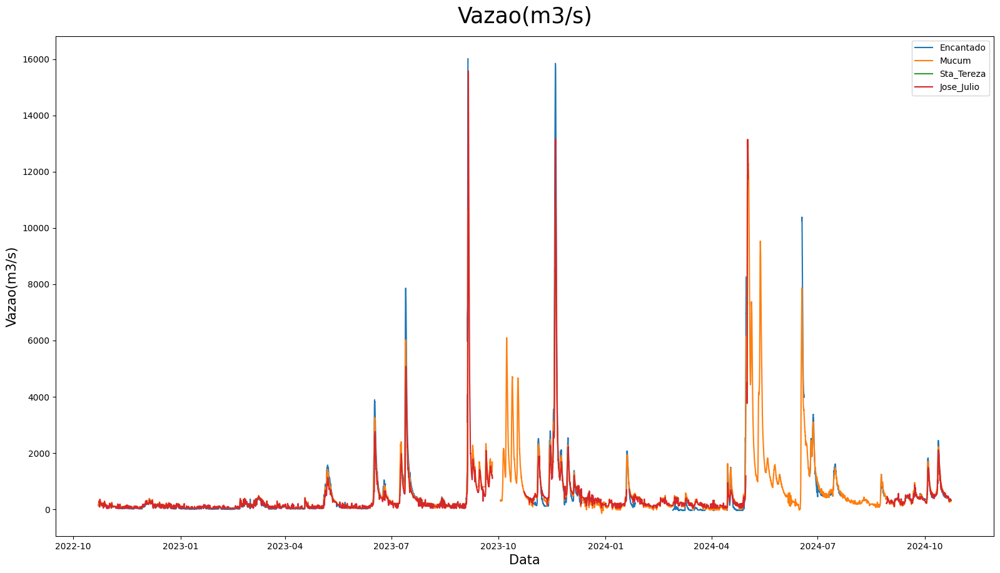

In [145]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Remover valores que usamos para media deixando apenas o que iremos utilizar

In [146]:
# Excluir as colunas Vazao_1, Vazao_2, Vazao_3 e Vazao_4
df_merged = df_merged.drop(columns=['Vazao_1', 'Vazao_2', 'Vazao_3', 'Vazao_4'])

# Exibir informações do DataFrame após a exclusão
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao(m3/s)  69548 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Interpolar os valores que faltaram pois em um pequeno intervalo de tempo as 4 estaçoes estavam inoperantes

In [147]:
# Interpolar os valores nulos na coluna 'Vazao(m3/s)'
df_merged['Vazao(m3/s)'] = df_merged['Vazao(m3/s)'].interpolate()

# Remover todas as linhas que contenham valores nulos
#df_merged = df_merged.dropna()

# Exibir informações do DataFrame após a interpolação e remoção
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Grafico da média do Nivel da agua das 4 estaçoes

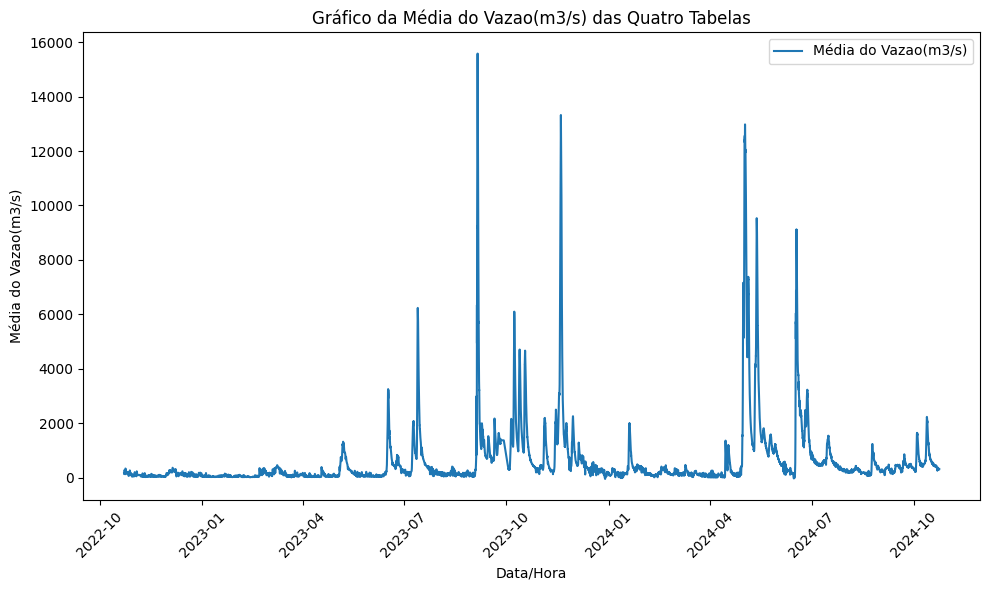

In [148]:
# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Vazao(m3/s)'], label='Média do Vazao(m3/s)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Vazao(m3/s)')
plt.title('Gráfico da Média do Vazao(m3/s) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [149]:
def plotar_matplot(titulo, labelx, labely, x, y, dataset):
  fig = plt.figure(figsize=(15,8))
  eixo = fig.add_axes([0,0,1,1])
  eixo.plot(x, y, data = dataset, marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)
  eixo = eixo

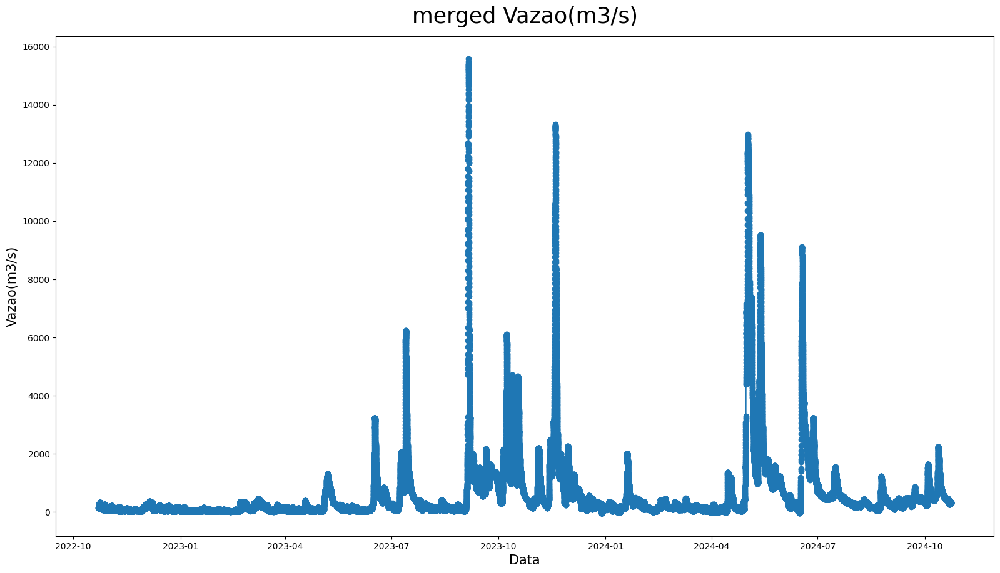

In [150]:
plotar_matplot('merged Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_merged)

Grafico de uma das estaçoes para comparação posterior

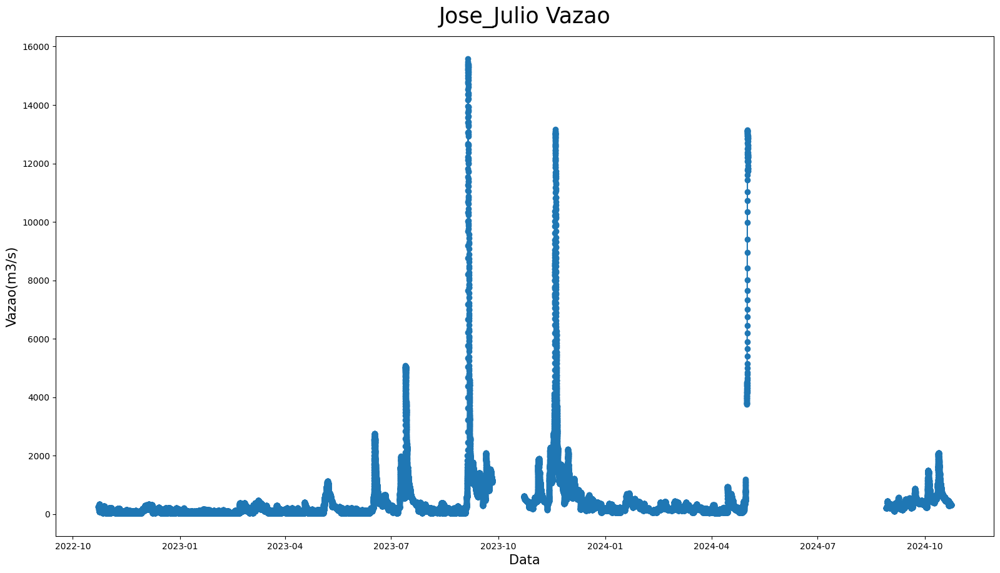

In [151]:
plotar_matplot('Jose_Julio Vazao', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_Jose_Julio_unico)

Foi notado que alem de valores nulos há datas faltantes no intervalo de tempo de 2 anos
- Necessario criar linhas de datas faltantes

In [152]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Encantado_unico
df_Encantado_unico = pd.merge(df_todas_as_datas, df_Encantado_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)


In [153]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Mucum_unico
df_Mucum_unico = pd.merge(df_todas_as_datas, df_Mucum_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)


In [154]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Sta_Tereza_unico
df_Sta_Tereza_unico = pd.merge(df_todas_as_datas, df_Sta_Tereza_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)



In [155]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Jose_Julio_unico
df_Jose_Julio_unico = pd.merge(df_todas_as_datas, df_Jose_Julio_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Vazao(m3/s)' com base em df_merged
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].fillna(
    df_merged.set_index('Data/Hora')['Vazao(m3/s)']
)



Para os valores de Nivel faltantes (Nulos), foram preenchidos com o valor medio do nivel da agua das estaçoes restantes

In [156]:
# Para cada tabela, preencha os valores nulos em 'Vazao(m3/s)' com base na tabela df_merged
for tabela in [df_Encantado_unico,df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico]:
    # Realizar o merge com base na coluna 'Data/Hora'
    tabela_merged = pd.merge(tabela, df_merged[['Data/Hora', 'Vazao(m3/s)']], on='Data/Hora', how='left', suffixes=('', '_from_merged'))

    # Preencher os valores nulos na coluna 'Vazao(m3/s)' com os valores da coluna 'Vazao(m3/s)' da tabela df_merged
    tabela['Vazao(m3/s)'] = tabela_merged['Vazao(m3/s)'].fillna(tabela_merged['Vazao(m3/s)_from_merged'])

In [157]:
# Verificar quais linhas têm valores nulos na coluna 'Vazao(m3/s)' de df_Jose_Julio_unico
mask_nulos = df_Jose_Julio_unico['Vazao(m3/s)'].isnull()

# Para cada data onde 'Vazao(m3/s)' é nulo, buscar o valor correspondente em df_merged
for index, row in df_Jose_Julio_unico[mask_nulos].iterrows():
    data = row['Data/Hora']
    # Verificar se a data existe em df_merged
    valor_novo = df_merged.loc[df_merged['Data/Hora'] == data, 'Vazao(m3/s)']

    if not valor_novo.empty:
        # Substituir o valor nulo pela nova informação
        df_Jose_Julio_unico.at[index, 'Vazao(m3/s)'] = valor_novo.values[0]

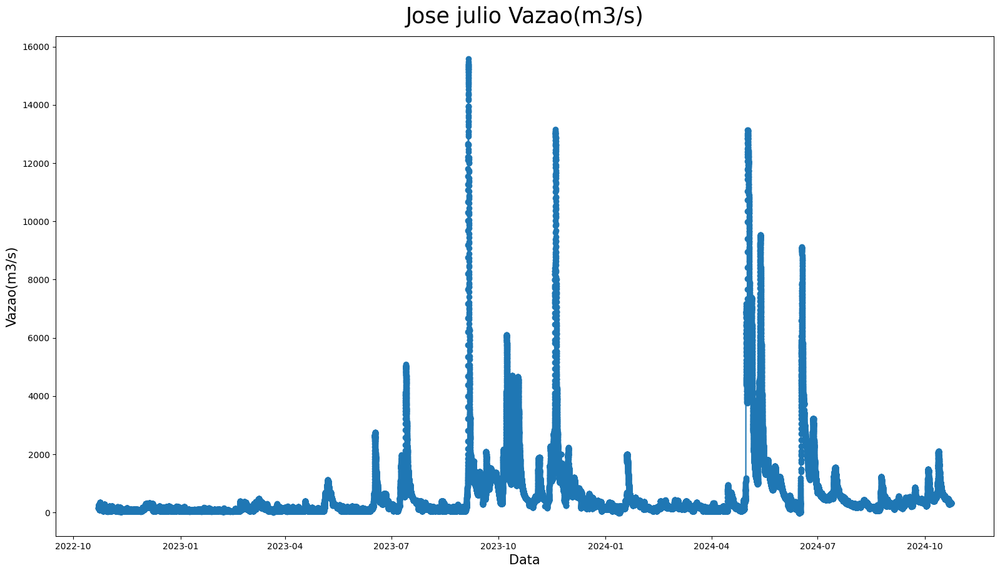

In [158]:
plotar_matplot('Jose julio Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)', df_Jose_Julio_unico)

Grafico das 4 estaçoes com o nivel da agua sem nenhum valor nulo

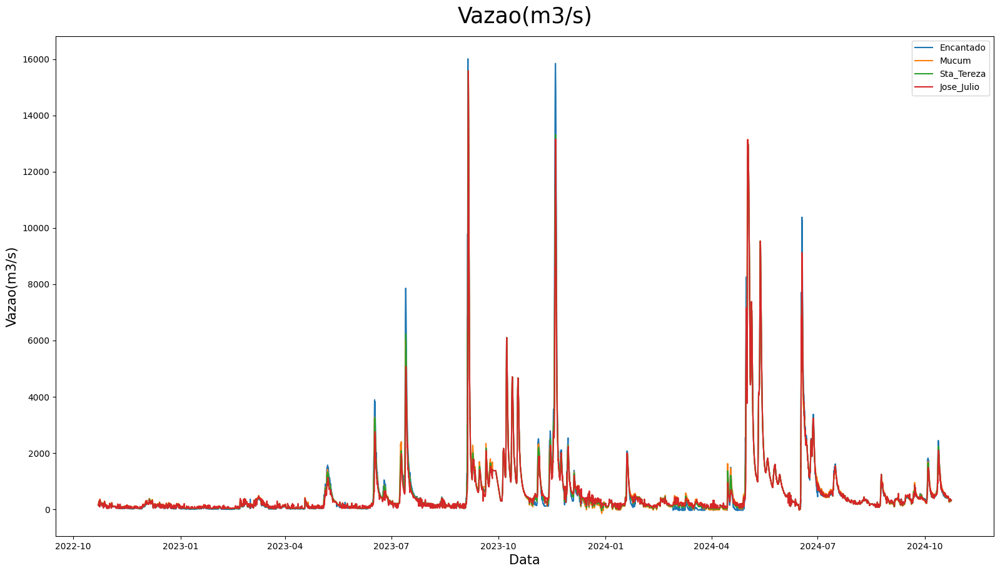

In [159]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Vazao(m3/s)', 'Data', 'Vazao(m3/s)', 'Data/Hora', 'Vazao(m3/s)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

As datas faltantes nos intervalos possuem os Niveis preenchidos pela media mas os valores da chuva e vazão são nulos pois não tinha dados neste intervalo

In [160]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    64782 non-null  float64       
 2   Nivel(cm)    44877 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [161]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    69365 non-null  float64       
 2   Nivel(cm)    68861 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [162]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    36971 non-null  float64       
 2   Nivel(cm)    35177 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [163]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    67257 non-null  float64       
 2   Nivel(cm)    55363 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


* deslocamento original de vazao

In [164]:
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'] + 35
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'] - 0
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'] - 5

## Media do Nivel da agua

- Pegando os quatro graficos famos fazer uma media dos valores do nivel da agua
- Utulizaremos esta media para preencher os valores nulos dos do nivel da agua

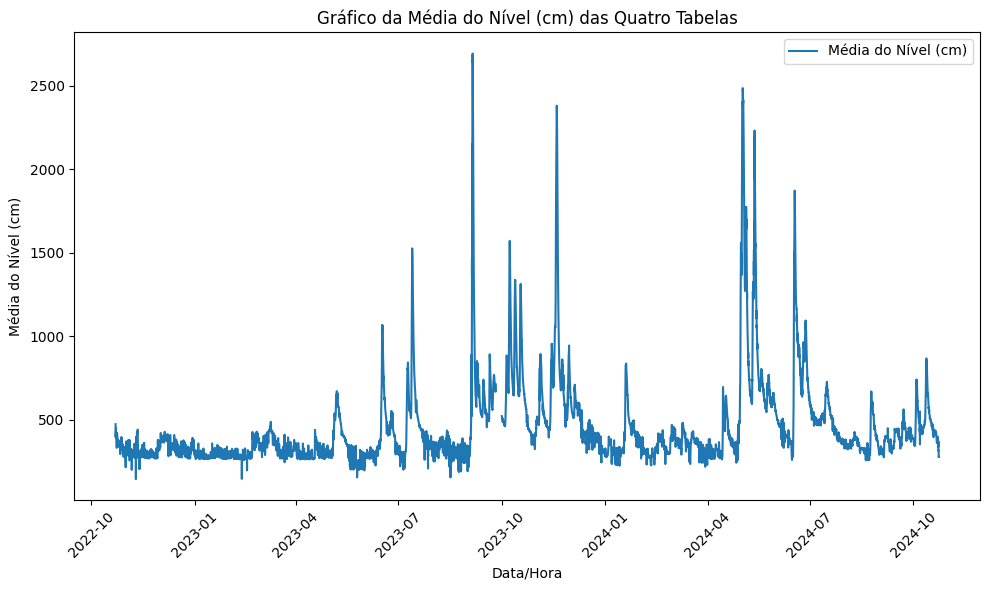

In [165]:
# Selecione apenas as colunas 'Data/Hora' e 'Nivel(cm)' de cada tabela
df1 = df_Encantado_unico[['Data/Hora', 'Nivel(cm)']]
df2 = df_Mucum_unico[['Data/Hora', 'Nivel(cm)']]
df3 = df_Sta_Tereza_unico[['Data/Hora', 'Nivel(cm)']]
df4 = df_Jose_Julio_unico[['Data/Hora', 'Nivel(cm)']]

# Renomeie a coluna 'Nivel(cm)' em cada DataFrame para identificá-los após o merge
df1 = df1.rename(columns={'Nivel(cm)': 'Nivel_1'})
df2 = df2.rename(columns={'Nivel(cm)': 'Nivel_2'})
df3 = df3.rename(columns={'Nivel(cm)': 'Nivel_3'})
df4 = df4.rename(columns={'Nivel(cm)': 'Nivel_4'})

# Combine as tabelas com base na coluna 'Data/Hora'
df_merged = pd.merge(df1, df2, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df3, on='Data/Hora', how='outer')
df_merged = pd.merge(df_merged, df4, on='Data/Hora', how='outer')

# Calcule a média dos valores de 'Nivel(cm)' ignorando valores nulos
df_merged['Nivel(cm)'] = df_merged[['Nivel_1', 'Nivel_2', 'Nivel_3', 'Nivel_4']].mean(axis=1)

# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Nivel(cm)'], label='Média do Nível (cm)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Nível (cm)')
plt.title('Gráfico da Média do Nível (cm) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [166]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel_1    44877 non-null  float64       
 2   Nivel_2    68861 non-null  float64       
 3   Nivel_3    35177 non-null  float64       
 4   Nivel_4    55363 non-null  float64       
 5   Nivel(cm)  69726 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


In [167]:
df_merged.head()

,Data/Hora,Nivel_1,Nivel_2,Nivel_3,Nivel_4,Nivel(cm)
0,2022-10-22 15:15:00,473.0,NaN,NaN,NaN,473.0
1,2022-10-22 15:30:00,471.0,327.0,NaN,NaN,399.0
2,2022-10-22 15:45:00,470.0,326.0,NaN,NaN,398.0
3,2022-10-22 16:00:00,468.0,325.0,NaN,NaN,396.5
4,2022-10-22 16:15:00,467.0,324.0,NaN,NaN,395.5


In [168]:
df_merged.tail()

,Data/Hora,Nivel_1,Nivel_2,Nivel_3,Nivel_4,Nivel(cm)
69989,2024-10-23 15:30:00,NaN,NaN,NaN,278.0,278.0
69990,2024-10-23 15:45:00,NaN,NaN,NaN,278.0,278.0
69991,2024-10-23 16:00:00,NaN,NaN,NaN,278.0,278.0
69992,2024-10-23 16:15:00,NaN,NaN,NaN,278.0,278.0
69993,2024-10-23 16:30:00,NaN,NaN,NaN,278.0,278.0


Grafico da 4 cidades com valores nulos

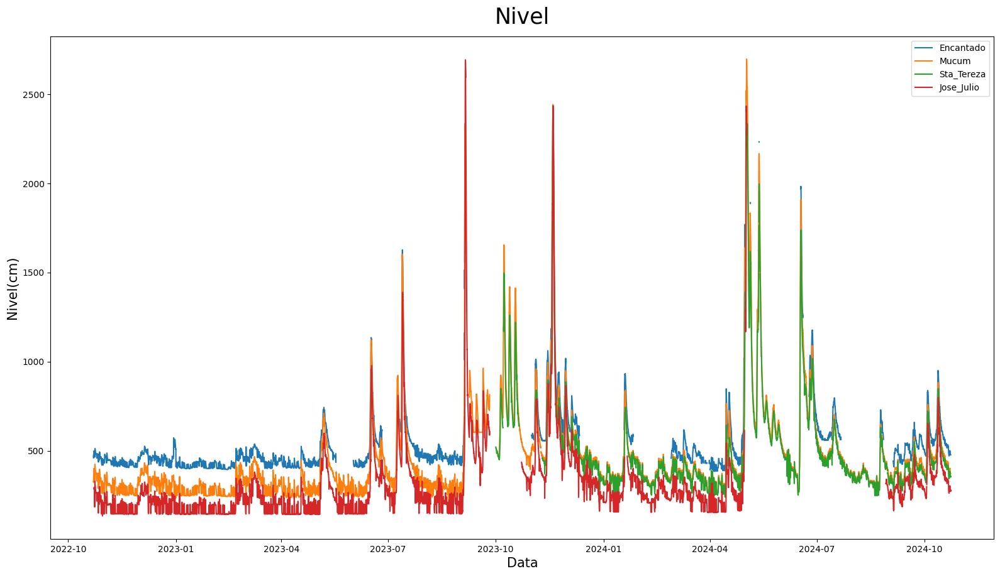

In [169]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [170]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel_1    44877 non-null  float64       
 2   Nivel_2    68861 non-null  float64       
 3   Nivel_3    35177 non-null  float64       
 4   Nivel_4    55363 non-null  float64       
 5   Nivel(cm)  69726 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 3.2 MB


Remover valores que usamos para media deixando apenas o que iremos utilizar

In [171]:
# Excluir as colunas Nivel_1, Nivel_2, Nivel_3 e Nivel_4
df_merged = df_merged.drop(columns=['Nivel_1', 'Nivel_2', 'Nivel_3', 'Nivel_4'])

# Exibir informações do DataFrame após a exclusão
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel(cm)  69726 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Interpolar os valores que faltaram pois em um pequeno intervalo de tempo as 4 estaçoes estavam inoperantes

In [172]:
# Interpolar os valores nulos na coluna 'Nivel(cm)'
df_merged['Nivel(cm)'] = df_merged['Nivel(cm)'].interpolate()

# Remover todas as linhas que contenham valores nulos
df_merged = df_merged.dropna()

# Exibir informações do DataFrame após a interpolação e remoção
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Data/Hora  69994 non-null  datetime64[ns]
 1   Nivel(cm)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 1.1 MB


Grafico da média do Nivel da agua das 4 estaçoes

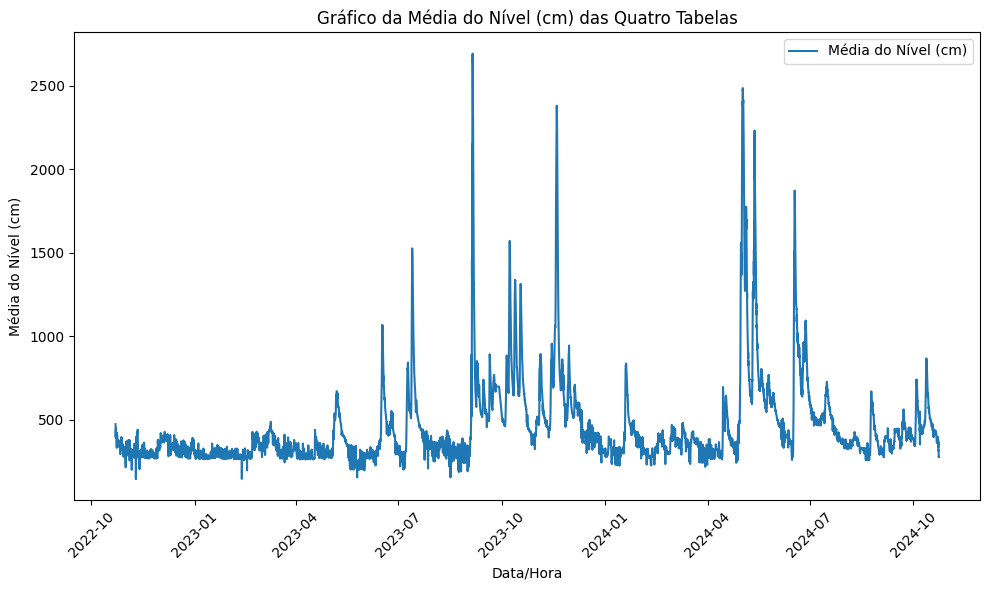

In [173]:
# Plote o gráfico da média
plt.figure(figsize=(10, 6))
plt.plot(df_merged['Data/Hora'], df_merged['Nivel(cm)'], label='Média do Nível (cm)')
plt.xlabel('Data/Hora')
plt.ylabel('Média do Nível (cm)')
plt.title('Gráfico da Média do Nível (cm) das Quatro Tabelas')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [174]:
def plotar_matplot(titulo, labelx, labely, x, y, dataset):
  fig = plt.figure(figsize=(15,8))
  eixo = fig.add_axes([0,0,1,1])
  eixo.plot(x, y, data = dataset, marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)
  eixo = eixo

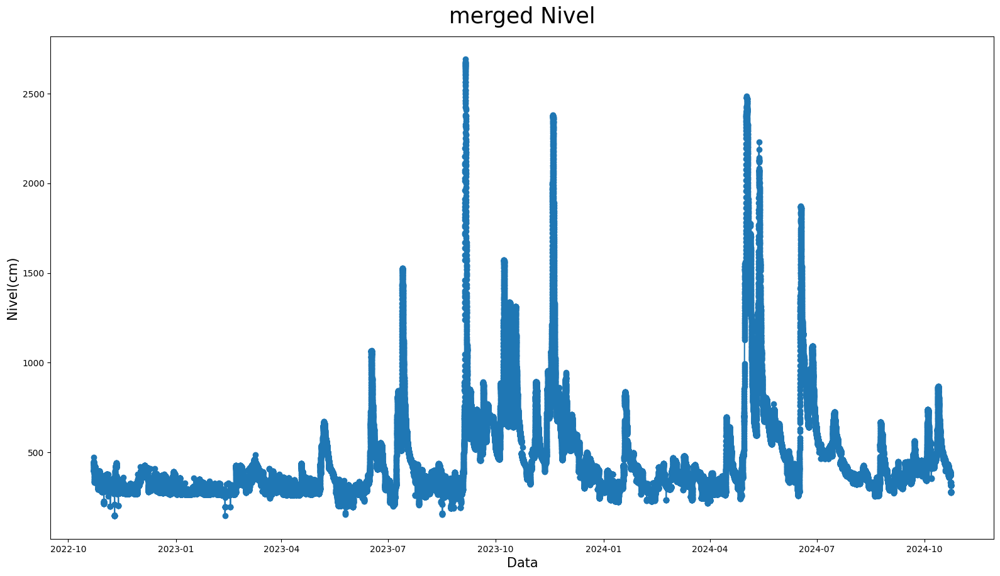

In [175]:
plotar_matplot('merged Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_merged)

Grafico de uma das estaçoes para comparação posterior

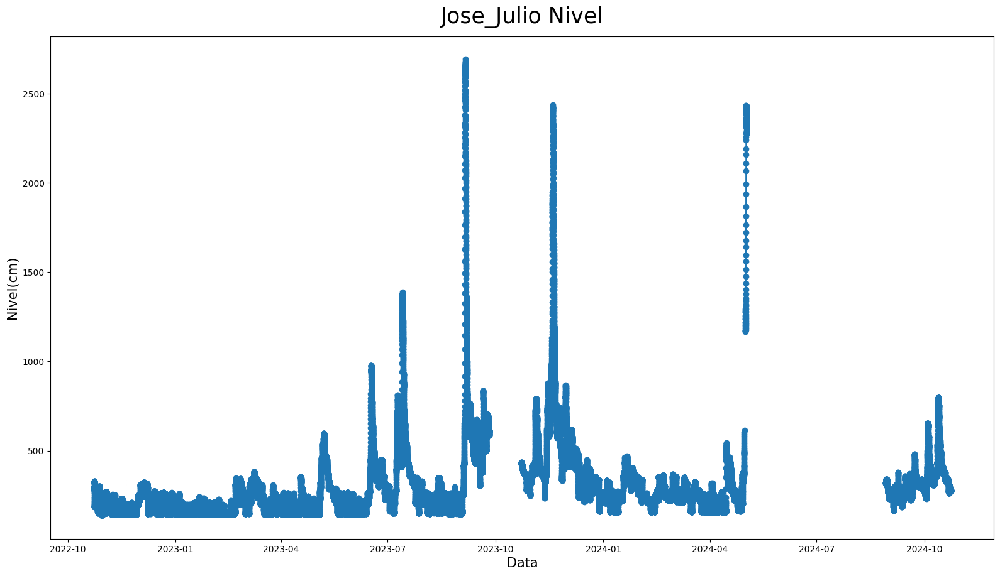

In [176]:
plotar_matplot('Jose_Julio Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico)

Foi notado que alem de valores nulos há datas faltantes no intervalo de tempo de 2 anos
- Necessario criar linhas de datas faltantes

In [177]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Encantado_unico
df_Encantado_unico = pd.merge(df_todas_as_datas, df_Encantado_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)


In [178]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Mucum_unico
df_Mucum_unico = pd.merge(df_todas_as_datas, df_Mucum_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)


In [179]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Sta_Tereza_unico
df_Sta_Tereza_unico = pd.merge(df_todas_as_datas, df_Sta_Tereza_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)



In [180]:
# Criar um DataFrame com todas as datas de df_merged
df_todas_as_datas = pd.DataFrame({'Data/Hora': df_merged['Data/Hora'].unique()})

# Realizar o merge entre df_todas_as_datas e df_Jose_Julio_unico
df_Jose_Julio_unico = pd.merge(df_todas_as_datas, df_Jose_Julio_unico, on='Data/Hora', how='left')

# Preencher os valores da coluna 'Nivel(cm)' com base em df_merged
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'].fillna(
    df_merged.set_index('Data/Hora')['Nivel(cm)']
)



Para os valores de Nivel faltantes (Nulos), foram preenchidos com o valor medio do nivel da agua das estaçoes restantes

In [181]:
# Para cada tabela, preencha os valores nulos em 'Nivel(cm)' com base na tabela df_merged
for tabela in [df_Encantado_unico,df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico]:
    # Realizar o merge com base na coluna 'Data/Hora'
    tabela_merged = pd.merge(tabela, df_merged[['Data/Hora', 'Nivel(cm)']], on='Data/Hora', how='left', suffixes=('', '_from_merged'))

    # Preencher os valores nulos na coluna 'Nivel(cm)' com os valores da coluna 'Nivel(cm)' da tabela df_merged
    tabela['Nivel(cm)'] = tabela_merged['Nivel(cm)'].fillna(tabela_merged['Nivel(cm)_from_merged'])

In [182]:
# Verificar quais linhas têm valores nulos na coluna 'Nivel(cm)' de df_Jose_Julio_unico
mask_nulos = df_Jose_Julio_unico['Nivel(cm)'].isnull()

# Para cada data onde 'Nivel(cm)' é nulo, buscar o valor correspondente em df_merged
for index, row in df_Jose_Julio_unico[mask_nulos].iterrows():
    data = row['Data/Hora']
    # Verificar se a data existe em df_merged
    valor_novo = df_merged.loc[df_merged['Data/Hora'] == data, 'Nivel(cm)']

    if not valor_novo.empty:
        # Substituir o valor nulo pela nova informação
        df_Jose_Julio_unico.at[index, 'Nivel(cm)'] = valor_novo.values[0]

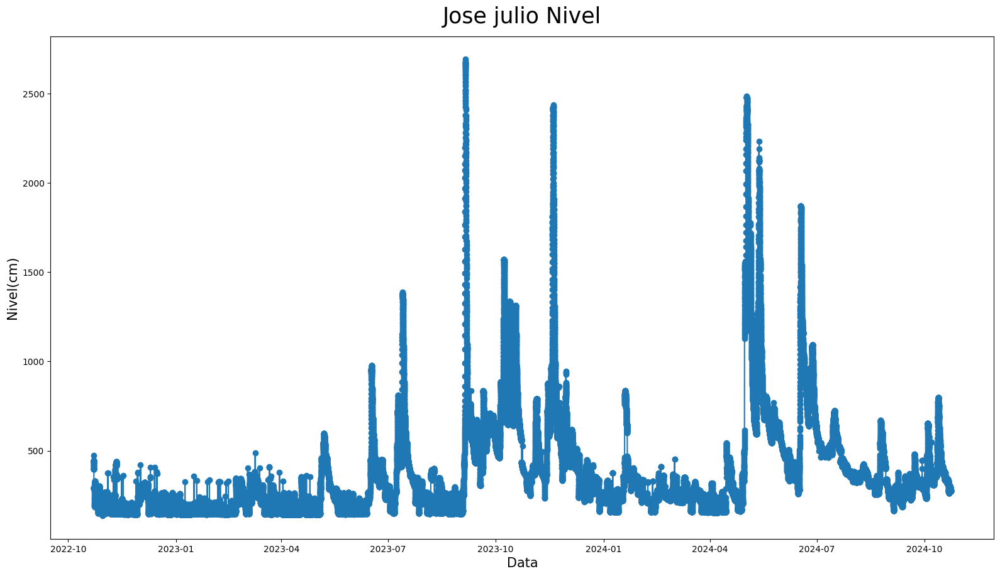

In [183]:
plotar_matplot('Jose julio Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico)

Grafico das 4 estaçoes com o nivel da agua sem nenhum valor nulo

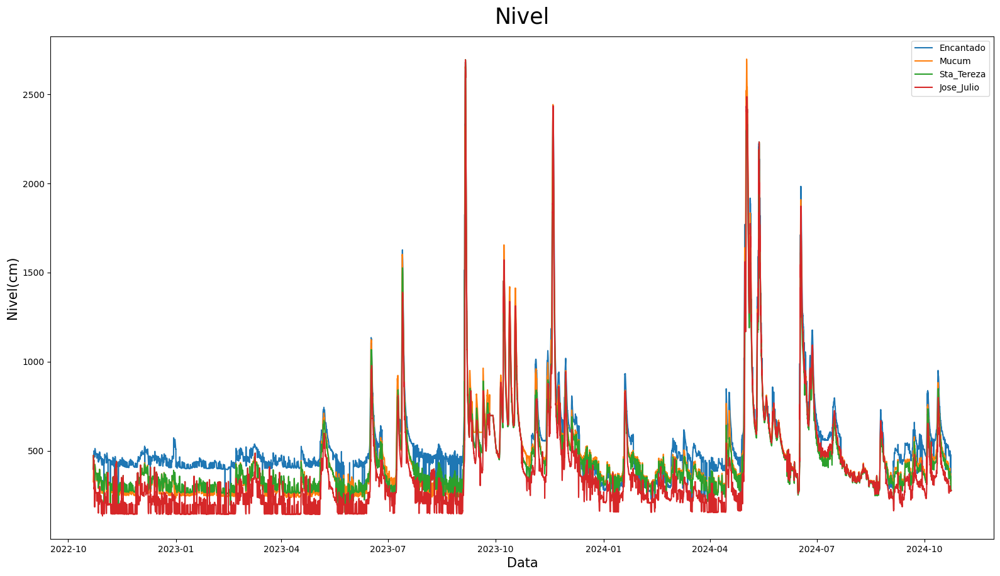

In [184]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-07-1')
data_fim = pd.to_datetime('2024-12-30')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

As datas faltantes nos intervalos possuem os Niveis preenchidos pela media mas os valores da chuva e vazão são nulos pois não tinha dados neste intervalo

In [185]:
df_Encantado_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    64782 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [186]:
df_Mucum_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    69365 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [187]:
df_Sta_Tereza_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    36971 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


In [188]:
df_Jose_Julio_unico.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69994 entries, 0 to 69993
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Data/Hora    69994 non-null  datetime64[ns]
 1   Chuva(mm)    67257 non-null  float64       
 2   Nivel(cm)    69994 non-null  float64       
 3   Vazao(m3/s)  69994 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 2.1 MB


foi necessario fazer mesma interpolação feita anteriormente para os valores da chuva e vazão para as novas linhas criadas

In [189]:
df_Encantado_unico['Chuva(mm)'] = df_Encantado_unico['Chuva(mm)'].fillna(0)
df_Mucum_unico['Chuva(mm)'] = df_Mucum_unico['Chuva(mm)'].fillna(0)
df_Sta_Tereza_unico['Chuva(mm)'] = df_Sta_Tereza_unico['Chuva(mm)'].fillna(0)
df_Jose_Julio_unico['Chuva(mm)'] = df_Jose_Julio_unico['Chuva(mm)'].fillna(0)
df_Encantado_unico['Vazao(m3/s)'] = df_Encantado_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Mucum_unico['Vazao(m3/s)'] = df_Mucum_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Sta_Tereza_unico['Vazao(m3/s)'] = df_Sta_Tereza_unico['Vazao(m3/s)'].interpolate(method='linear')
df_Jose_Julio_unico['Vazao(m3/s)'] = df_Jose_Julio_unico['Vazao(m3/s)'].interpolate(method='linear')

## SHIFT BACK

- para os dados Voltarem em suas posiçoes originais é necessario fazer o deslocamento feito anteriormente com os valores opostos pondo os valores no seu ponto original

In [190]:
# Definir os deslocamentos específicos para cada tabela
shift1, shift2, shift3, shift4 = -12, -12, 7, 20

# Alinhar as tabelas
df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico = deslocar_data_series(
    df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
    coluna_data='Data/Hora',
    shift1=shift1, shift2=shift2, shift3=shift3, shift4=shift4
)

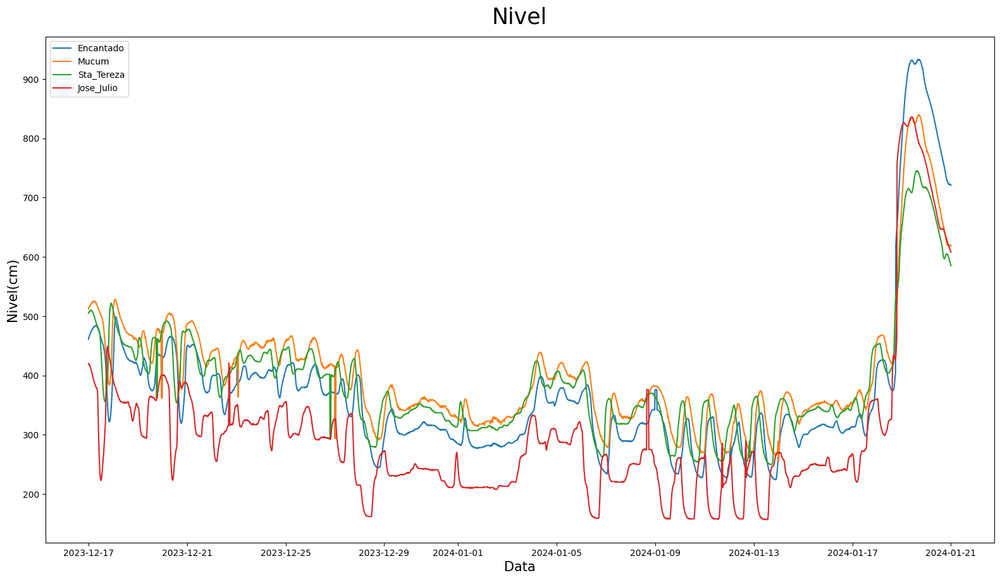

In [191]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [192]:
df_Encantado_unico['Nivel(cm)'] = df_Encantado_unico['Nivel(cm)'] - 180
df_Mucum_unico['Nivel(cm)'] = df_Mucum_unico['Nivel(cm)'] - 70
df_Sta_Tereza_unico['Nivel(cm)'] = df_Sta_Tereza_unico['Nivel(cm)'] - 50
df_Jose_Julio_unico['Nivel(cm)'] = df_Jose_Julio_unico['Nivel(cm)'] + 40

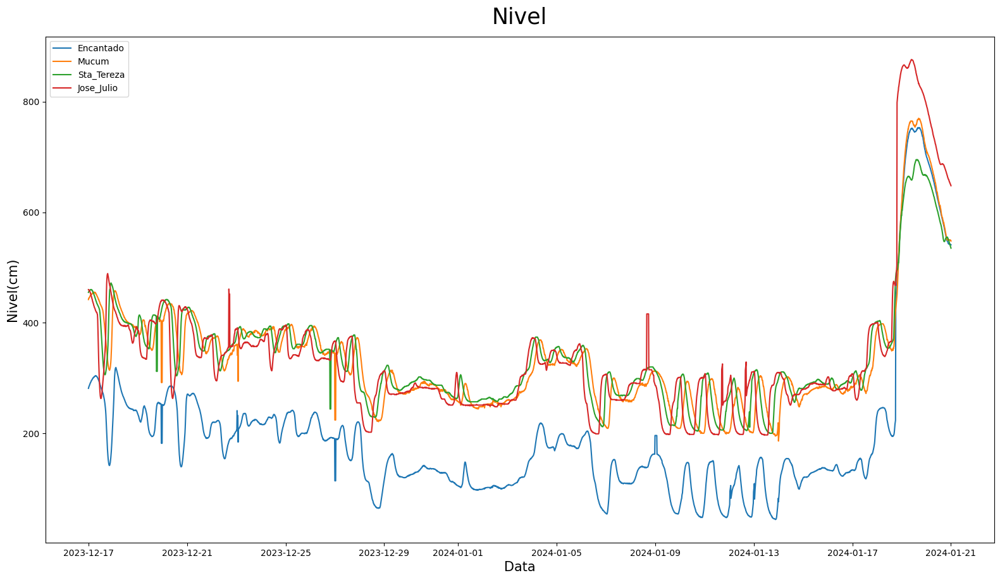

In [193]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-17')
data_fim = pd.to_datetime('2024-01-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Plotando graficos Nivel (ano)




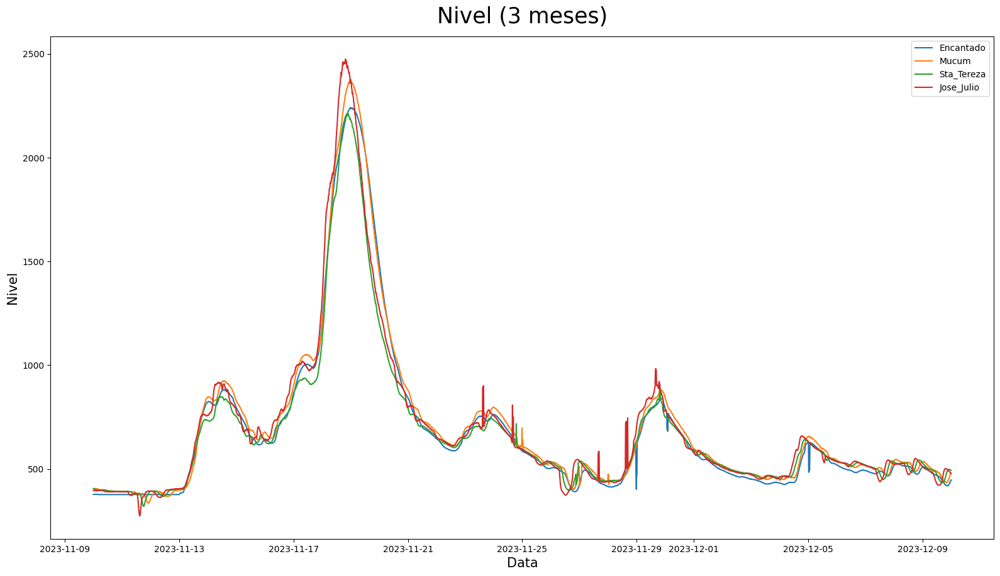

In [194]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

Graficos do nivel de cada cidade dos valores não tratados separado por ano

In [195]:
def plotar_matplot(titulo, labelx, labely, x, y, dataset):
  fig = plt.figure(figsize=(15,8))
  eixo = fig.add_axes([0,0,1,1])
  eixo.plot(x, y, data = dataset, marker='o', linestyle='-')  # 'o-' combina linha com pontos nas marcações
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)
  eixo = eixo

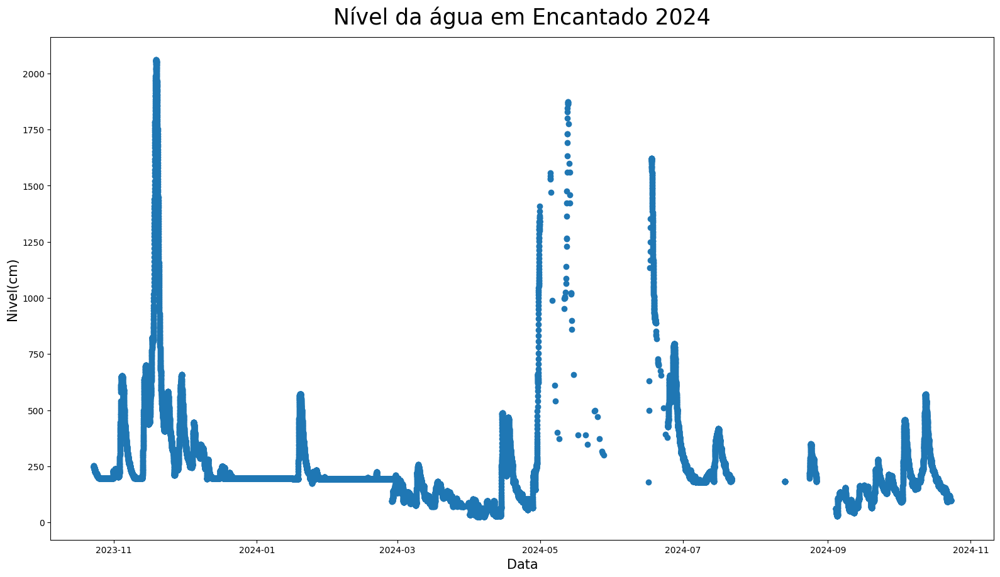

In [196]:
plotar_matplot('Nível da água em Encantado 2024', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Encantado24)

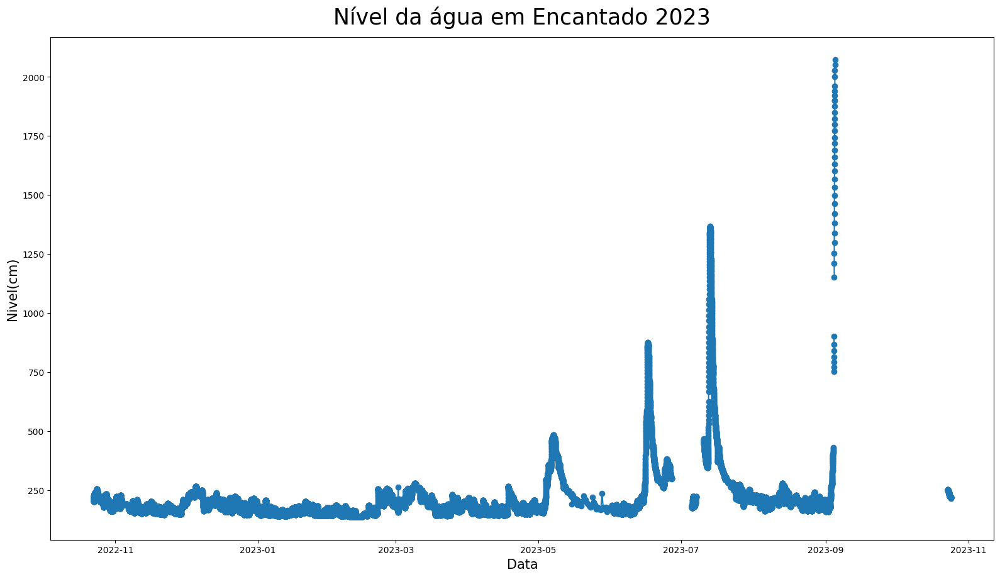

In [197]:
plotar_matplot('Nível da água em Encantado 2023', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Encantado23)

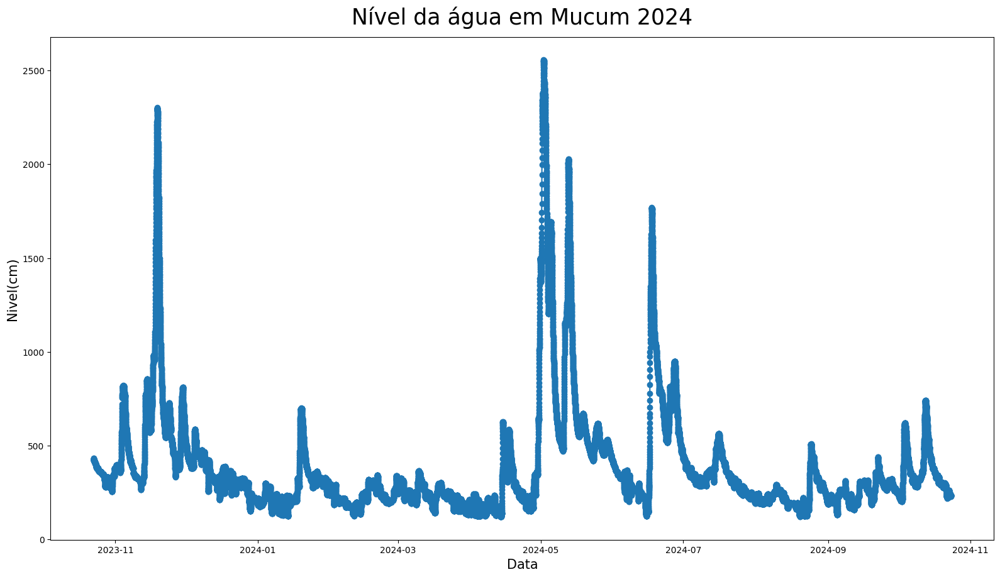

In [198]:
plotar_matplot('Nível da água em Mucum 2024', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Mucum24)

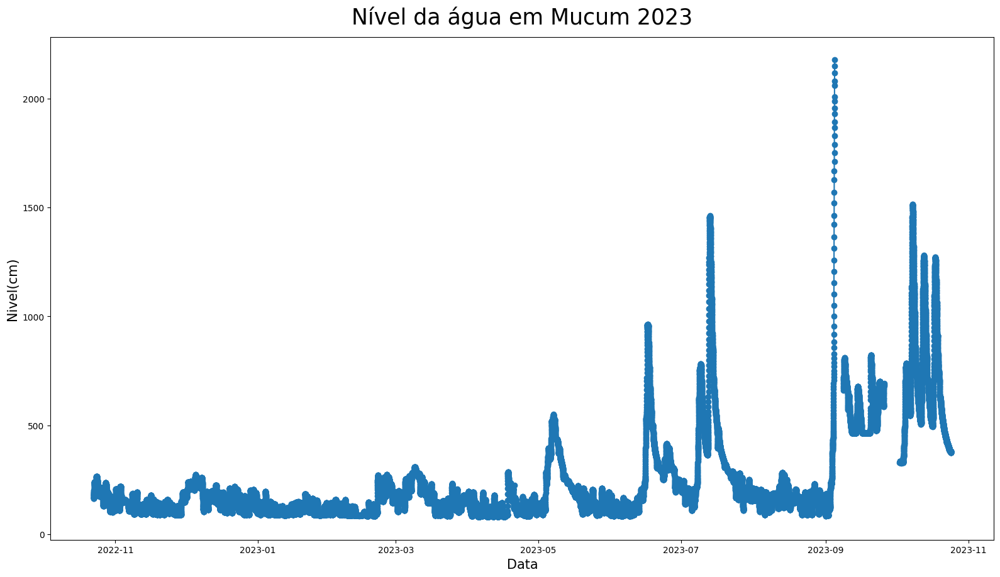

In [199]:
plotar_matplot('Nível da água em Mucum 2023', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Mucum23)

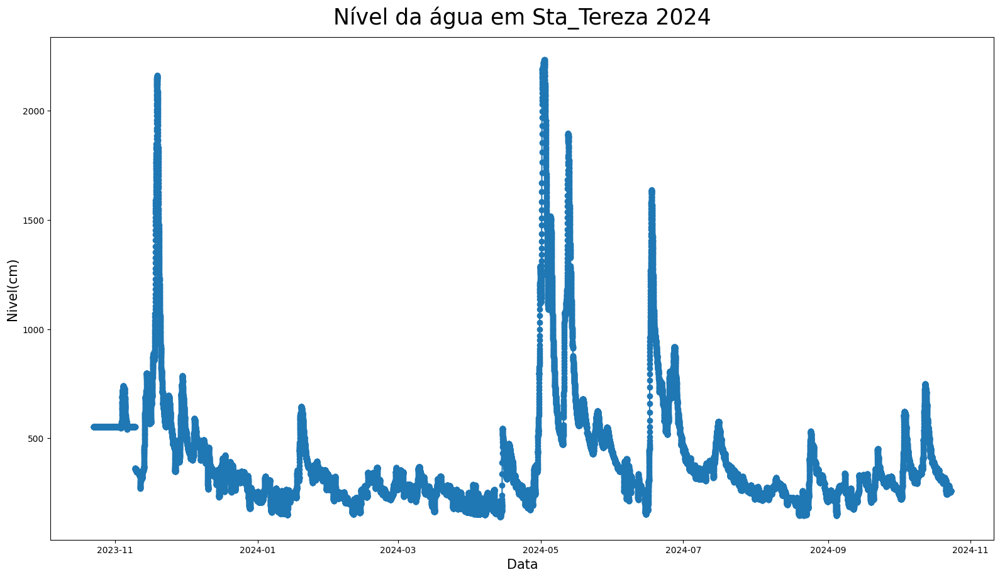

In [200]:
plotar_matplot('Nível da água em Sta_Tereza 2024', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza24)

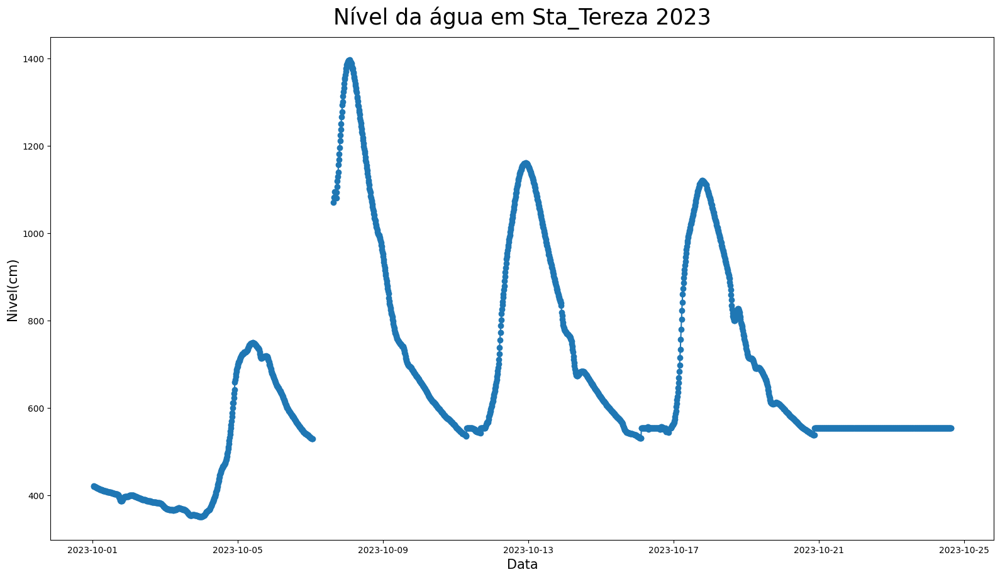

In [201]:
plotar_matplot('Nível da água em Sta_Tereza 2023', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza23)

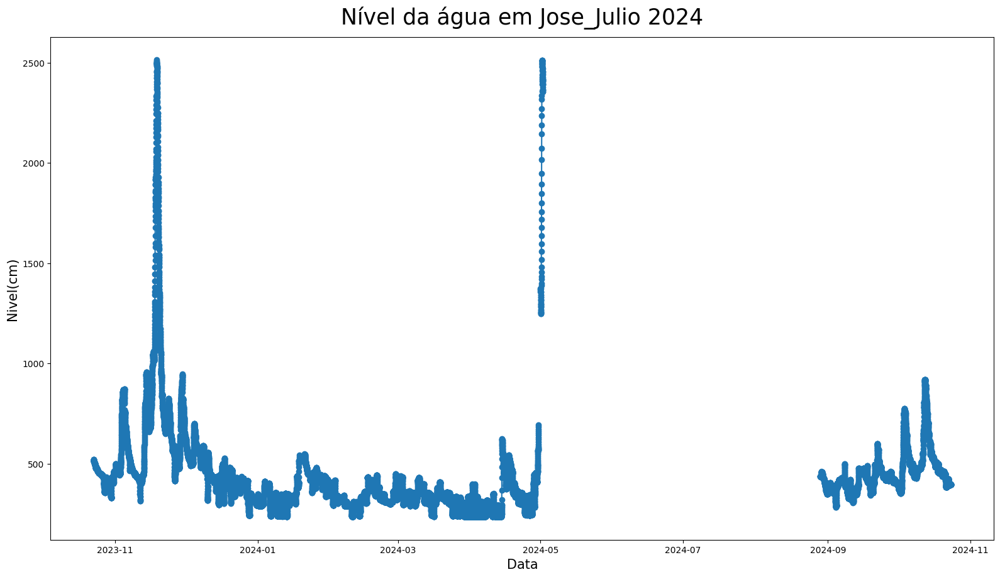

In [202]:
plotar_matplot('Nível da água em Jose_Julio 2024', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio24)

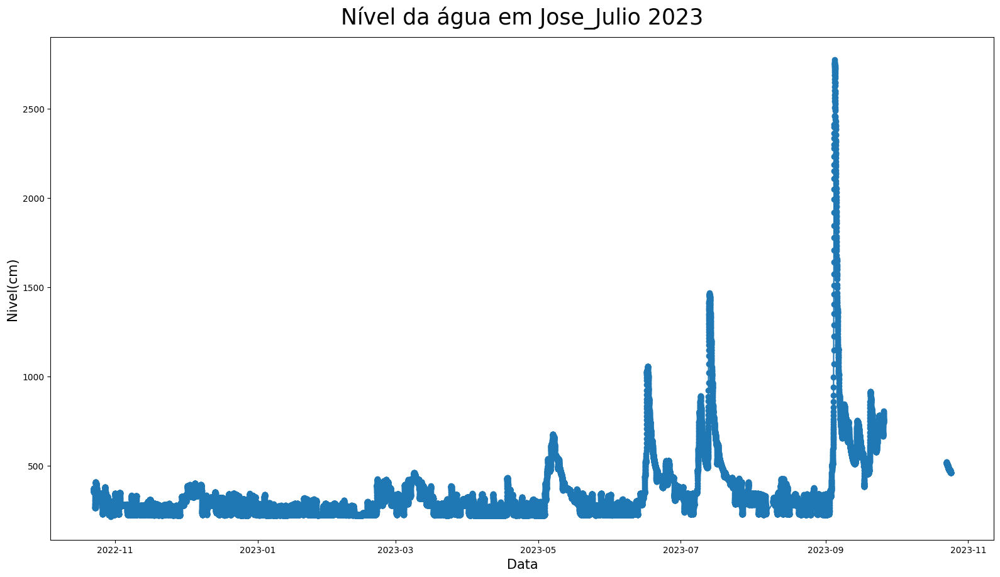

In [203]:
plotar_matplot('Nível da água em Jose_Julio 2023', 'Data', 'Nivel(cm)', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio23)

# Boxplot

In [204]:
def plotar_boxplot(titulo, labelx, labely, x, y, dataset, tipo='linha'):
    # Verificar se o dataset não está vazio
    if dataset.empty:
        print("O dataset está vazio.")
        return

    # Verificar se as colunas especificadas existem no dataset
    if x not in dataset.columns or y not in dataset.columns:
        print(f"As colunas '{x}' e '{y}' devem existir no dataset.")
        return

    fig = plt.figure(figsize=(15, 8))
    eixo = fig.add_axes([0, 0, 1, 1])

    if tipo == 'linha':
        eixo.plot(dataset[x], dataset[y], marker='o', linestyle='-')  # Gráfico de linha com pontos
    elif tipo == 'boxplot':
        # Remover nulos apenas da coluna y
        dataset_cleaned = dataset.dropna(subset=[y])
        eixo.boxplot(dataset_cleaned[y], vert=True)
        eixo.set_xticklabels([labelx])  # Rótulo do eixo x

    # Configurar título e rótulos dos eixos
    eixo.set_title(titulo, fontsize=25, pad=15)
    eixo.set_xlabel(labelx, fontsize=15)
    eixo.set_ylabel(labely, fontsize=15)

    plt.show()


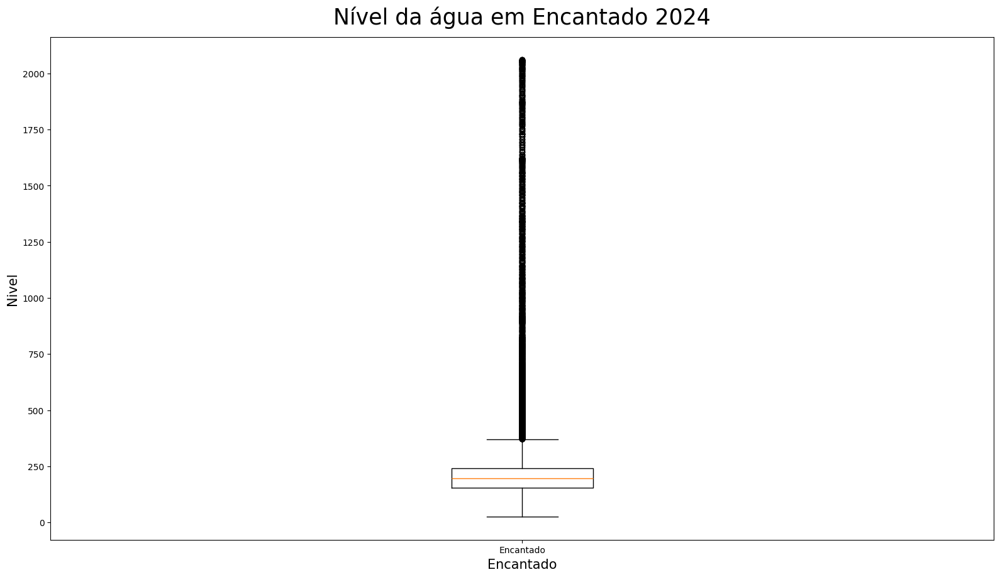

In [205]:
plotar_boxplot('Nível da água em Encantado 2024', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado24, tipo='boxplot')

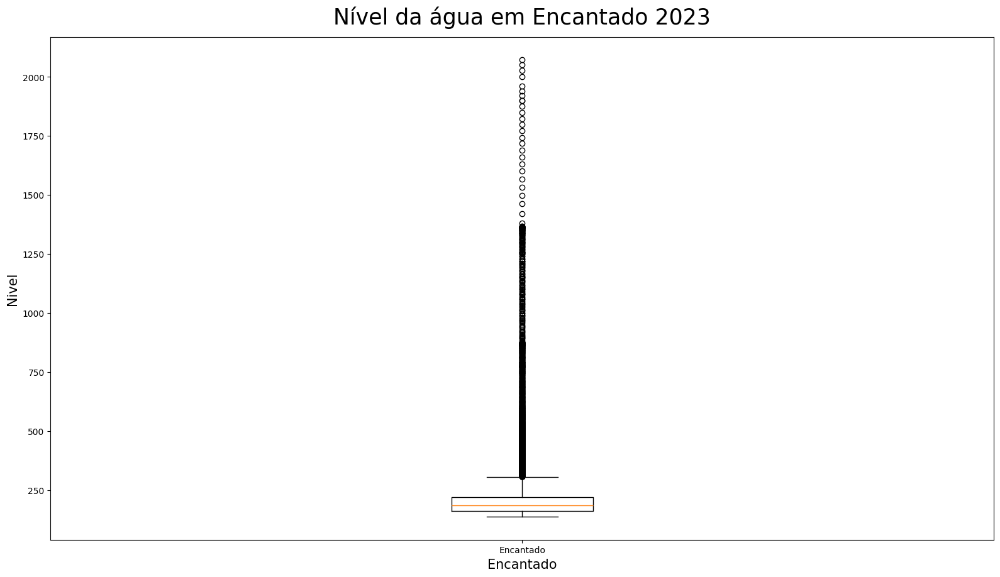

In [206]:
plotar_boxplot('Nível da água em Encantado 2023', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado23, tipo='boxplot')

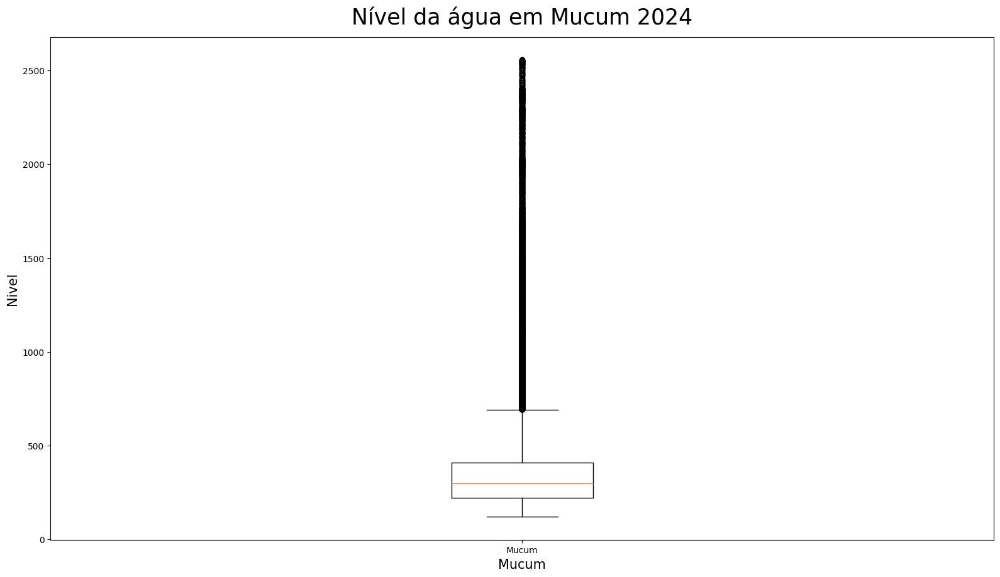

In [207]:
plotar_boxplot('Nível da água em Mucum 2024', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum24, tipo='boxplot')

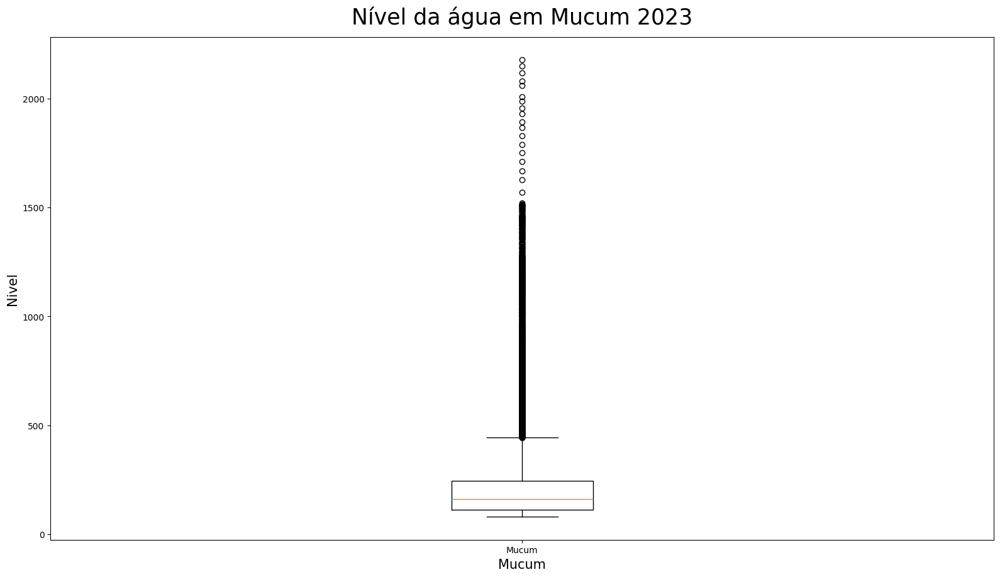

In [208]:
plotar_boxplot('Nível da água em Mucum 2023', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum23, tipo='boxplot')

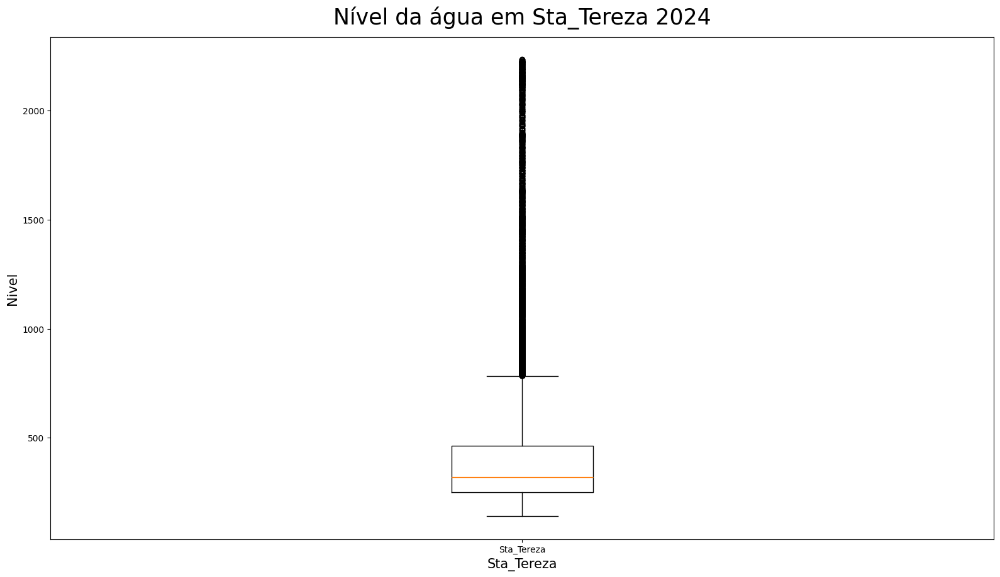

In [209]:
plotar_boxplot('Nível da água em Sta_Tereza 2024', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza24, tipo='boxplot')

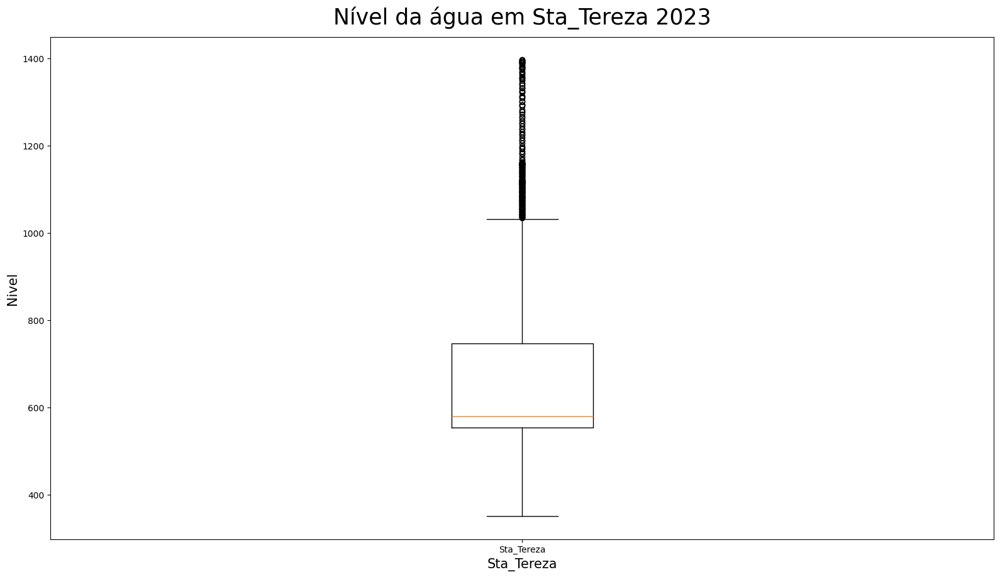

In [210]:
plotar_boxplot('Nível da água em Sta_Tereza 2023', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza23, tipo='boxplot')

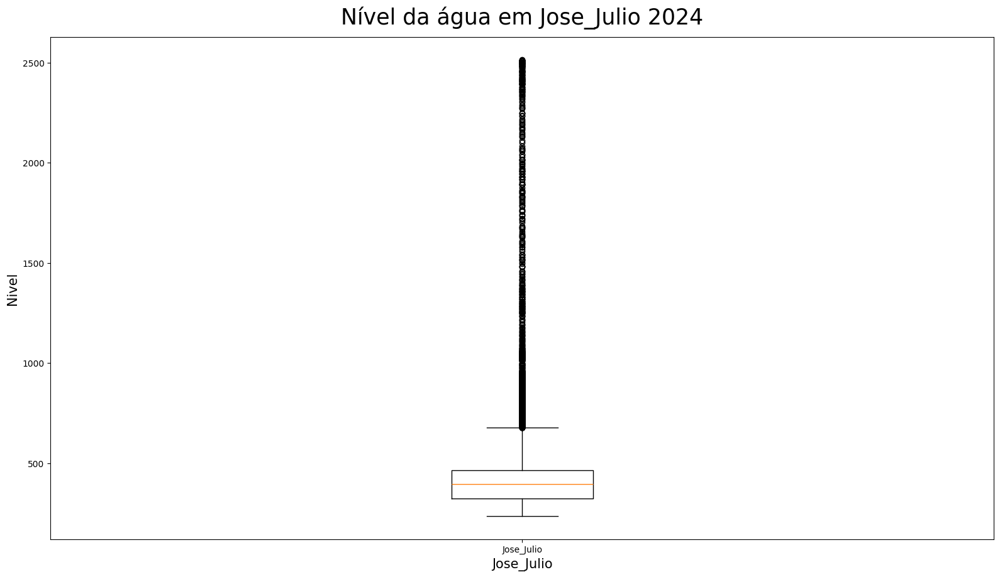

In [211]:
plotar_boxplot('Nível da água em Jose_Julio 2024', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio24, tipo='boxplot')

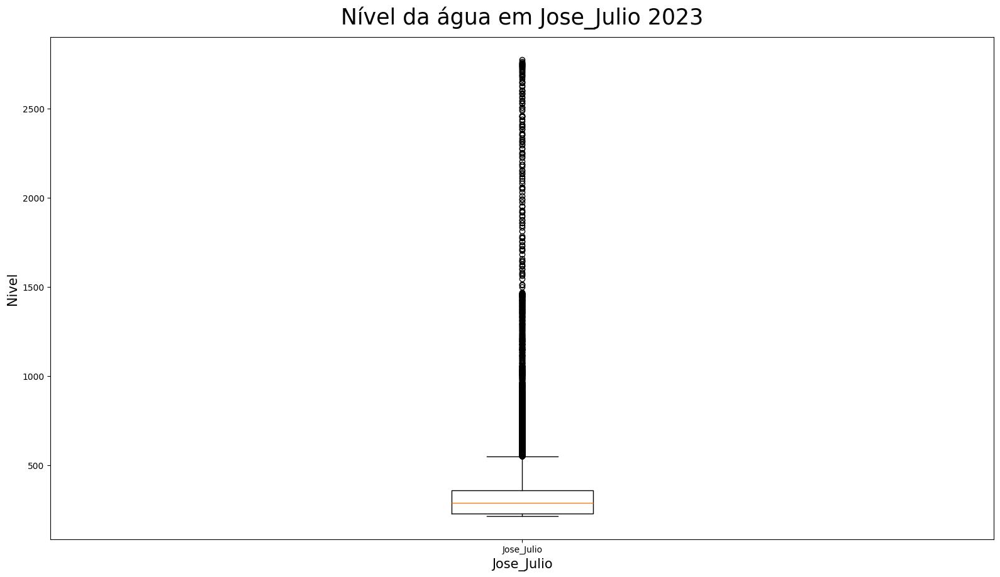

In [212]:
plotar_boxplot('Nível da água em Jose_Julio 2023', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio23, tipo='boxplot')

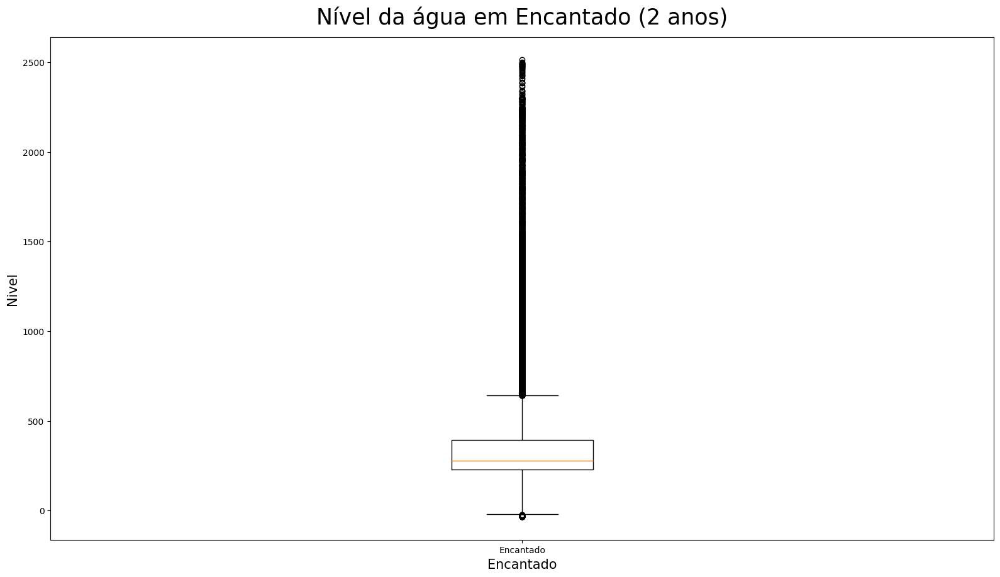

In [213]:
plotar_boxplot('Nível da água em Encantado (2 anos)', 'Encantado', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado_unico, tipo='boxplot')

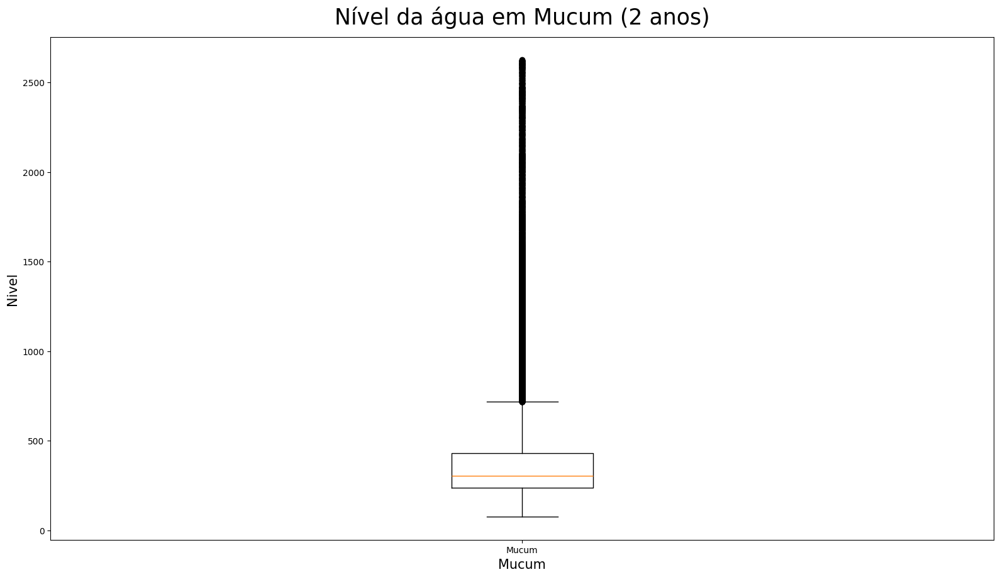

In [214]:
plotar_boxplot('Nível da água em Mucum (2 anos)', 'Mucum', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Mucum_unico, tipo='boxplot')

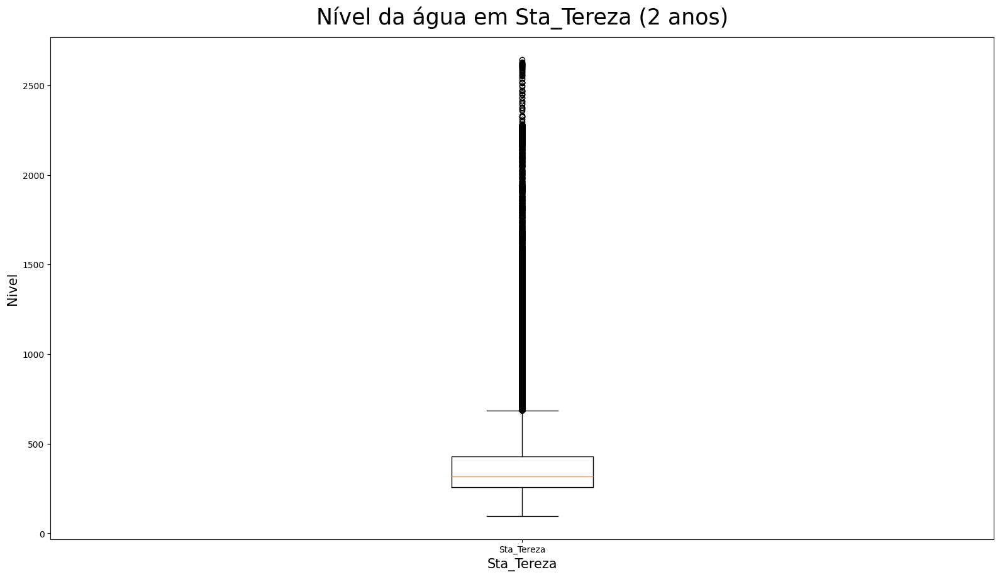

In [215]:
plotar_boxplot('Nível da água em Sta_Tereza (2 anos)', 'Sta_Tereza', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Sta_Tereza_unico, tipo='boxplot')

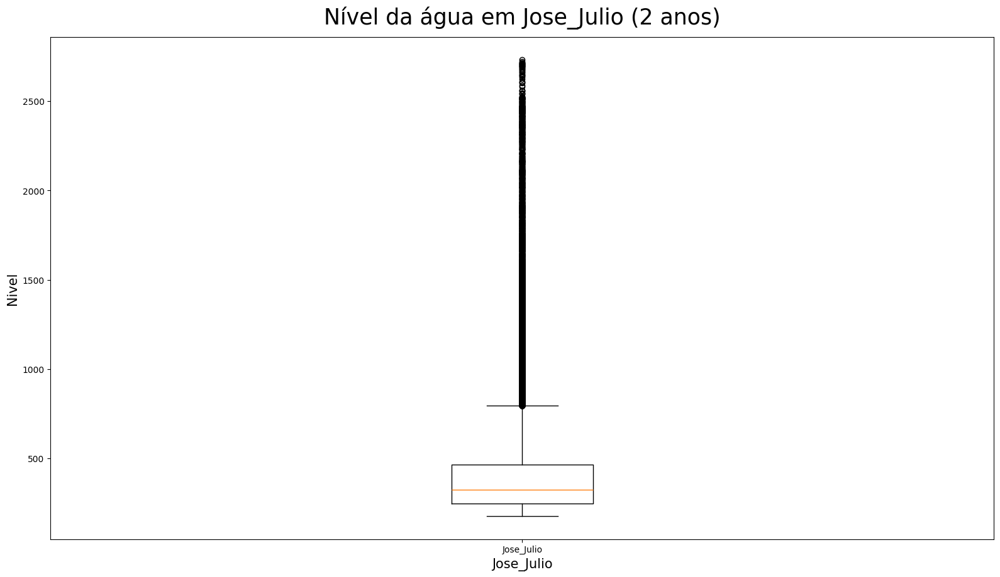

In [216]:
plotar_boxplot('Nível da água em Jose_Julio (2 anos)', 'Jose_Julio', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Jose_Julio_unico, tipo='boxplot')

# Plot com seleção de intervalo (1 cidade)

In [217]:
def plotar_1_intervalo(titulo, labelx, labely, x, y, dataset1, label1, intervalo_data=None):

  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]

  # Plotar os dados com os labels fornecidos
  eixo.plot(x, y, data=dataset1, label=label1, linestyle='-')

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo

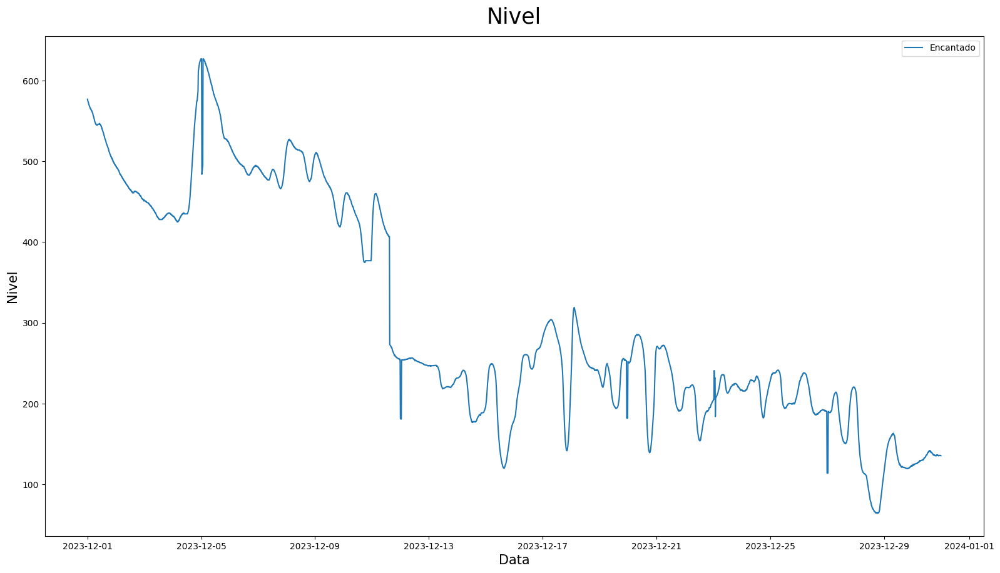

In [218]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-12-01')
data_fim = pd.to_datetime('2023-12-31')

# Chamando a função com intervalo de data
plotar_1_intervalo('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico,
                'Encantado',
                intervalo_data=(data_inicio, data_fim))

# 4 Graficos em um plot com seleção de intervalo

### grafico nivel da agua 3 meses descartado

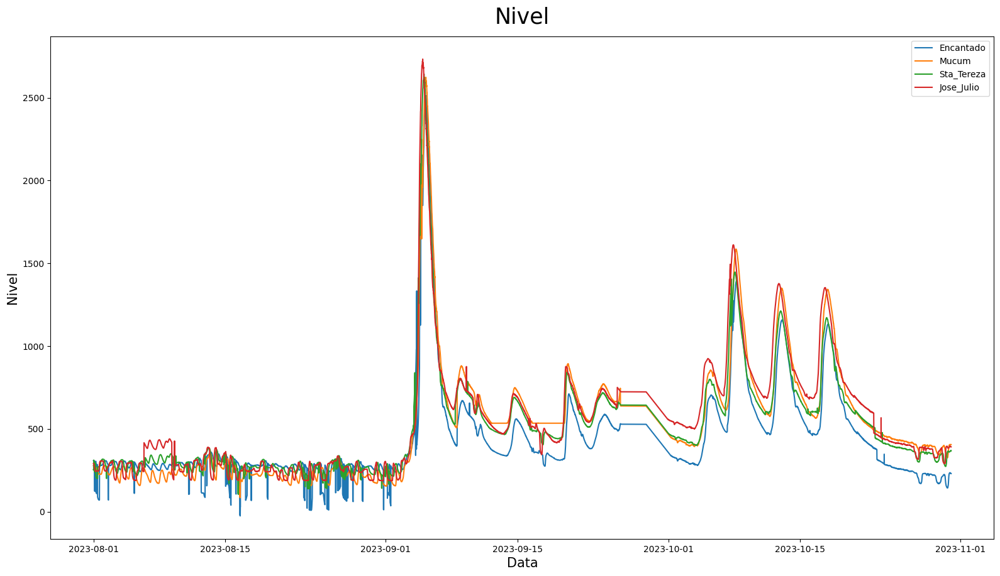

In [219]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-8-01')
data_fim = pd.to_datetime('2023-10-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

### grafico nivel da agua relevantes

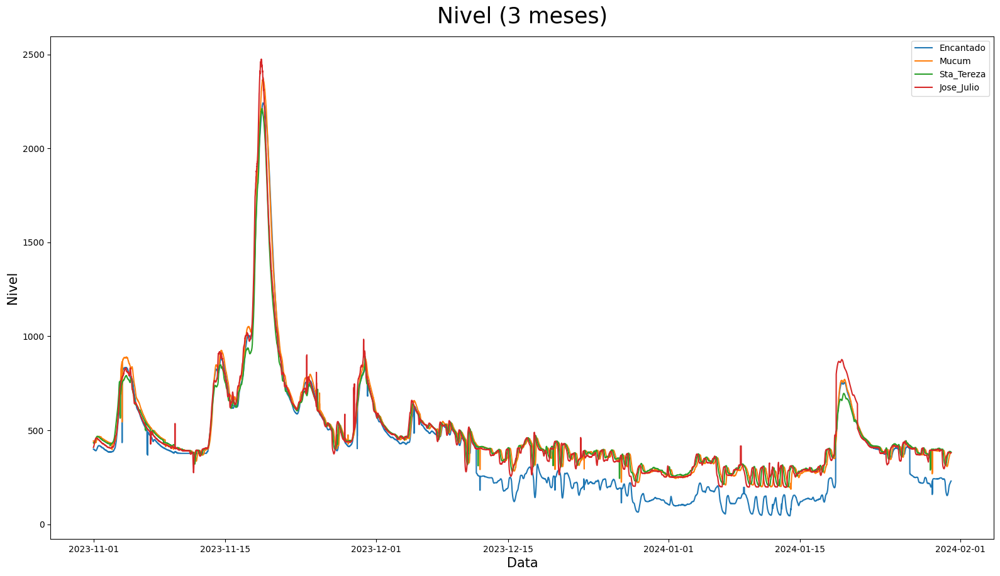

In [220]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

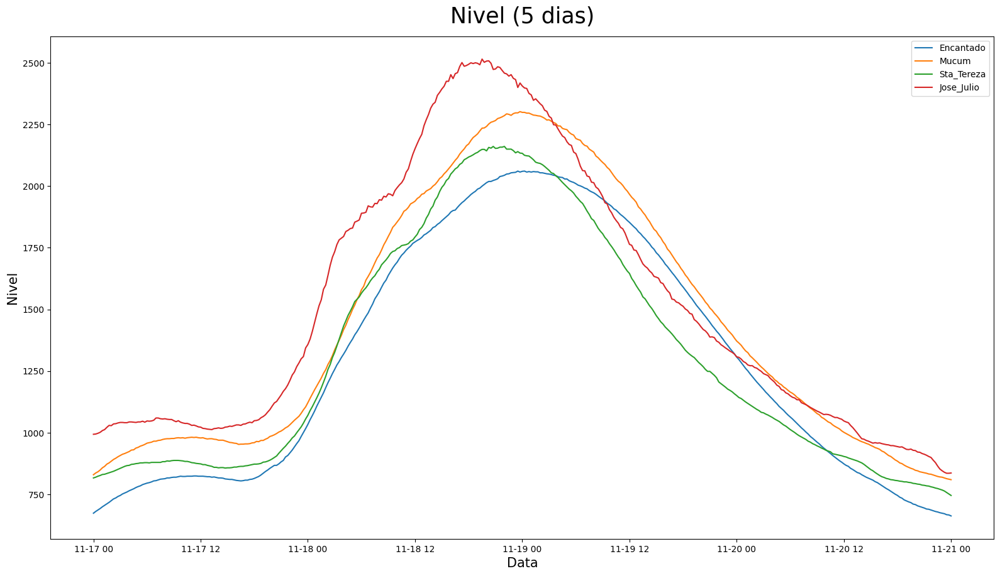

In [221]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado24, df_Mucum24, df_Sta_Tereza24, df_Jose_Julio24,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

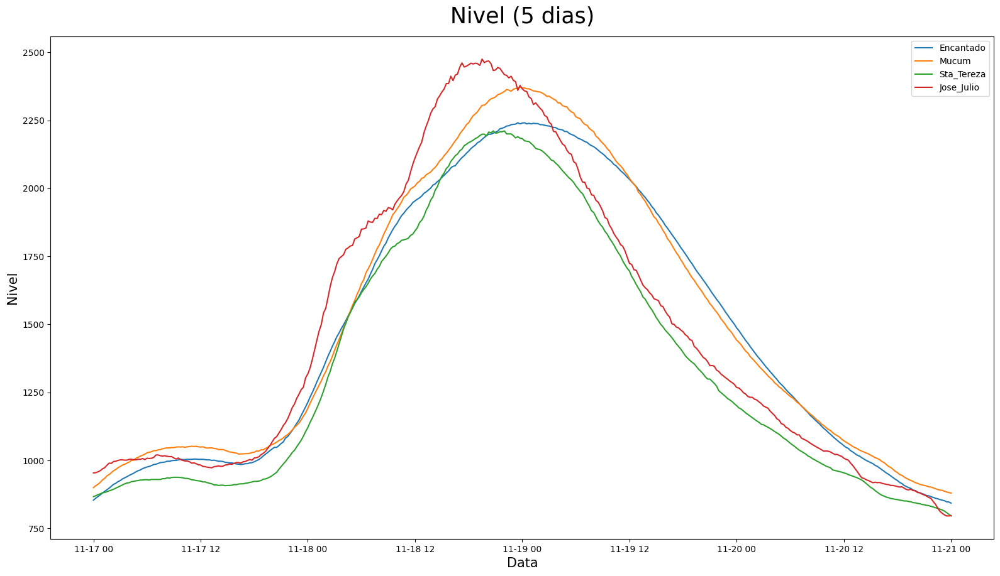

In [222]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-17')
data_fim = pd.to_datetime('2023-11-21')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (5 dias)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

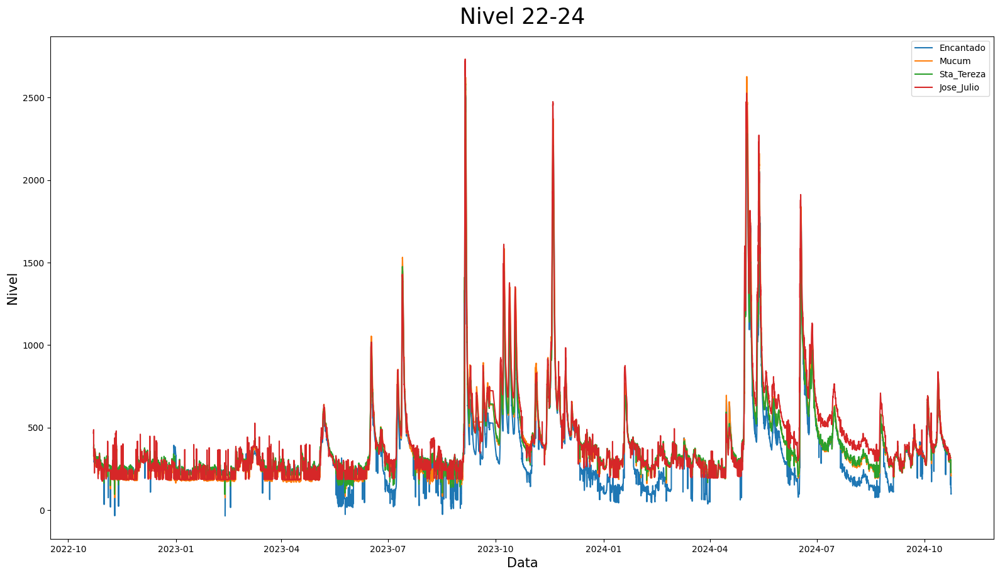

In [223]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel 22-24', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

### Grafico Chuva 4 cidades

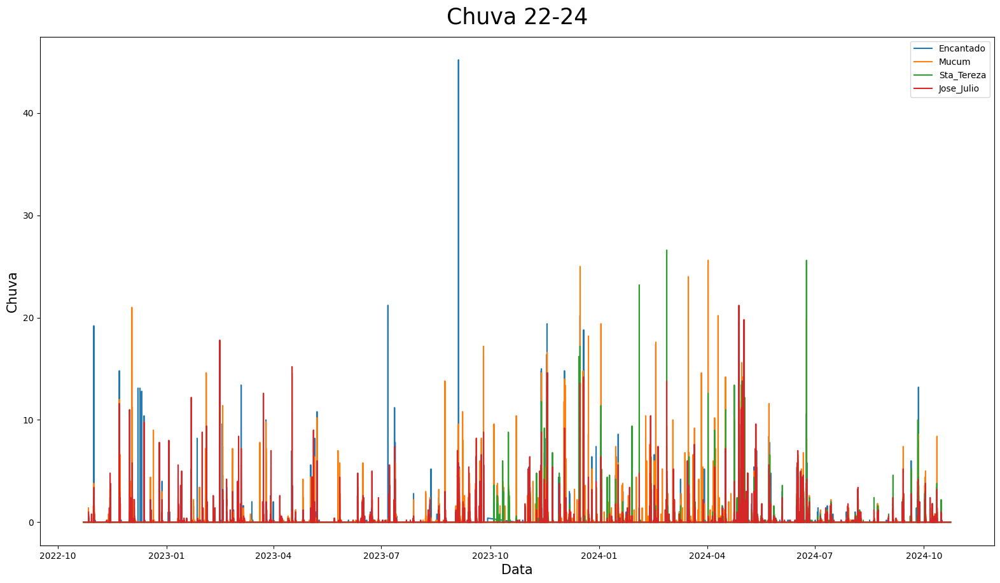

In [224]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-7-01')
data_fim = pd.to_datetime('2024-12-31')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva 22-24', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

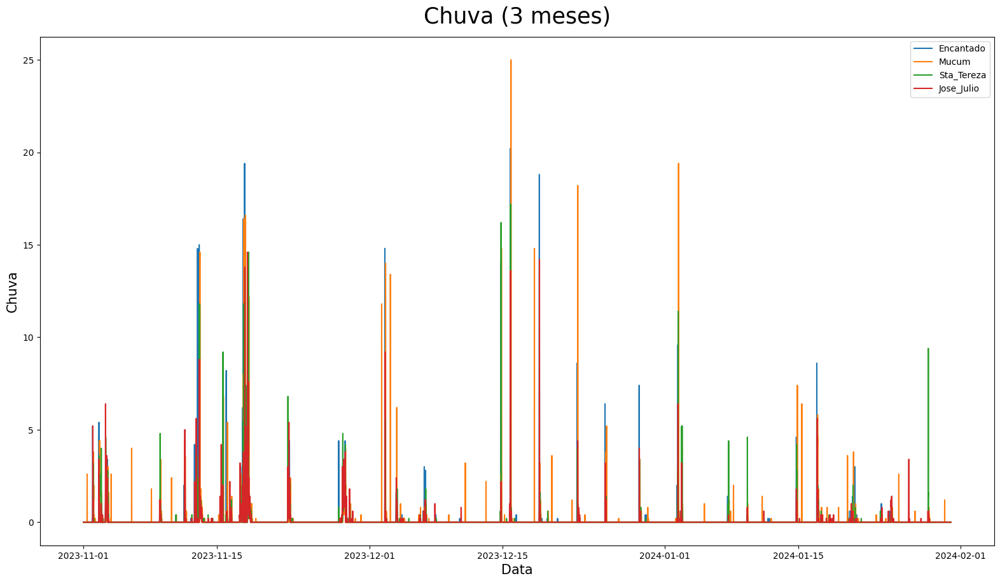

In [225]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva (3 meses)', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

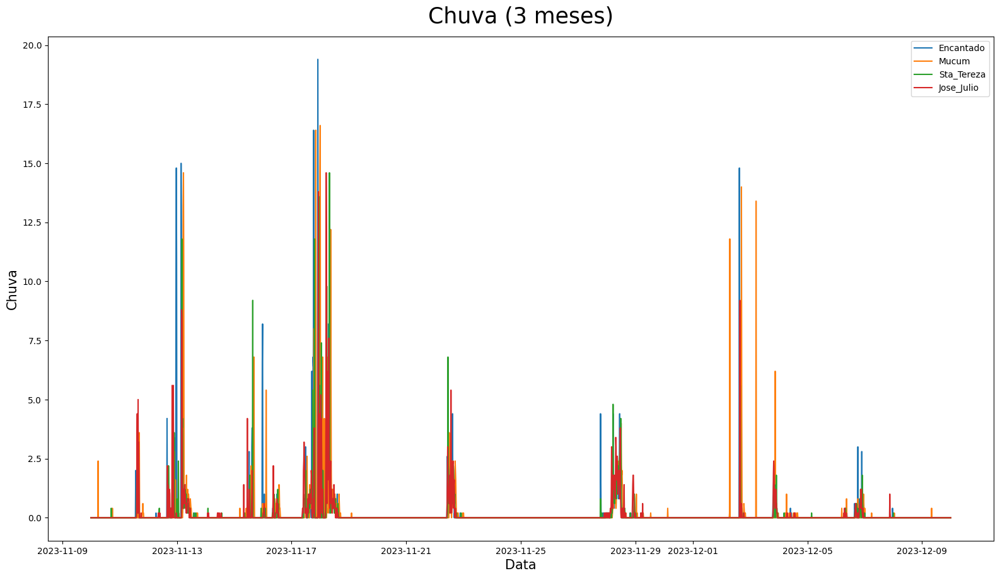

In [226]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Chuva (3 meses)', 'Data', 'Chuva', 'Data/Hora', 'Chuva(mm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Boxplot 4 em 1

In [227]:
def plotar_boxplot4(titulo, labelx, labely, x, y, dataset1, dataset2, dataset3, dataset4, label1, label2, label3, label4, intervalo_data=None):
  fig = plt.figure(figsize=(15, 8))
  eixo = fig.add_axes([0, 0, 1, 1])

  # Filtrar o intervalo de datas, se fornecido
  if intervalo_data is not None:
      data_inicio, data_fim = intervalo_data
      dataset1 = dataset1[(dataset1[x] >= data_inicio) & (dataset1[x] <= data_fim)]
      dataset2 = dataset2[(dataset2[x] >= data_inicio) & (dataset2[x] <= data_fim)]
      dataset3 = dataset3[(dataset3[x] >= data_inicio) & (dataset3[x] <= data_fim)]
      dataset4 = dataset4[(dataset4[x] >= data_inicio) & (dataset4[x] <= data_fim)]

  # Criar uma lista com os dados para o boxplot, ignorando dados nulos
  dados_boxplot = [
      dataset1[y].dropna().values,
      dataset2[y].dropna().values,
      dataset3[y].dropna().values,
      dataset4[y].dropna().values
  ]

  # Plotar o boxplot
  eixo.boxplot(dados_boxplot, labels=[label1, label2, label3, label4])

  # Configurar título e rótulos dos eixos
  eixo.set_title(titulo, fontsize=25, pad=15)
  eixo.set_xlabel(labelx, fontsize=15)
  eixo.set_ylabel(labely, fontsize=15)

  # Adicionar a legenda
  eixo.legend()
  eixo = eixo


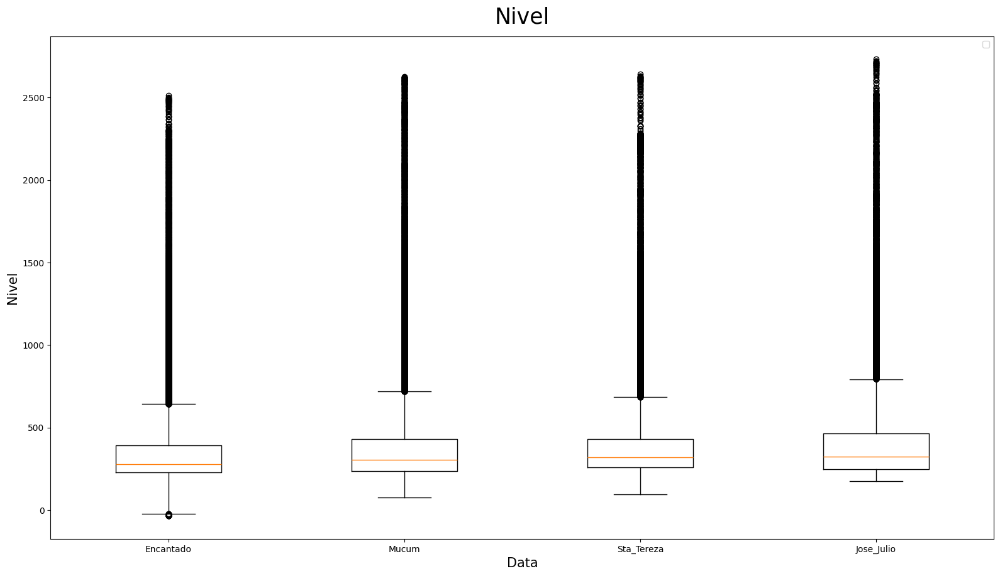

In [228]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-8-01')
data_fim = pd.to_datetime('2024-10-31')

# Chamando a função com intervalo de data
plotar_boxplot4('Nivel', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)', df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio', intervalo_data=(data_inicio, data_fim))

# Nivel e chuva

### Nivel em linha / chuva em barra sobreposta

In [229]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dataset[coluna_data], dataset[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()



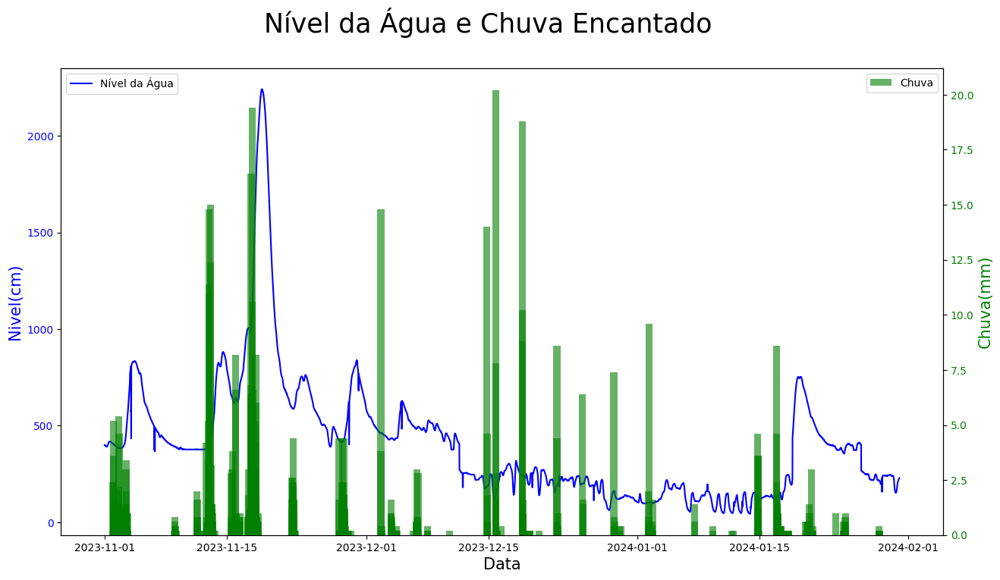

In [230]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim))

### Nivel em linha / chuva em barra sobreposta (Granulando ambos)
possivel selecionar agrupamento por dia, semana, mes ou hora

In [231]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_ambos(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar por frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum', coluna_nivel: 'mean'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dados_agrupados[coluna_data], dados_agrupados[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_agrupados[coluna_data], dados_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')



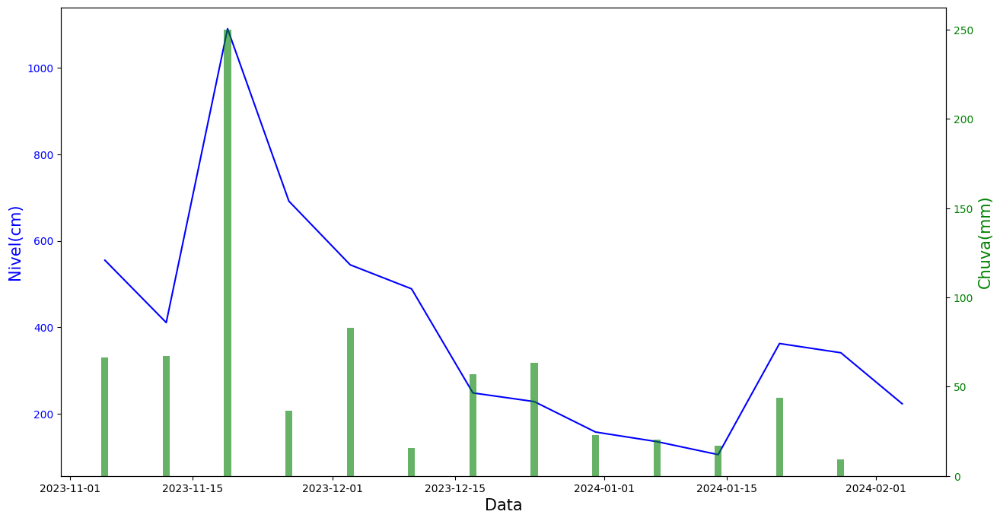

In [232]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_ambos(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='W' )

### Nivel em linha / chuva em barra sobreposta (Granulando chuva)
possivel selecionar agrupamento por dia, semana, mes ou hora

In [233]:
import matplotlib.pyplot as plt
import pandas as pd

def plotar_chuva_nivel_agrupa_chuva(dataset, titulo, labelx, labely1, labely2, coluna_data, coluna_chuva, coluna_nivel, intervalo_data=None, frequencia='D'):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Converter a coluna de data para datetime, caso ainda não esteja
    dataset[coluna_data] = pd.to_datetime(dataset[coluna_data])

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()

    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()


#### cidades intervalo 23-11-01 ate 24-1-31 (3 meses)

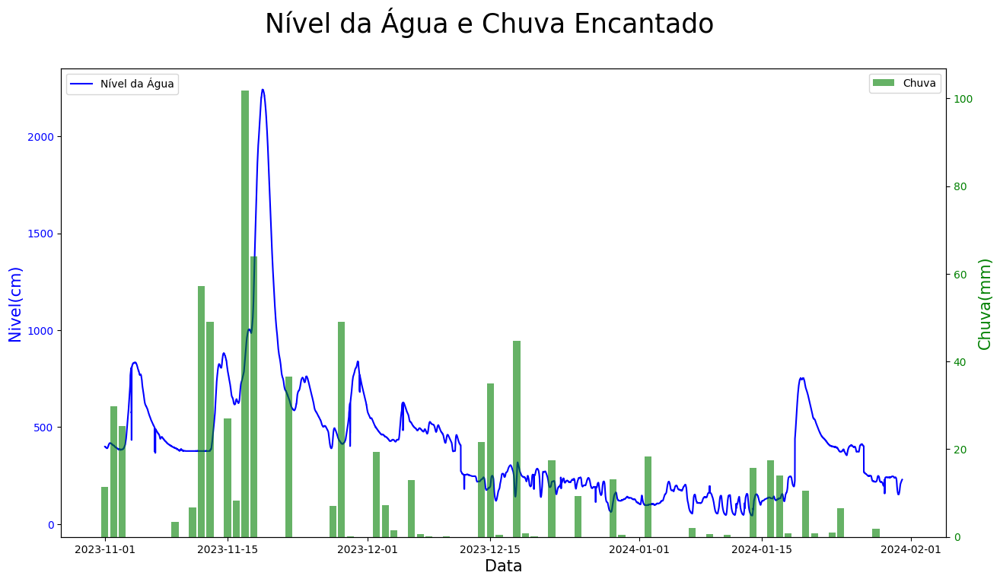

In [234]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

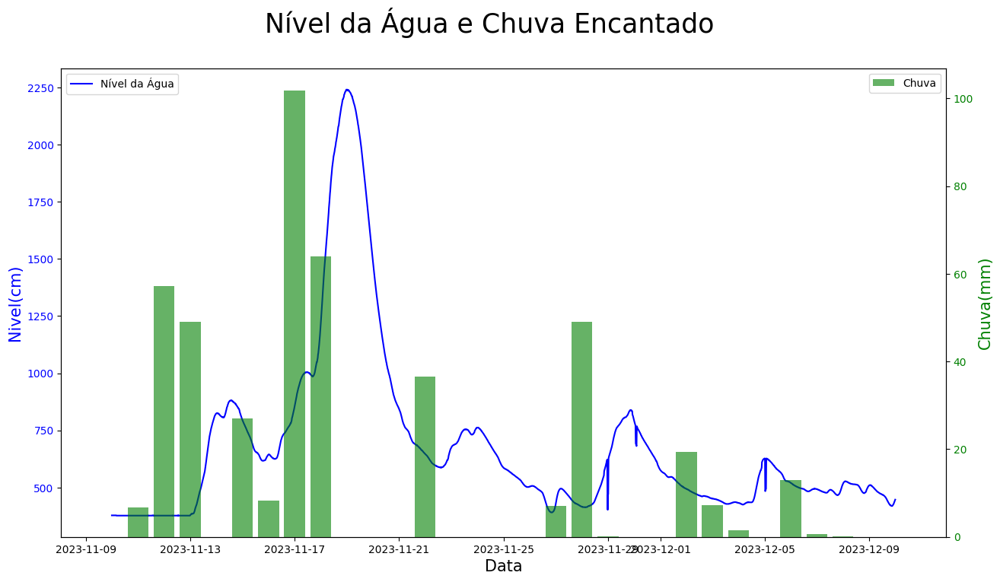

In [235]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

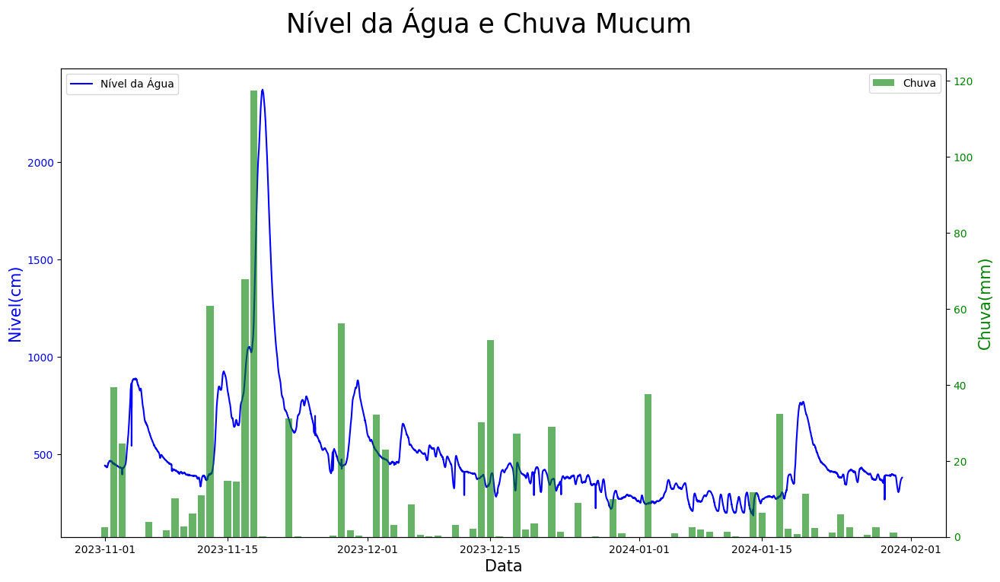

In [236]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

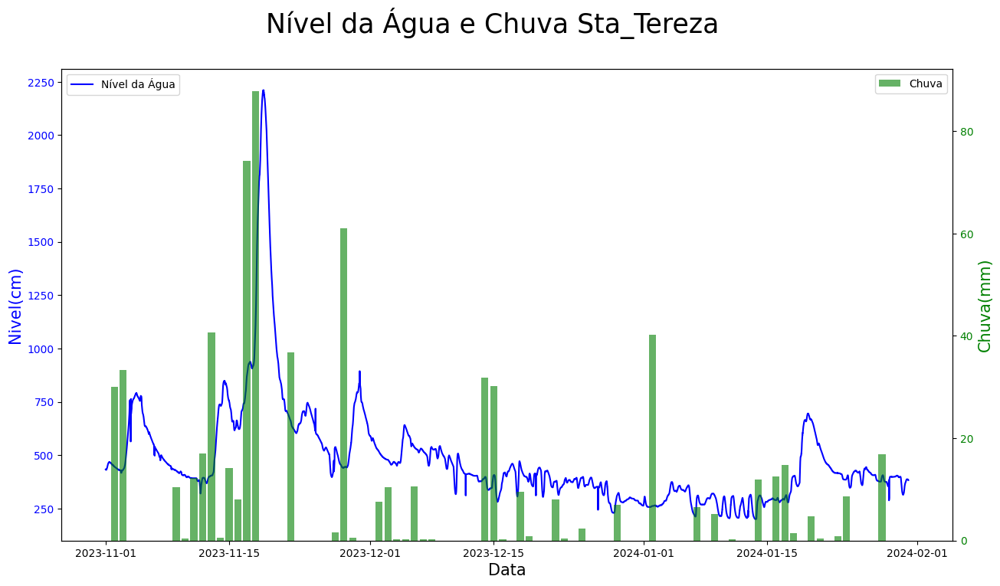

In [237]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

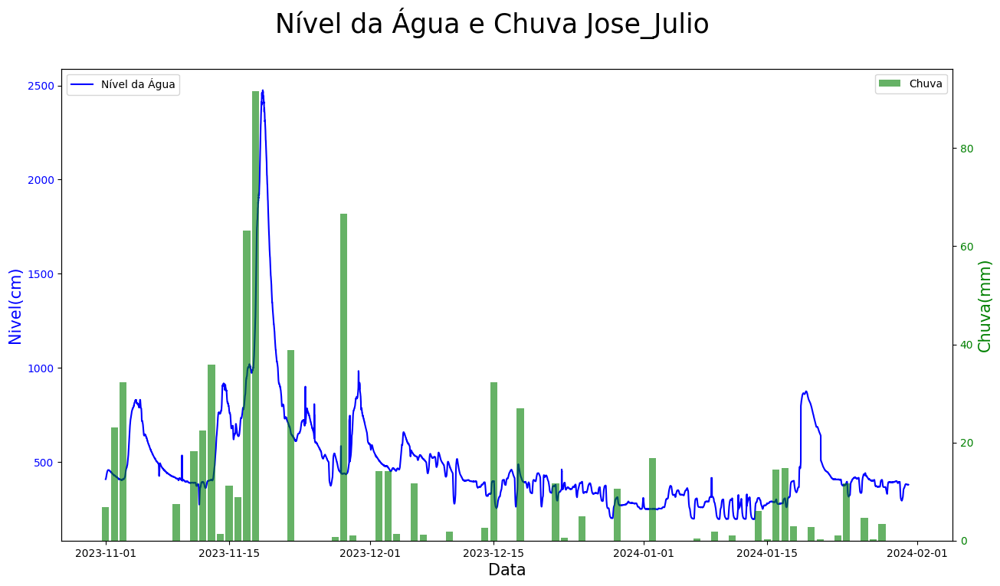

In [238]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-1-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

#### cidades intervalo 22-11-01 ate 24-10-31 (2anos separado por ano)

---




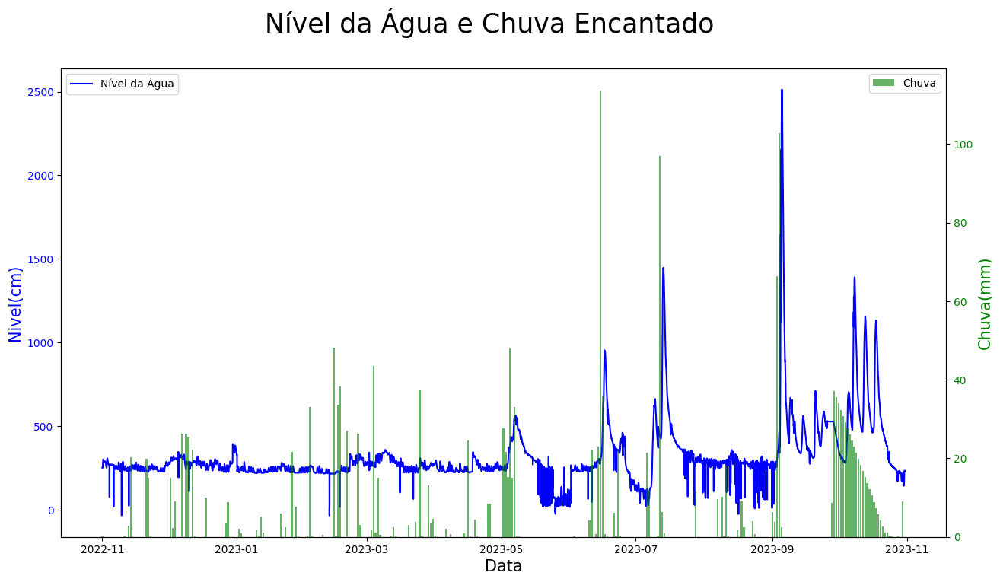

In [239]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

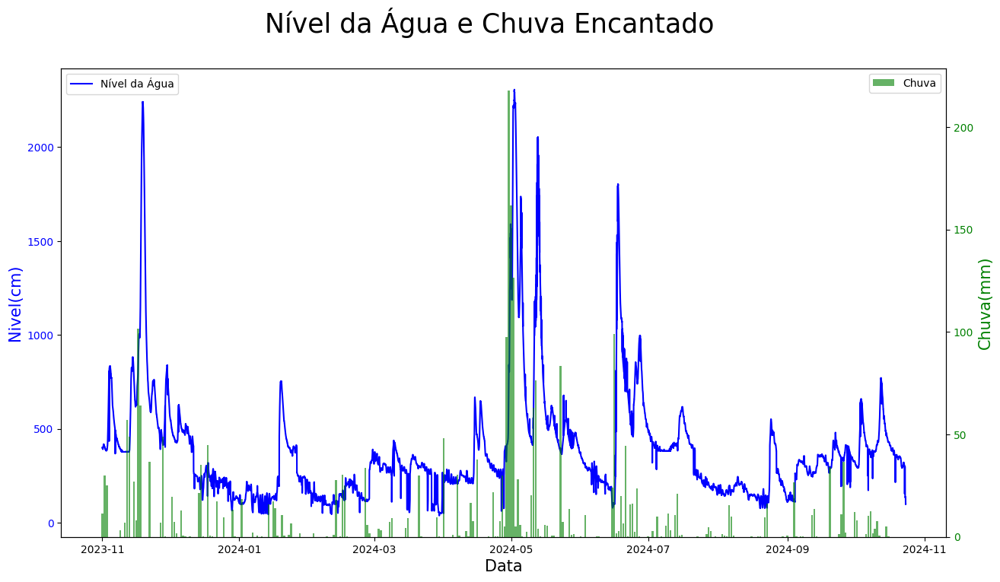

In [240]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

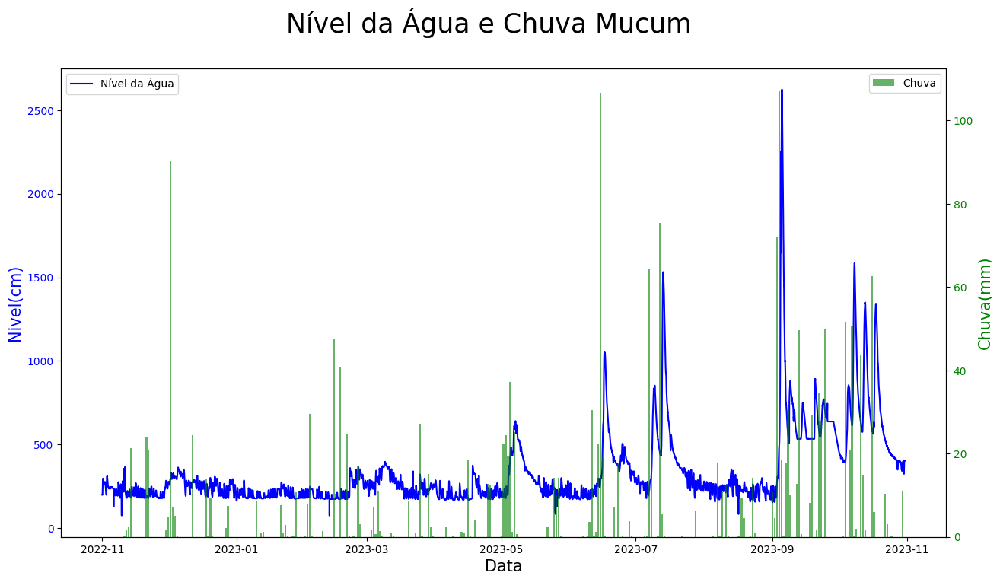

In [241]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

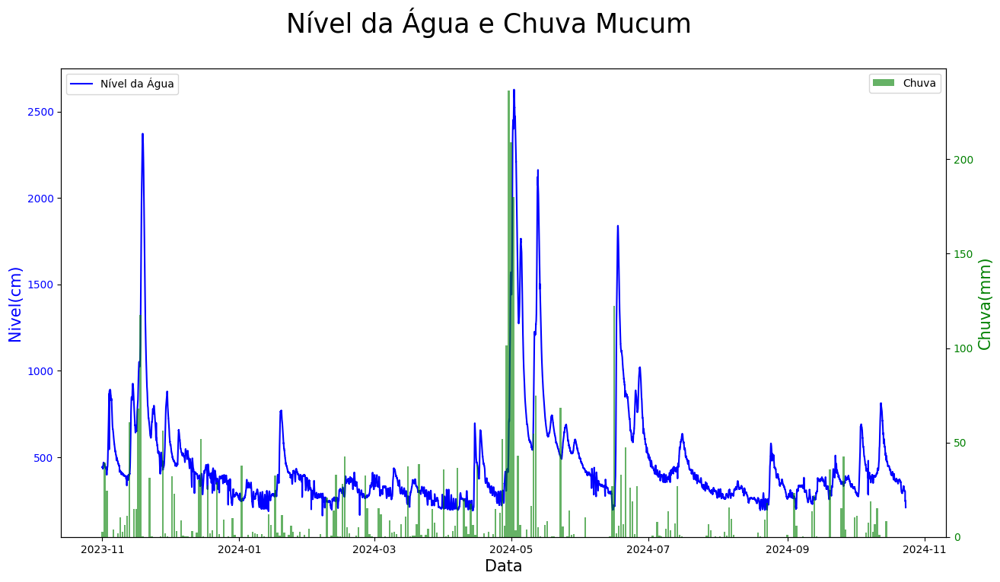

In [242]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Mucum_unico,
                   "Nível da Água e Chuva Mucum",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

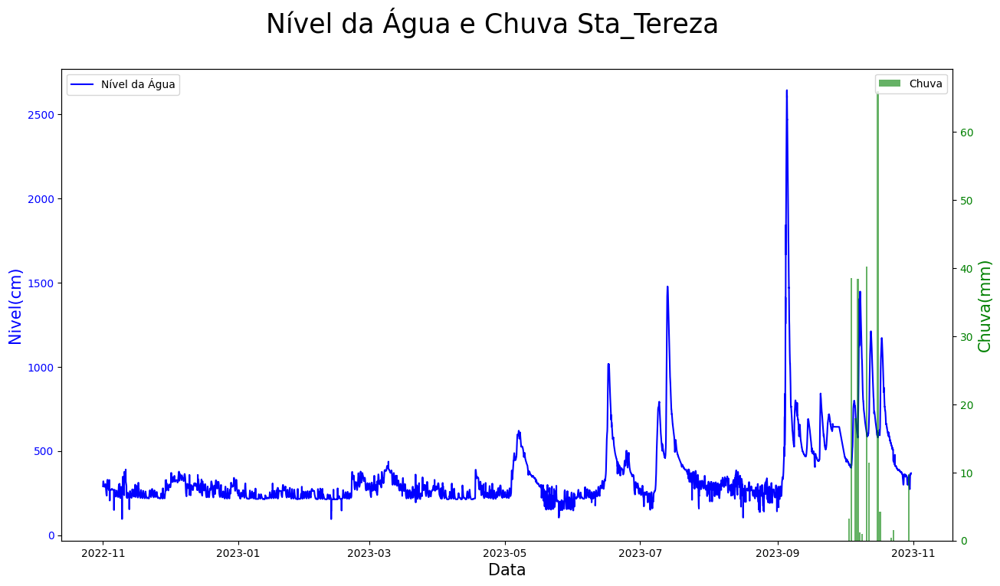

In [243]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

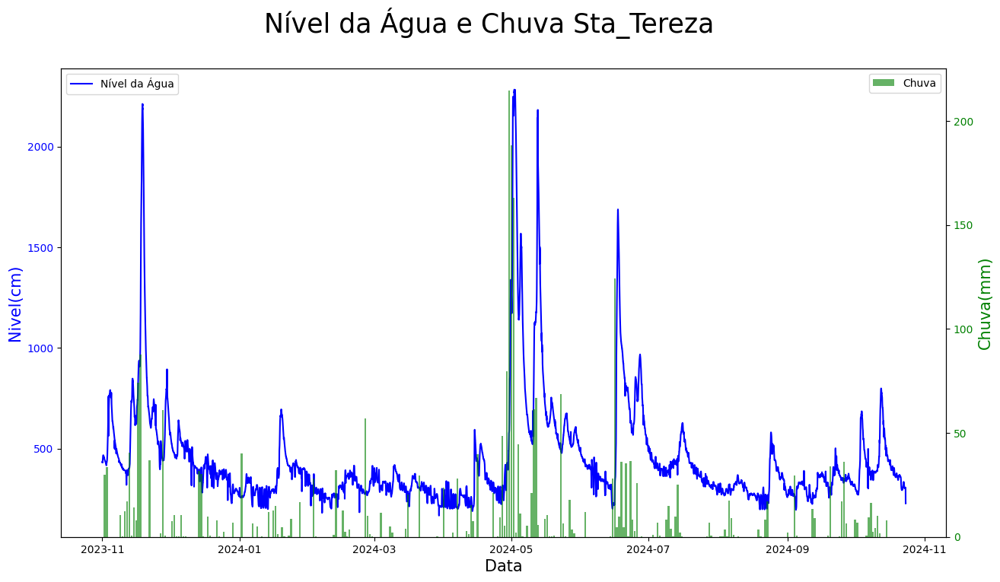

In [244]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Sta_Tereza_unico,
                   "Nível da Água e Chuva Sta_Tereza",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

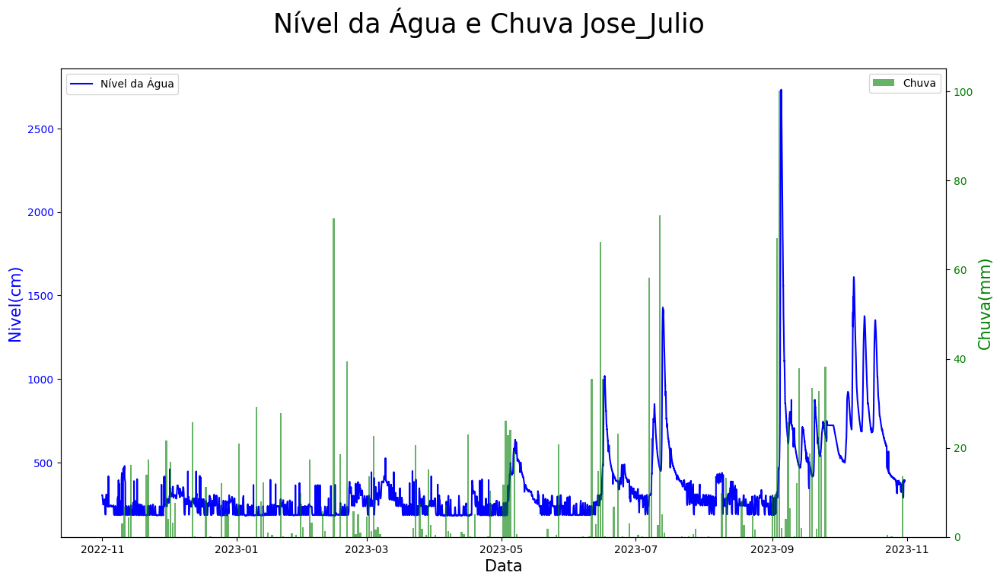

In [245]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2022-11-01')
data_fim = pd.to_datetime('2023-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

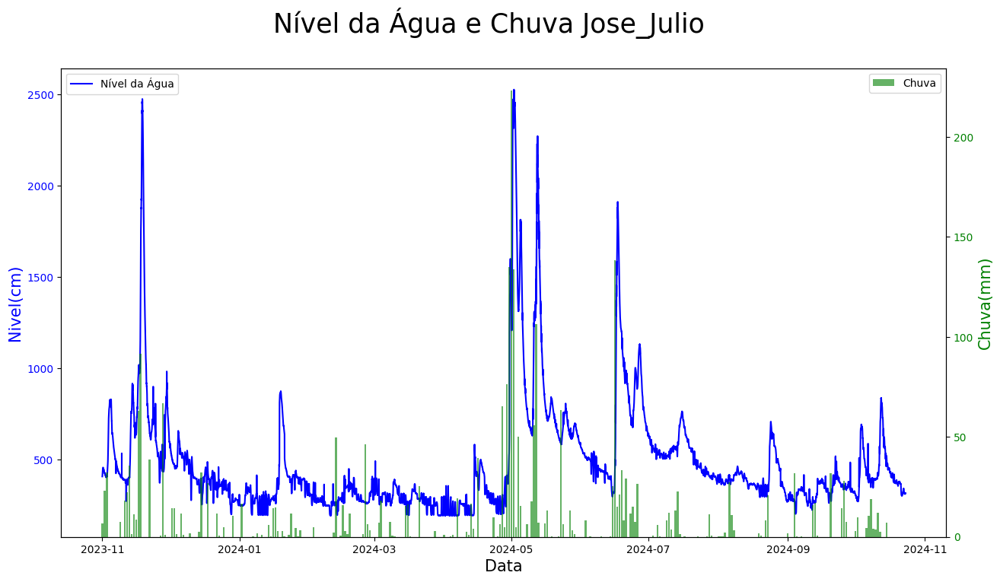

In [246]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-01')
data_fim = pd.to_datetime('2024-10-31')

plotar_chuva_nivel_agrupa_chuva(df_Jose_Julio_unico,
                   "Nível da Água e Chuva Jose_Julio",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' )

# Calcular correlação

Criamos um dataframe que junta as variáveis de todas as estações, não levando em consideração a coluna Data/Hora

Também calculamos a correlação de cada subgrupo de variáveis e a correlação geral de todas as variáveis do data frame

In [247]:
niveis = [df_Encantado_unico['Nivel(cm)'],df_Mucum_unico['Nivel(cm)'],df_Sta_Tereza_unico['Nivel(cm)'],df_Jose_Julio_unico['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_unico['Chuva(mm)'],df_Mucum_unico['Chuva(mm)'],df_Sta_Tereza_unico['Chuva(mm)'],df_Jose_Julio_unico['Chuva(mm)']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['chuva_Encantado', 'chuva_Mucum', 'chuva_Sta_Tereza', 'chuva_Jose_Julio']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_unico['Vazao(m3/s)'],df_Mucum_unico['Vazao(m3/s)'],df_Jose_Julio_unico['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,chuva_Encantado,chuva_Mucum,chuva_Sta_Tereza,chuva_Jose_Julio,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.954722,0.962181,0.929796,0.103769,0.108857,0.160833,0.171896,0.939209,0.946338,0.928938
Nivel_Mucum,0.954722,1.000000,0.990515,0.974531,0.101341,0.112811,0.170936,0.182423,0.950272,0.968328,0.946517
Nivel_Sta_Tereza,0.962181,0.990515,1.000000,0.981684,0.088931,0.094682,0.138955,0.152797,0.948809,0.964114,0.953648
Nivel_Jose_Julio,0.929796,0.974531,0.981684,1.000000,0.086666,0.091430,0.142970,0.139704,0.923162,0.938446,0.945292
chuva_Encantado,0.103769,0.101341,0.088931,0.086666,1.000000,0.245001,0.095938,0.083714,0.101303,0.100305,0.090369
chuva_Mucum,0.108857,0.112811,0.094682,0.091430,0.245001,1.000000,0.131429,0.095966,0.114804,0.115811,0.100816
chuva_Sta_Tereza,0.160833,0.170936,0.138955,0.142970,0.095938,0.131429,1.000000,0.150177,0.170837,0.176203,0.155224
chuva_Jose_Julio,0.171896,0.182423,0.152797,0.139704,0.083714,0.095966,0.150177,1.000000,0.187270,0.197585,0.163717
Vazao_Encantado,0.939209,0.950272,0.948809,0.923162,0.101303,0.114804,0.170837,0.187270,1.000000,0.984655,0.973399
Vazao_Mucum,0.946338,0.968328,0.964114,0.938446,0.100305,0.115811,0.176203,0.197585,0.984655,1.000000,0.980540


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

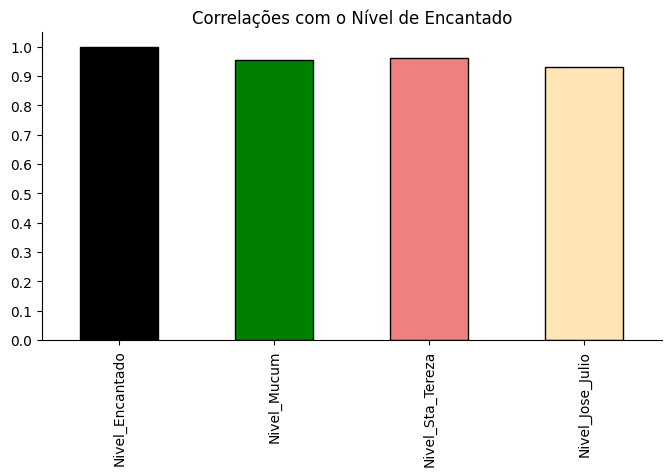

In [248]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

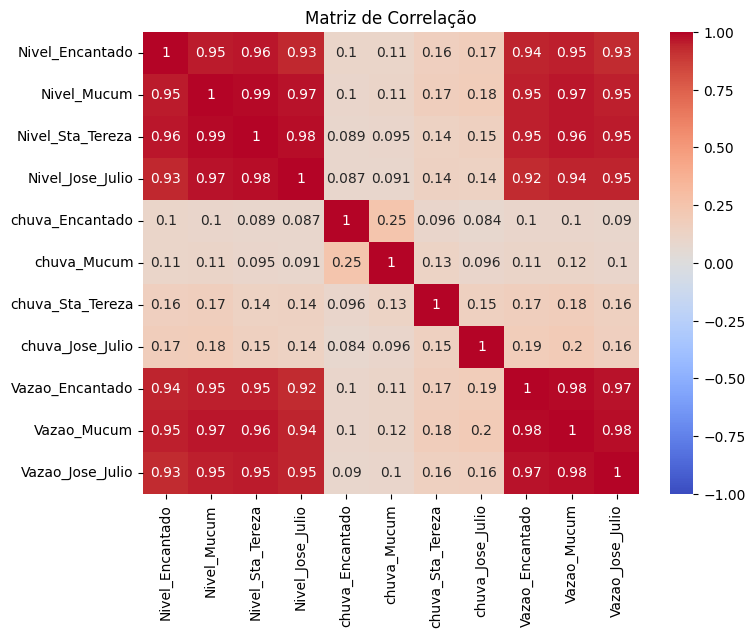

In [249]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

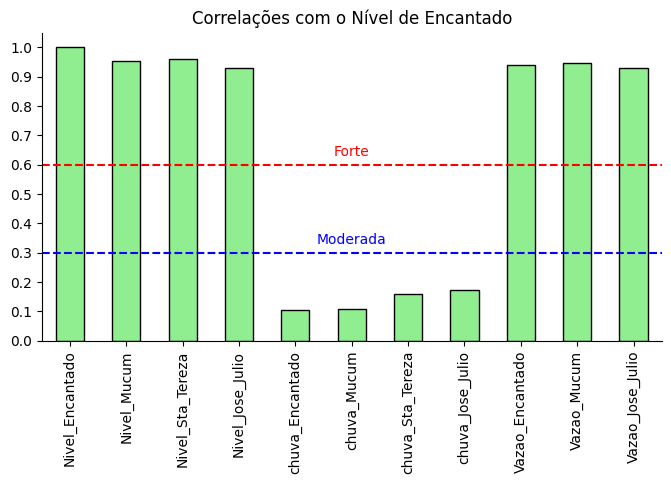

In [250]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

# Média, Mediana e Desvio Padrão

In [251]:
# Calcula a média, mediana e desvio padrão
estatisticas_descritivas = df_geral.agg(['mean', 'median', 'std'])


# Combina as estatísticas em um único DataFrame
tabela_estatisticas = pd.DataFrame({'Média': estatisticas_descritivas.loc['mean'],
                                 'Mediana': estatisticas_descritivas.loc['median'],
                                 'Desvio Padrão': estatisticas_descritivas.loc['std']})
tabela_estatisticas

,Média,Mediana,Desvio Padrão
Nivel_Encantado,346.045716,278.0,258.996424
Nivel_Mucum,392.151594,306.0,280.359998
Nivel_Sta_Tereza,394.617997,318.0,247.988703
Nivel_Jose_Julio,411.489828,323.0,285.290003
chuva_Encantado,0.066276,0.0,0.530274
chuva_Mucum,0.075348,0.0,0.599858
chuva_Sta_Tereza,0.042952,0.0,0.429895
chuva_Jose_Julio,0.061744,0.0,0.463298
Vazao_Encantado,655.490605,233.2,1394.996578
Vazao_Mucum,619.871305,232.1,1270.994828


# Histograma

Montamos histogramas das variáveis analisadas para entender a distribuição dos dados.

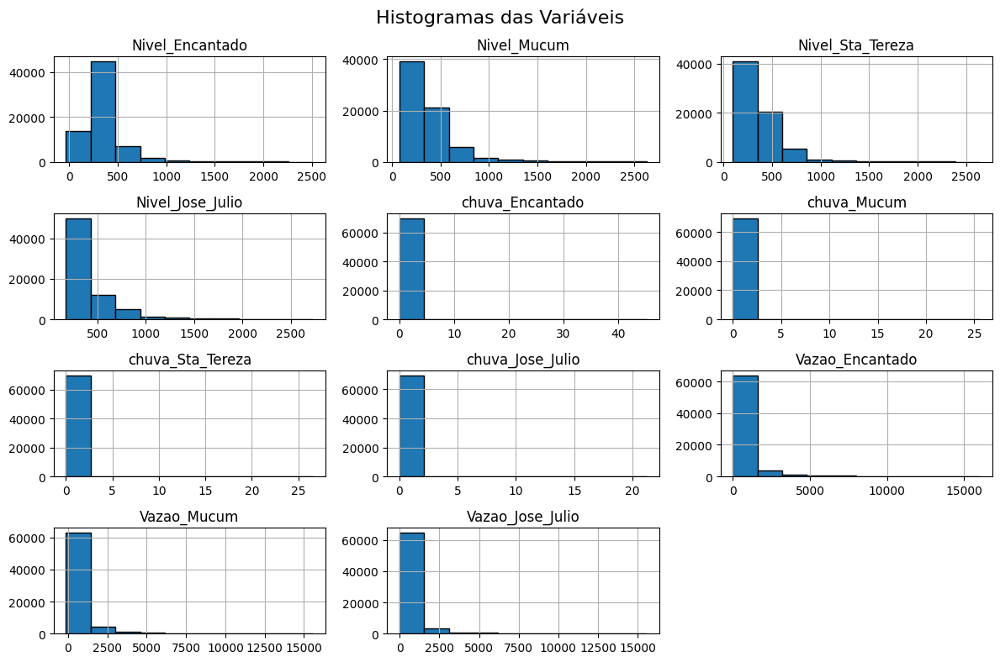

In [252]:
df_geral.hist(figsize=(12, 8), bins=10, edgecolor='black')
plt.suptitle('Histogramas das Variáveis', fontsize=16)
plt.tight_layout()
plt.show()

# Nivel Chuva e Vazao

### teste

In [253]:
import matplotlib.pyplot as plt

def plotar_chuva_nivel_vazao(dataset, titulo, labelx, labely1, labely2, labely3, coluna_data, coluna_chuva, coluna_nivel, coluna_vazao, intervalo_data=None, frequencia=None, largura_barras=0.3):
    fig, ax1 = plt.subplots(figsize=(15, 8))

    # Filtrar o intervalo de datas, se fornecido
    if intervalo_data is not None:
        data_inicio, data_fim = intervalo_data
        dataset = dataset[(dataset[coluna_data] >= data_inicio) & (dataset[coluna_data] <= data_fim)]

    # Agrupar os dados de chuva pela frequência especificada (D - dia, W - semana, M - mês, H - hora)
    # Se a frequência for 'None', não faz reamostragem (preserva o intervalo original)
    if frequencia is not None:
        dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()
    else:
        dados_chuva_agrupados = dataset[[coluna_data, coluna_chuva]]  # Mantém os dados originais



    # Eixo primário (eixo y à esquerda) para o nível da água (linha)
    ax1.plot(dataset[coluna_data], dataset[coluna_nivel], color='b', label='Nível da Água', linestyle='-')
    ax1.set_xlabel(labelx, fontsize=15)
    ax1.set_ylabel(labely1, color='b', fontsize=15)
    ax1.tick_params(axis='y', labelcolor='b')

    # Eixo secundário (eixo y à direita) para a chuva (barras)
    ax2 = ax1.twinx()
    ax2.bar(dados_chuva_agrupados[coluna_data], dados_chuva_agrupados[coluna_chuva], color='g', alpha=0.6, width=largura_barras, label='Chuva')
    ax2.set_ylabel(labely2, color='g', fontsize=15)
    ax2.tick_params(axis='y', labelcolor='g')

    # Eixo primário (eixo y à esquerda) para o Vazao da Agua (linha)
    ax3 = ax1.twinx()
    ax3.plot(dataset[coluna_data], dataset[coluna_vazao]/10, color='red', label='Vazao da Agua', linestyle='-')
    ax3.set_xlabel(labelx, fontsize=15)
    ax3.set_ylabel(labely1, color='red', fontsize=15)
    ax3.tick_params(axis='y', labelcolor='red')

    # Título e legendas
    fig.suptitle(titulo, fontsize=25)  # Removi o parâmetro `pad`
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")
    ax3.legend(loc="upper right")

    plt.show()



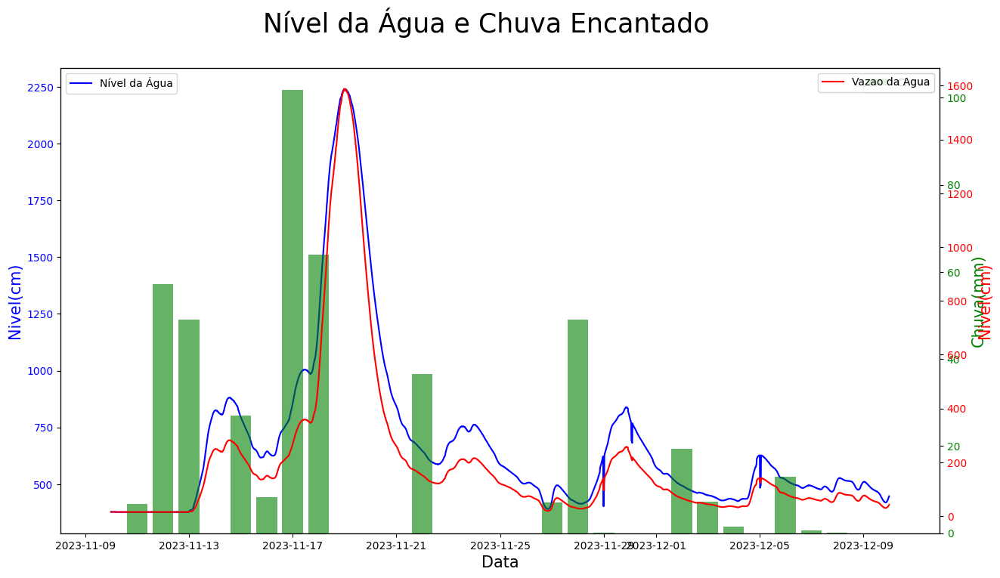

In [254]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='D' , largura_barras=0.8)

In [255]:
def ajustar_coluna_por_horas(df, coluna_data, horas):

    # Como o intervalo é de 15 minutos, para deslocar por 1 hora, precisamos deslocar 4 unidades
    deslocamento = horas * 4  # 1 hora = 4 intervalos de 15 minutos

    # Gerar o nome da nova coluna com o sufixo '_deslocada'
    nome_coluna_deslocada = f'{coluna_data}_deslocada'

    # Deslocar a coluna de chuva
    df[nome_coluna_deslocada] = df[coluna_data].shift(deslocamento)

    return df


In [256]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva(mm)', 32)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  
69957                  0.0  
69958                  0.0  
69959                  0.0  
69960                  0.0  
69961                  0.0  


<ipython-input-253-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


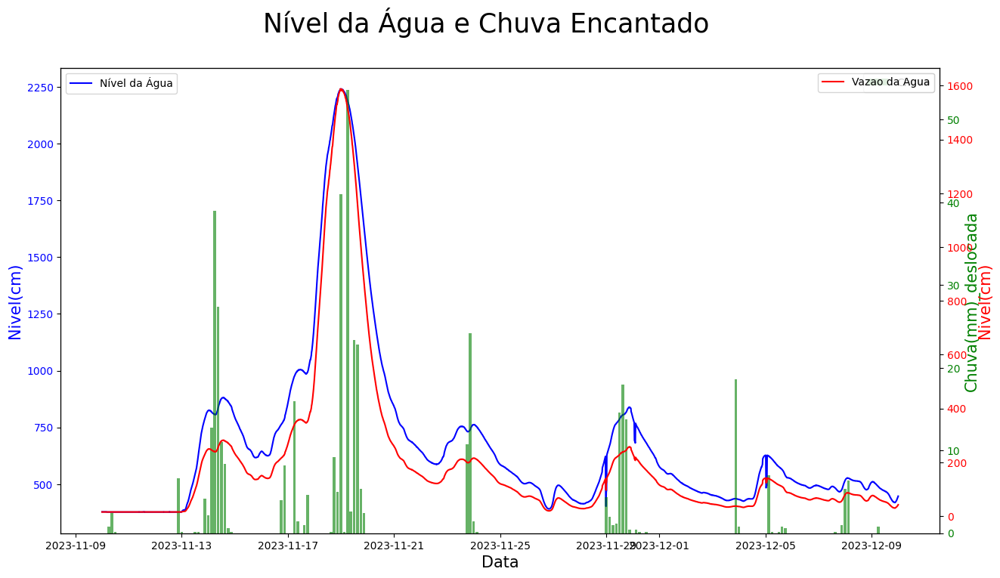

In [257]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [258]:
def normalizar_e_suavizar(dataset, coluna_chuva, janela_suavizacao=3):
    # Normalização da coluna de Chuva(mm)
    chuva_normalizada = (dataset[coluna_chuva] - dataset[coluna_chuva].min()) / (dataset[coluna_chuva].max() - dataset[coluna_chuva].min())

    # Suavização usando média móvel
    chuva_suavizada = dataset[coluna_chuva].rolling(window=janela_suavizacao, min_periods=1).mean()

    # Adicionando as colunas normalizada e suavizada ao dataset original
    dataset['Chuva_Normalizada'] = chuva_normalizada
    dataset['Chuva_Suavizada'] = chuva_suavizada

    return dataset

# Exemplo de uso da função com a base de dados já carregada em df_Encantado_unico
df_Encantado_unico = normalizar_e_suavizar(df_Encantado_unico, 'Chuva(mm)', janela_suavizacao=3)

# Exibir as primeiras linhas para verificar se as colunas foram adicionadas corretamente
print(df_Encantado_unico.head())

            Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  Chuva(mm)_deslocada  \
0 2022-10-22 23:15:00        0.0      293.0        197.6                  NaN   
1 2022-10-22 23:30:00        0.0      295.0        204.6                  NaN   
2 2022-10-22 23:45:00        0.0      298.0        215.1                  NaN   
3 2022-10-23 00:00:00        0.0      300.0        222.2                  NaN   
4 2022-10-23 00:15:00        0.0      302.0        229.5                  NaN   

   Chuva_Normalizada  Chuva_Suavizada  
0                0.0              0.0  
1                0.0              0.0  
2                0.0              0.0  
3                0.0              0.0  
4                0.0              0.0  


<ipython-input-253-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


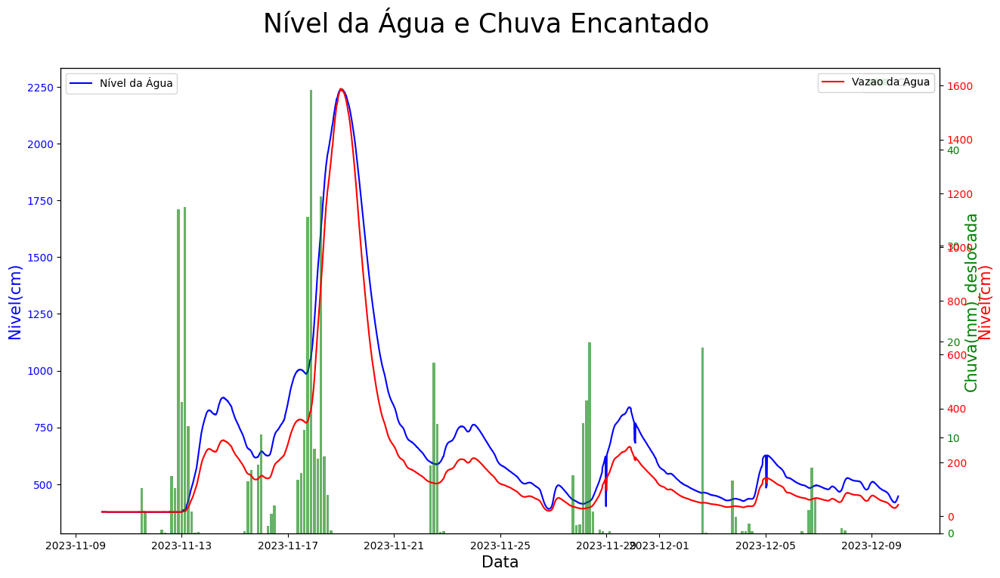

In [259]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva_Suavizada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [260]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva_Suavizada', 32)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69957                  0.0                0.0              0.0   
69958                  0.0                0.0              0.0   
69959                  0.0                0.0              0.0   
69960                  0.0                0.0              0.0   
69961                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  
69957                        0.0  
69958                        0.0  
69959                        0.0  
69960                        0.0  
69961                        0.0  


In [261]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva_Normalizada', 25)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69957                  0.0                0.0              0.0   
69958                  0.0                0.0              0.0   
69959                  0.0                0.0              0.0   
69960                  0.0                0.0              0.0   
69961                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  Chuva_Normalizada_deslocada  
69957                        0.0                          0.0  
69958                        0.0                          0.0  
69959                     

<ipython-input-253-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


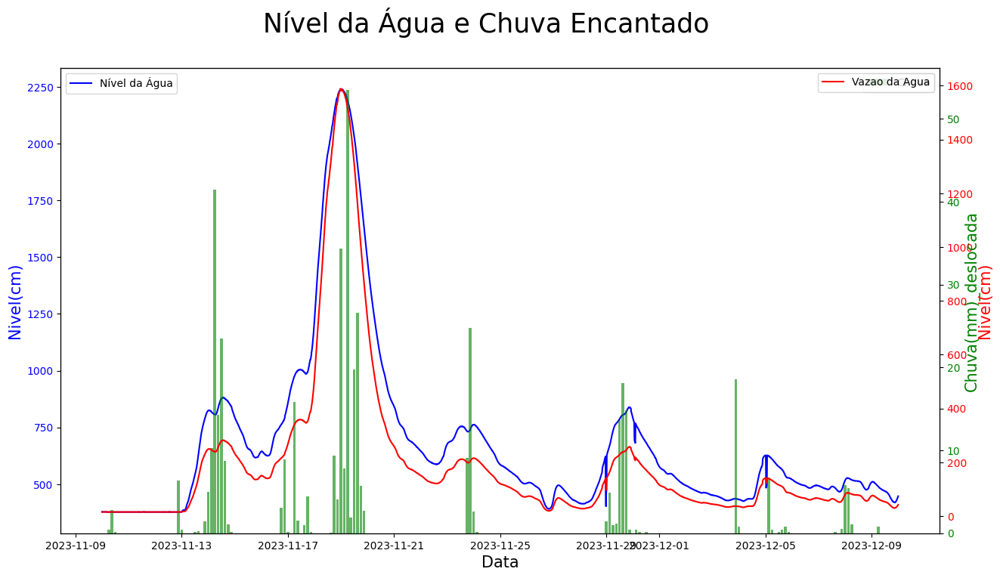

In [262]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva_Suavizada_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [263]:
# Lista com todos os DataFrames
databases = [df_Encantado_unico, df_Jose_Julio_unico, df_Sta_Tereza_unico, df_Mucum_unico]

# Soma total da coluna 'Chuva(mm)' de todos os DataFrames
total_chuva = sum(db['Chuva(mm)'].sum() for db in databases)

# Adiciona uma nova coluna no primeiro DataFrame com o total
df_Encantado_unico['Total Chuva(mm)'] = total_chuva

print(df_Encantado_unico)

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
0     2022-10-22 23:15:00        0.0      293.0       197.60   
1     2022-10-22 23:30:00        0.0      295.0       204.60   
2     2022-10-22 23:45:00        0.0      298.0       215.10   
3     2022-10-23 00:00:00        0.0      300.0       222.20   
4     2022-10-23 00:15:00        0.0      302.0       229.50   
...                   ...        ...        ...          ...   
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
0                      NaN                0.0              0.0   
1                      NaN                0.0              0.0   
2                      NaN       

In [264]:
# Lista de DataFrames
databases = [df_Encantado_unico, df_Jose_Julio_unico, df_Sta_Tereza_unico, df_Mucum_unico]

# Combina os DataFrames pela coluna 'Data/Hora'
combined = pd.concat(databases, ignore_index=True)

# Soma de 'Chuva(mm)' para cada 'Data/Hora'
chuva_por_data = combined.groupby('Data/Hora')['Chuva(mm)'].sum().reset_index()

# Adiciona a soma como nova coluna ao primeiro DataFrame (db1)
df_Encantado_unico = df_Encantado_unico.merge(chuva_por_data, on='Data/Hora', suffixes=('', '_Total'))

print(df_Encantado_unico)

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
0     2022-10-22 23:15:00        0.0      293.0       197.60   
1     2022-10-22 23:30:00        0.0      295.0       204.60   
2     2022-10-22 23:45:00        0.0      298.0       215.10   
3     2022-10-23 00:00:00        0.0      300.0       222.20   
4     2022-10-23 00:15:00        0.0      302.0       229.50   
...                   ...        ...        ...          ...   
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
0                      NaN                0.0              0.0   
1                      NaN                0.0              0.0   
2                      NaN       

<ipython-input-253-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


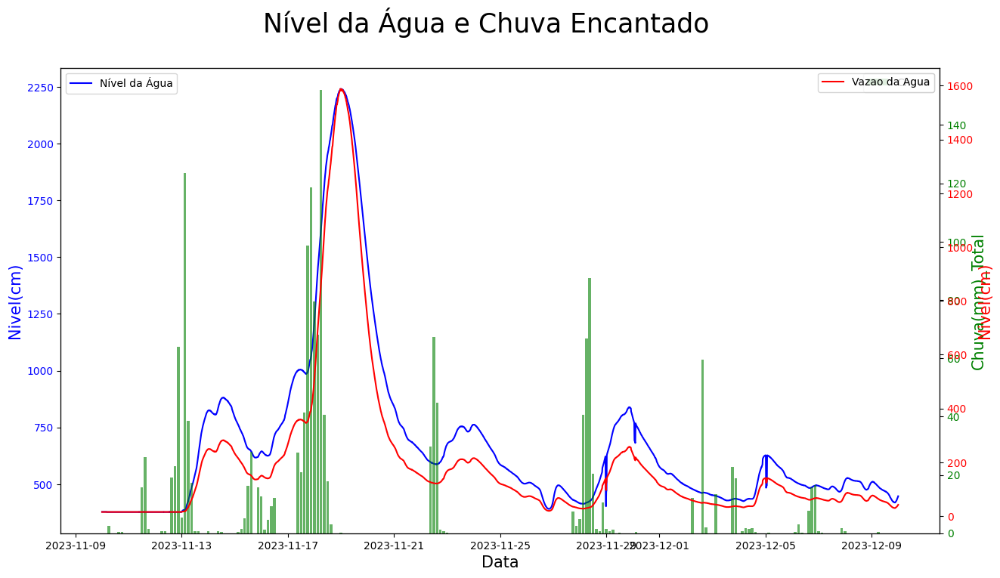

In [265]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_Total",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_Total',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

In [266]:
# Exemplo de uso da função com a base de dados já carregada na variável df_Encantado
df_Encantado_unico = ajustar_coluna_por_horas(df_Encantado_unico, 'Chuva(mm)_Total', 25)  # Desloca para frente 2 horas

# Exibir os primeiros registros para verificar
print(df_Encantado_unico.tail())

                Data/Hora  Chuva(mm)  Nivel(cm)  Vazao(m3/s)  \
69957 2024-10-23 15:30:00        0.0       97.0       352.04   
69958 2024-10-23 15:45:00        0.0       97.0       352.04   
69959 2024-10-23 16:00:00        0.0       97.0       352.04   
69960 2024-10-23 16:15:00        0.0       97.0       352.04   
69961 2024-10-23 16:30:00        0.0       98.0       354.34   

       Chuva(mm)_deslocada  Chuva_Normalizada  Chuva_Suavizada  \
69957                  0.0                0.0              0.0   
69958                  0.0                0.0              0.0   
69959                  0.0                0.0              0.0   
69960                  0.0                0.0              0.0   
69961                  0.0                0.0              0.0   

       Chuva_Suavizada_deslocada  Chuva_Normalizada_deslocada  \
69957                        0.0                          0.0   
69958                        0.0                          0.0   
69959                  

<ipython-input-253-84a2fe8e99ef>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dados_chuva_agrupados = dataset.resample(frequencia, on=coluna_data).agg({coluna_chuva: 'sum'}).reset_index()


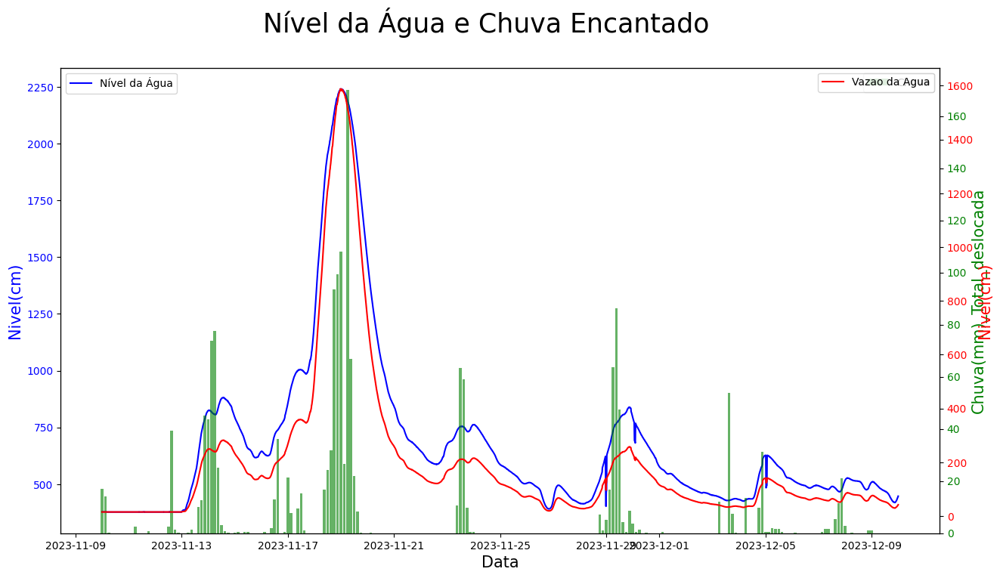

In [267]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

plotar_chuva_nivel_vazao(df_Encantado_unico,
                   "Nível da Água e Chuva Encantado",
                   "Data",
                   "Nivel(cm)",
                   "Chuva(mm)_Total_deslocada",
                   "Vazao(m3/s)",
                   coluna_data='Data/Hora',
                   coluna_chuva='Chuva(mm)_Total_deslocada',
                   coluna_nivel='Nivel(cm)',
                   coluna_vazao='Vazao(m3/s)',
                   intervalo_data=(data_inicio, data_fim),
                   frequencia='3H', largura_barras=0.1)

# Calcular correlação

Criamos um dataframe que junta as variáveis de todas as estações, não levando em consideração a coluna Data/Hora

Também calculamos a correlação de cada subgrupo de variáveis e a correlação geral de todas as variáveis do data frame

In [268]:
niveis = [df_Encantado_unico['Nivel(cm)'],df_Mucum_unico['Nivel(cm)'],df_Sta_Tereza_unico['Nivel(cm)'],df_Jose_Julio_unico['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_unico['Chuva(mm)_Total_deslocada']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['Chuva_Total_deslocada']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_unico['Vazao(m3/s)'],df_Mucum_unico['Vazao(m3/s)'],df_Jose_Julio_unico['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,Chuva_Total_deslocada,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.954722,0.962181,0.929796,0.361638,0.939209,0.946338,0.928938
Nivel_Mucum,0.954722,1.000000,0.990515,0.974531,0.370342,0.950272,0.968328,0.946517
Nivel_Sta_Tereza,0.962181,0.990515,1.000000,0.981684,0.351262,0.948809,0.964114,0.953648
Nivel_Jose_Julio,0.929796,0.974531,0.981684,1.000000,0.334194,0.923162,0.938446,0.945292
Chuva_Total_deslocada,0.361638,0.370342,0.351262,0.334194,1.000000,0.397208,0.403313,0.390051
Vazao_Encantado,0.939209,0.950272,0.948809,0.923162,0.397208,1.000000,0.984655,0.973399
Vazao_Mucum,0.946338,0.968328,0.964114,0.938446,0.403313,0.984655,1.000000,0.980540
Vazao_Jose_Julio,0.928938,0.946517,0.953648,0.945292,0.390051,0.973399,0.980540,1.000000


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

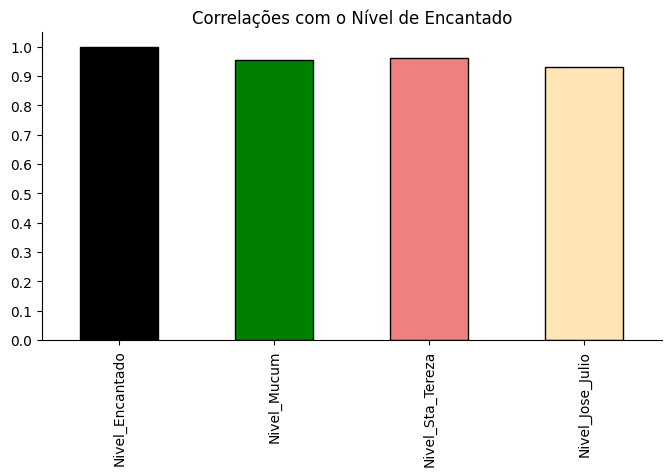

In [269]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

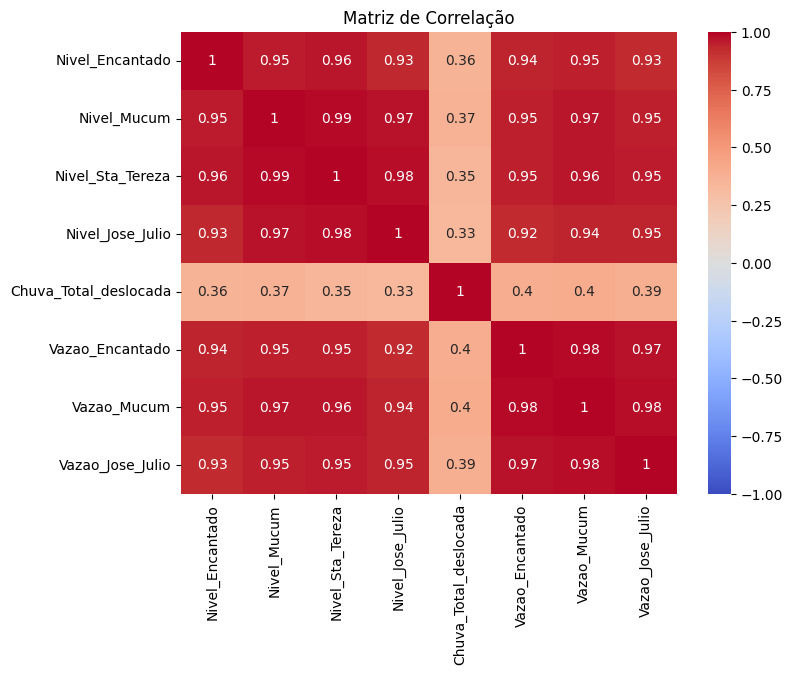

In [270]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

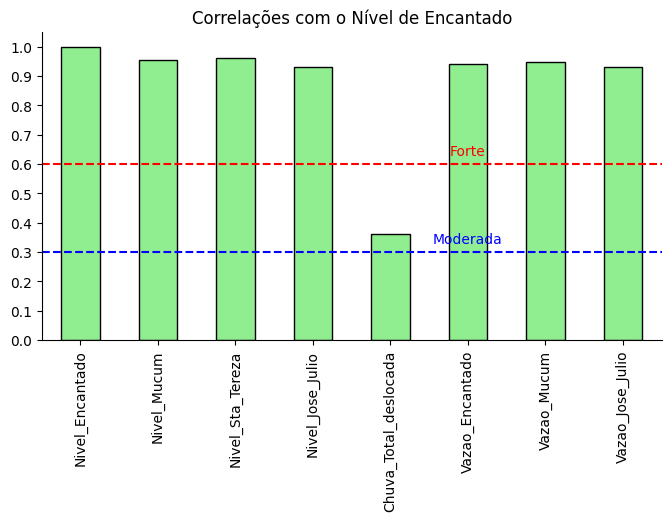

In [271]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

# Recorte de 1 mes selecionado

In [272]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Encantado_mes = df_Encantado_unico[(df_Encantado_unico['Data/Hora'] >= data_inicio) & (df_Encantado_unico['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [273]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Mucum_mes = df_Mucum_unico[(df_Mucum_unico['Data/Hora'] >= data_inicio) &
                                  (df_Mucum_unico['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [274]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Sta_Tereza_mes = df_Sta_Tereza_unico[(df_Sta_Tereza_unico['Data/Hora'] >= data_inicio) &
                                  (df_Sta_Tereza_unico['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

In [275]:
# Define o intervalo de datas
data_inicio = pd.Timestamp('2023-11-10')
data_fim = pd.Timestamp('2023-12-10')

# Filtra os dados entre as datas
df_Jose_Julio_mes = df_Jose_Julio_unico[(df_Jose_Julio_unico['Data/Hora'] >= data_inicio) &
                                  (df_Jose_Julio_unico['Data/Hora'] <= data_fim)]

#print("Base de dados original:")
#print(df_Encantado_unico)

#print("\nBase de dados filtrada:")
#print(df_Encantado_mes)

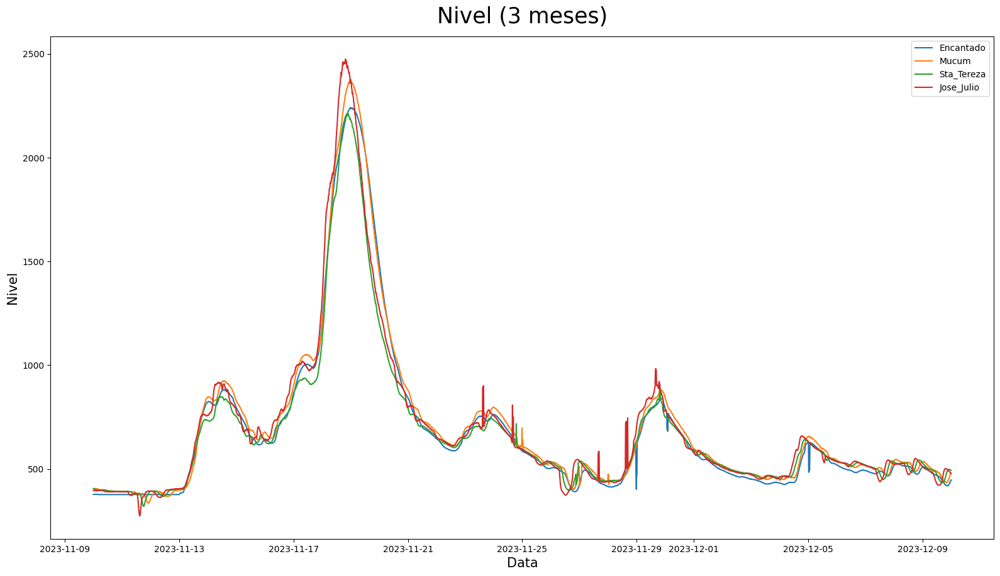

In [276]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-10-01')
data_fim = pd.to_datetime('2024-1-31')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_mes, df_Mucum_mes, df_Sta_Tereza_mes, df_Jose_Julio_mes,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

In [277]:
df_Encantado23.head()

,Data/Hora,Chuva(mm),Nivel(cm),Vazao(m3/s)
0,2023-10-24 15:00:00,0.0,215.0,204.6
1,2023-10-24 14:45:00,0.0,216.0,208.0
2,2023-10-24 14:30:00,0.0,216.0,208.0
3,2023-10-24 14:15:00,0.0,216.0,208.0
4,2023-10-24 14:00:00,0.0,217.0,211.6


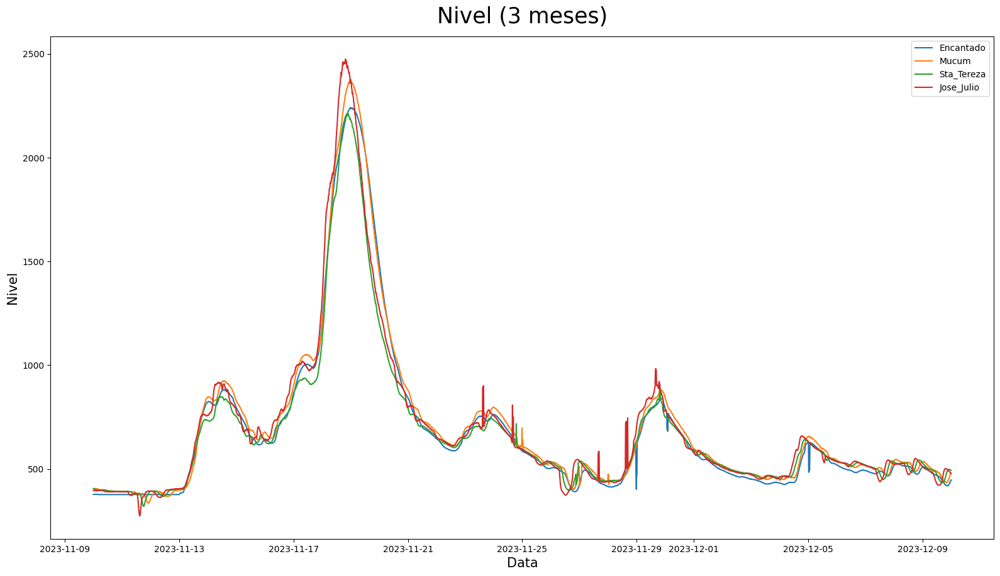

In [278]:
# Definir intervalo de data
data_inicio = pd.to_datetime('2023-11-10')
data_fim = pd.to_datetime('2023-12-10')

# Chamando a função com intervalo de data
plotar_matplot4('Nivel (3 meses)', 'Data', 'Nivel', 'Data/Hora', 'Nivel(cm)',
                df_Encantado_unico, df_Mucum_unico, df_Sta_Tereza_unico, df_Jose_Julio_unico,
                'Encantado', 'Mucum', 'Sta_Tereza', 'Jose_Julio',
                intervalo_data=(data_inicio, data_fim))

# Calcular correlação

Criamos um dataframe que junta as variáveis de todas as estações, não levando em consideração a coluna Data/Hora

Também calculamos a correlação de cada subgrupo de variáveis e a correlação geral de todas as variáveis do data frame

In [279]:
niveis = [df_Encantado_mes['Nivel(cm)'],df_Mucum_mes['Nivel(cm)'],df_Sta_Tereza_mes['Nivel(cm)'],df_Jose_Julio_mes['Nivel(cm)']]
niveis = pd.concat(niveis, axis=1)
niveis.columns = ['Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio']


correlacao_niveis = niveis.corr()


chuvas = [df_Encantado_mes['Chuva(mm)_Total_deslocada']]
chuvas = pd.concat(chuvas, axis=1)
chuvas.columns = ['Chuva_Total_deslocada']

correlacao_chuvas= chuvas.corr()

vazoes = [df_Encantado_mes['Vazao(m3/s)'],df_Mucum_mes['Vazao(m3/s)'],df_Jose_Julio_mes['Vazao(m3/s)']]
vazoes = pd.concat(vazoes, axis=1)
vazoes.columns = ['Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio']

correlacao_vazoes = vazoes.corr()

correlacoes = [correlacao_niveis, correlacao_chuvas, correlacao_vazoes]
correlacoes = pd.concat(correlacoes, axis=1)

df_geral = [niveis, chuvas, vazoes]
df_geral = pd.concat(df_geral, axis=1)
df_geral

correlacao_geral = df_geral.corr()
correlacao_geral

,Nivel_Encantado,Nivel_Mucum,Nivel_Sta_Tereza,Nivel_Jose_Julio,Chuva_Total_deslocada,Vazao_Encantado,Vazao_Mucum,Vazao_Jose_Julio
Nivel_Encantado,1.000000,0.998398,0.988716,0.978179,0.418477,0.987385,0.992202,0.955976
Nivel_Mucum,0.998398,1.000000,0.990793,0.979251,0.428136,0.988037,0.994325,0.957126
Nivel_Sta_Tereza,0.988716,0.990793,1.000000,0.995922,0.434154,0.984762,0.988343,0.980132
Nivel_Jose_Julio,0.978179,0.979251,0.995922,1.000000,0.421774,0.972838,0.975528,0.982878
Chuva_Total_deslocada,0.418477,0.428136,0.434154,0.421774,1.000000,0.448179,0.444402,0.456176
Vazao_Encantado,0.987385,0.988037,0.984762,0.972838,0.448179,1.000000,0.998312,0.977394
Vazao_Mucum,0.992202,0.994325,0.988343,0.975528,0.444402,0.998312,1.000000,0.971580
Vazao_Jose_Julio,0.955976,0.957126,0.980132,0.982878,0.456176,0.977394,0.971580,1.000000


Criamos um gráfico que compara a correlação das vaiáveis Nível em relação ao Nível de Encantado.

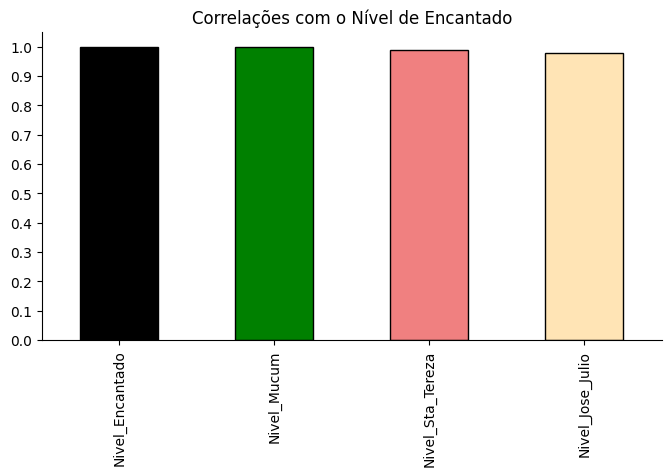

In [280]:
from matplotlib import pyplot as plt
correlacao_niveis['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = ['black','g','lightcoral','moccasin'], edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.show()

Criamos o heatmap, o gráfico da Matriz das Correlações, a fim de mais fácilmente visualizar a correlação entre variávies.

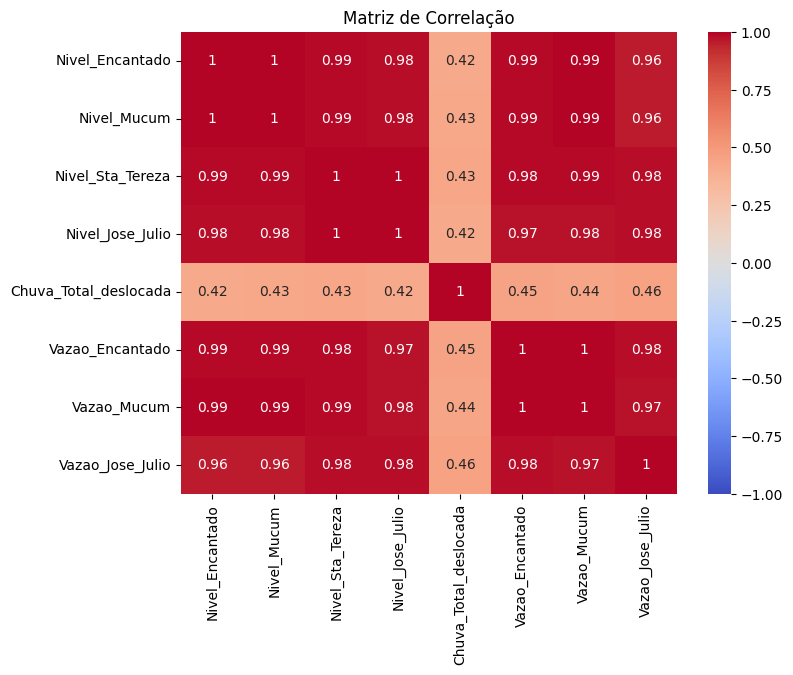

In [281]:
plt.figure(figsize=(8, 6))
sns.heatmap(correlacao_geral, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matriz de Correlação')
plt.show()

Mudamos a visualização dos dados para dar mais destaque da relação das variáveis com o Nível de Encantado, a cidade que buscamos prever o nível no projeto final. Escolhemos um formato de gráfico de barras para facilitar a visualização da correlação, com linhas que indicam a força da correlação.

<ipython-input-282-94c7f8a46ebb>:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_geral[colunas_log_mais_um] = df_geral[colunas_log_mais_um].applymap(lambda x: np.log1p(x))
<ipython-input-282-94c7f8a46ebb>:15: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_geral[colunas_log] = df_geral[colunas_log].applymap(lambda x: np.log(x))


<Axes: >

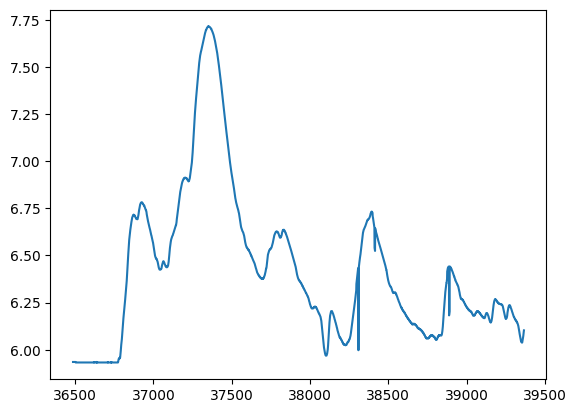

In [282]:
# Listar as colunas que precisam de log(x+1) por conter zeros
colunas_log_mais_um = ['Chuva_Total_deslocada']

# Listar as colunas que precisam de log(x)
colunas_log = [
    'Nivel_Encantado', 'Nivel_Mucum', 'Nivel_Sta_Tereza', 'Nivel_Jose_Julio',
    'Vazao_Encantado', 'Vazao_Mucum', 'Vazao_Jose_Julio'
]

# Aplicar log(x+1) nas colunas especificadas
df_geral[colunas_log_mais_um] = df_geral[colunas_log_mais_um].applymap(lambda x: np.log1p(x))

# A
# Aplicar log(x) nas colunas especificadas
df_geral[colunas_log] = df_geral[colunas_log].applymap(lambda x: np.log(x))

# Visualizar o DataFrame atualizado
df_geral['Nivel_Encantado'].plot()

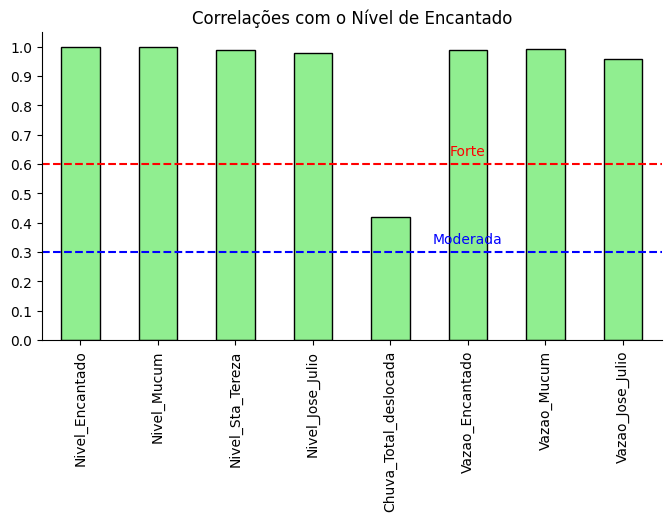

In [283]:
correlacao_geral['Nivel_Encantado'].plot(kind='bar', figsize=(8, 4), color = 'lightgreen', edgecolor='black', title='Correlações com o Nível de Encantado')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.yticks(np.arange(0, 1.1, 0.1))
# Adicionar linha horizontal
plt.axhline(y=0.6, color='r', linestyle='--')
plt.axhline(y=0.3, color='b', linestyle='--')
# Adicionar texto acima da linha
plt.text(5, 0.62, 'Forte', color='r', ha='center', va='bottom')
plt.text(5, 0.32, 'Moderada', color='b', ha='center', va='bottom')
plt.show()

In [284]:
# Selecionando as colunas específicas de cada DataFrame
df1_selecionado = df_Encantado_mes[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Encantado'})
df2_selecionado = df_Jose_Julio_mes[['Data/Hora', 'Nivel(cm)']].rename(columns={'Nivel(cm)': 'nivel_Jose_Julio'})
df3_selecionado = df_Jose_Julio_mes[['Data/Hora', 'Vazao(m3/s)']].rename(columns={'Vazao(m3/s)': 'vazao_Jose_Julio'})
df4_selecionado = df_Encantado_mes[['Data/Hora', 'Chuva(mm)_Total']].rename(columns={'Chuva(mm)_Total': 'chuva_total'})

# Realizando os merges em etapas
df_final = pd.merge(df1_selecionado, df2_selecionado, on='Data/Hora', how='outer')
df_final = pd.merge(df_final, df3_selecionado, on='Data/Hora', how='outer')
df_final = pd.merge(df_final, df4_selecionado, on='Data/Hora', how='outer')

# Visualizando o resultado
print(df_final)

               Data/Hora  nivel_Encantado  nivel_Jose_Julio  vazao_Jose_Julio  \
0    2023-11-10 00:00:00            378.0             397.0             403.7   
1    2023-11-10 00:15:00            378.0             397.0             403.7   
2    2023-11-10 00:30:00            378.0             396.0             401.3   
3    2023-11-10 00:45:00            378.0             396.0             401.3   
4    2023-11-10 01:00:00            378.0             396.0             401.3   
...                  ...              ...               ...               ...   
2876 2023-12-09 23:00:00            434.0             485.0             634.5   
2877 2023-12-09 23:15:00            438.0             483.0             628.8   
2878 2023-12-09 23:30:00            440.0             481.0             623.1   
2879 2023-12-09 23:45:00            444.0             480.0             620.3   
2880 2023-12-10 00:00:00            447.0             478.0             614.7   

      chuva_total  
0      

# Histograma

Montamos histogramas das variáveis analisadas para entender a distribuição dos dados.

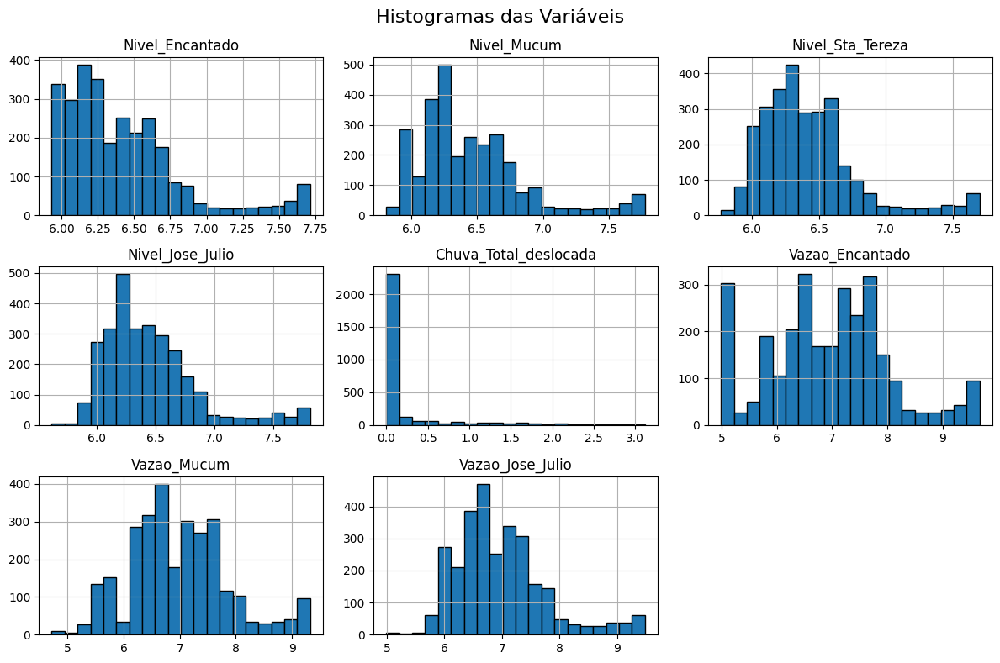

In [285]:
df_geral.hist(figsize=(12, 8), bins=20, edgecolor='black')
plt.suptitle('Histogramas das Variáveis', fontsize=16)
plt.tight_layout()
plt.show()

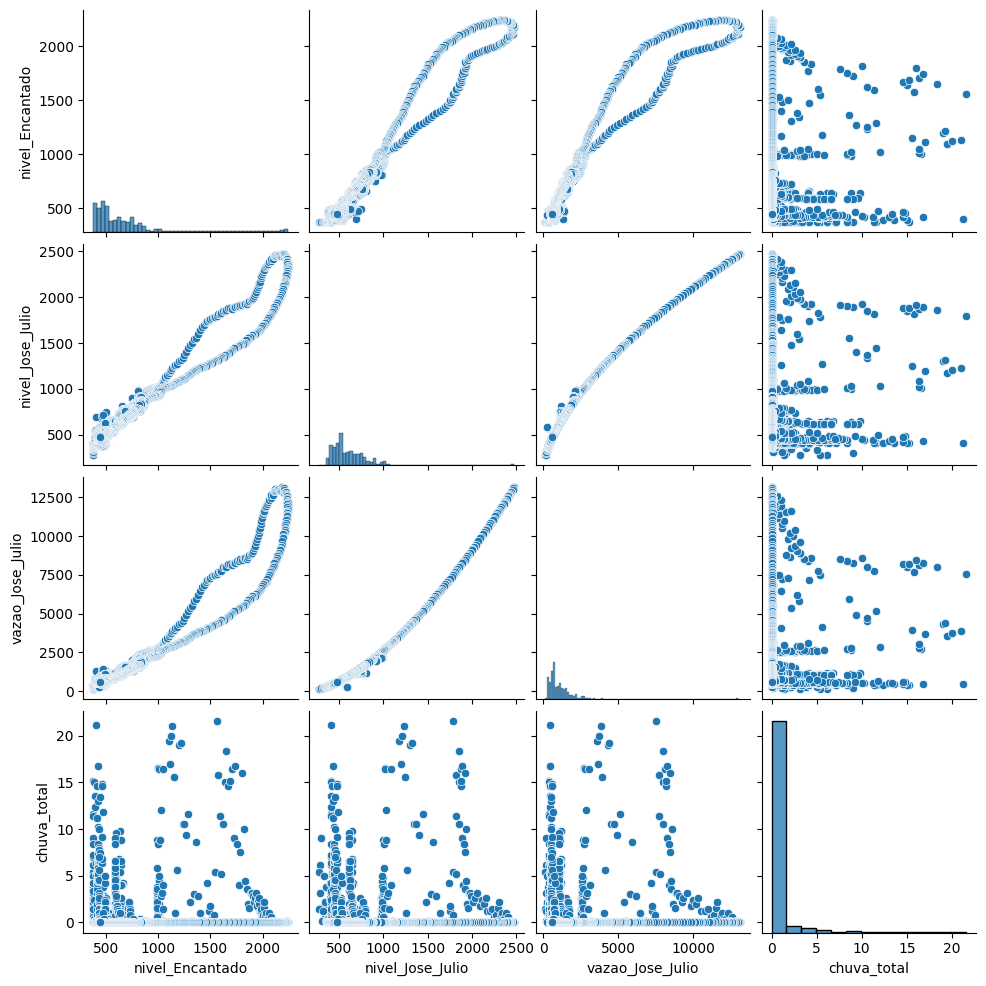

In [286]:
ax = sns.pairplot(df_final)

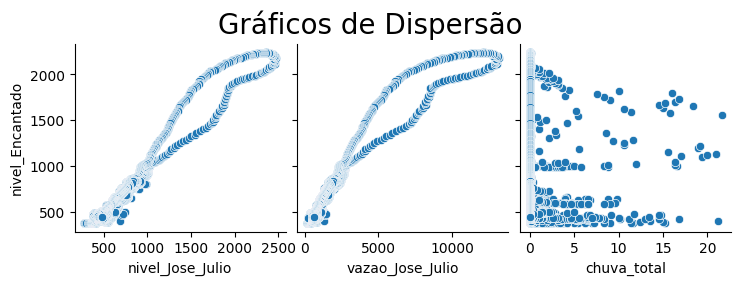

In [287]:
ax = sns.pairplot(df_final, y_vars='nivel_Encantado', x_vars=['nivel_Jose_Julio', 'vazao_Jose_Julio' ,'chuva_total'])
ax.fig.suptitle('Gráficos de Dispersão', fontsize=20, y= 1.10)
ax

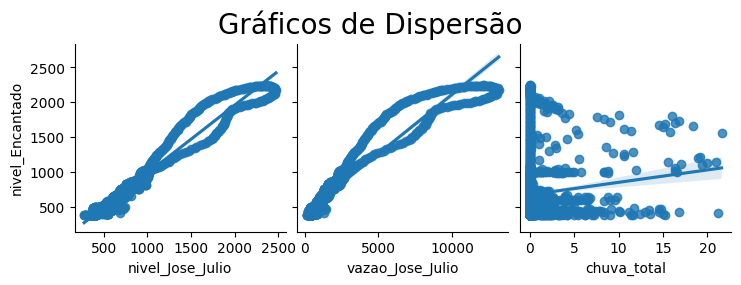

In [288]:
ax = sns.pairplot(df_final, y_vars='nivel_Encantado', x_vars=['nivel_Jose_Julio', 'vazao_Jose_Julio' ,'chuva_total'], kind='reg')
ax.fig.suptitle('Gráficos de Dispersão', fontsize=20, y= 1.10)
ax

In [289]:
from sklearn.model_selection import train_test_split

In [290]:
y = df_final['nivel_Encantado']

In [291]:
X = df_final[['nivel_Jose_Julio', 'vazao_Jose_Julio' ,'chuva_total']]

In [292]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=2811)

In [293]:
X_train.shape

(2016, 3)

In [294]:
X_test.shape

(865, 3)

In [295]:
X_train.shape[0] + X_test.shape[0]

2881

In [296]:
X.shape[0] *0.3

864.3

In [297]:
X.shape[0] *0.7

2016.6999999999998

In [298]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

In [299]:
modelo = LinearRegression()

In [300]:
modelo.fit(X_train, y_train)

LinearRegression()

In [301]:
print(f'R² = {modelo.score(X_train, y_train):.2f}')

R² = 0.97


In [302]:
y_previsto = modelo.predict(X_test)

In [303]:
print('R² = %.2f' % metrics.r2_score(y_test, y_previsto))

R² = 0.96


In [304]:
modelo.intercept_

-88.61508540302134

In [305]:
type(modelo.intercept_)

numpy.float64

In [306]:
modelo.coef_

array([ 1.20661185, -0.04262332, -4.46968168])

In [307]:
type(modelo.coef_)

numpy.ndarray

In [308]:
X.columns

Index(['nivel_Jose_Julio', 'vazao_Jose_Julio', 'chuva_total'], dtype='object')

In [309]:
index=['Intercept', 'nivel_Jose_Julio', 'vazao_Jose_Julio' ,'chuva_total']

In [310]:
pd.DataFrame(data=np.append(modelo.intercept_, modelo.coef_), index=index, columns=['Parametro'])

,Parametro
Intercept,-88.615085
nivel_Jose_Julio,1.206612
vazao_Jose_Julio,-0.042623
chuva_total,-4.469682


In [311]:
y_previsto_train = modelo.predict(X_train)

<Axes: title={'center': 'Previsões x Real'}, xlabel='Nivel em Encantado - Previsão', ylabel='Nivel em Encantado - Real'>

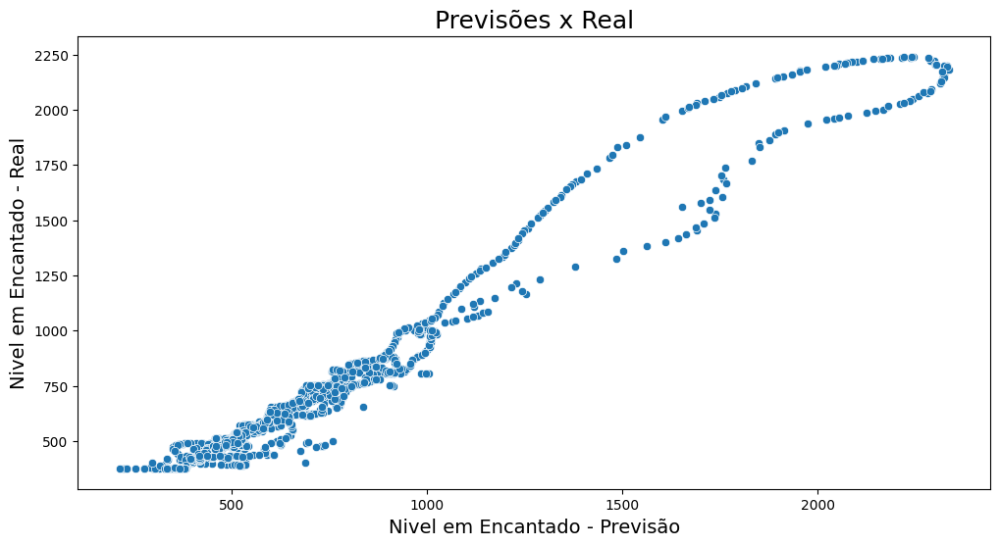

In [312]:
ax = sns.scatterplot(x=y_previsto_train, y=y_train)
ax.figure.set_size_inches(12, 6)
ax.set_title('Previsões x Real', fontsize=18)
ax.set_xlabel('Nivel em Encantado - Previsão', fontsize=14)
ax.set_ylabel('Nivel em Encantado - Real', fontsize=14)
ax

In [313]:
 residuo = y_train - y_previsto_train

<Axes: title={'center': 'Previsões x Real'}, xlabel='Nivel em Encantado - Previsão', ylabel='Nivel em Encantado - Real'>

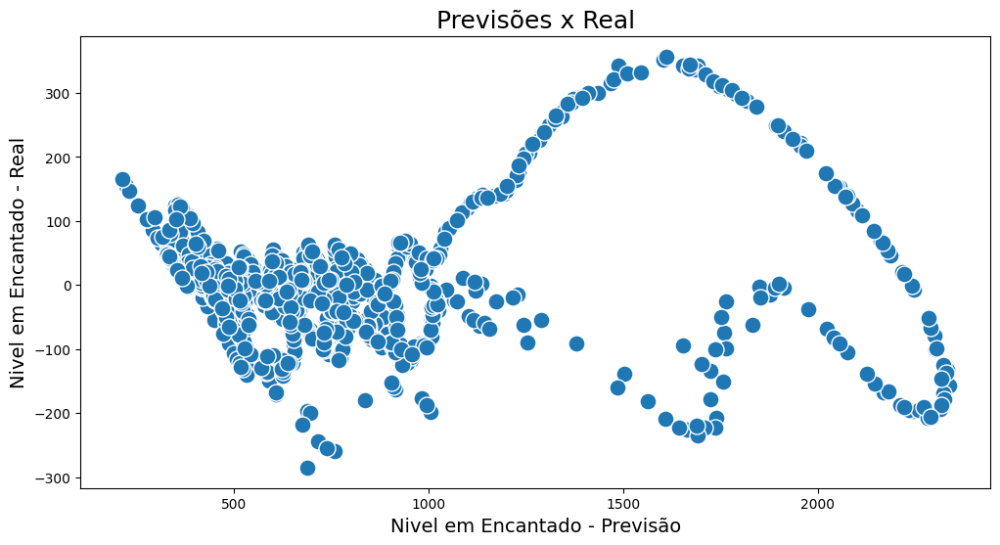

In [314]:
ax = sns.scatterplot(x=y_previsto_train, y=residuo, s=150)
ax.figure.set_size_inches(12, 6)
ax.set_title('Previsões x Real', fontsize=18)
ax.set_xlabel('Nivel em Encantado - Previsão', fontsize=14)
ax.set_ylabel('Nivel em Encantado - Real', fontsize=14)
ax

<Axes: title={'center': 'Previsões x Real'}, xlabel='Nivel em Encantado - Previsão', ylabel='Nivel em Encantado - Real'>

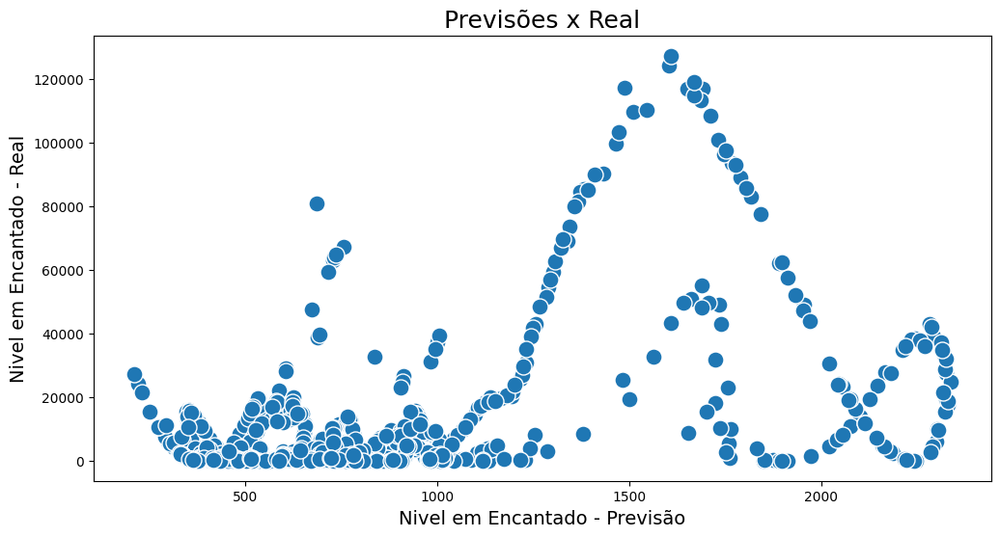

In [315]:
ax = sns.scatterplot(x=y_previsto_train, y=residuo**2, s=150)
ax.figure.set_size_inches(12, 6)
ax.set_title('Previsões x Real', fontsize=18)
ax.set_xlabel('Nivel em Encantado - Previsão', fontsize=14)
ax.set_ylabel('Nivel em Encantado - Real', fontsize=14)
ax

<ipython-input-316-30e007e0252c>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(residuo)


<Axes: title={'center': 'Distribuição de Frequencia dos Resíduos'}, xlabel='Litro', ylabel='Density'>

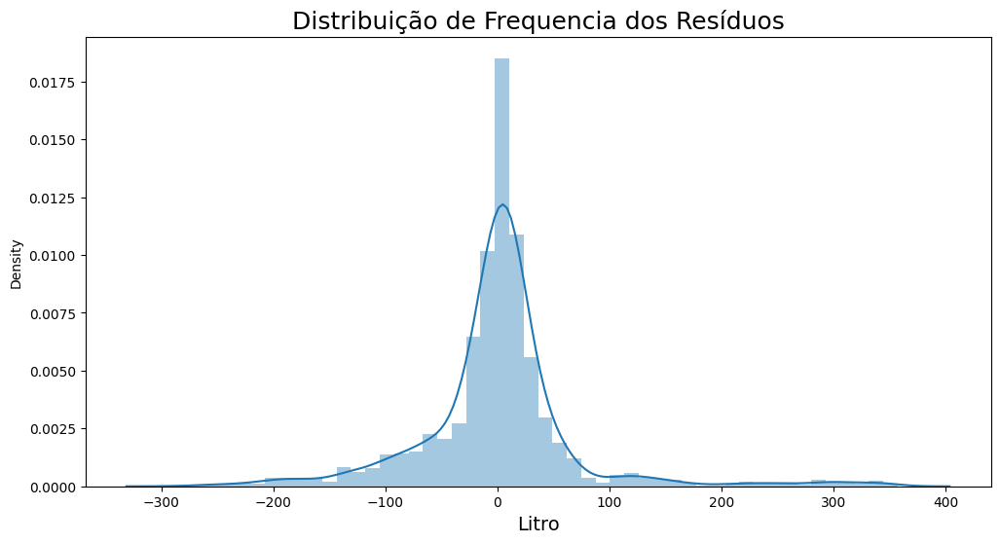

In [316]:
ax = sns.distplot(residuo)
ax.figure.set_size_inches(12, 6)
ax.set_title('Distribuição de Frequencia dos Resíduos', fontsize=18)
ax.set_xlabel('Litro', fontsize=14)
ax

In [318]:
EQM = round(metrics.mean_squared_error(y_test, y_previsto), 2)
REQM = round(np.sqrt(metrics.mean_squared_error(y_test, y_previsto)), 2)
R2 = round(metrics.r2_score(y_test, y_previsto), 2)

pd.DataFrame([EQM, REQM, R2], ['EQM', 'REQM', 'R²'], columns=['Métricas'])

,Métricas
EQM,5151.54
REQM,71.77
R²,0.96
